In [16]:
# System
import argparse
# Math
import numpy as np
import math
# Visualize
import progressbar
# Pytorch
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
# Custom
from loader import IlluminationModule, Eval_Dataset
from libs.projections import bin2Sphere
from utils import getAngle

import pandas as pd
import matplotlib.pyplot as plt

import warnings
import matplotlib.pyplot as plt
import matplotlib.image as img

warnings.filterwarnings(action='ignore')



In [17]:
def evaluate(module):
    # loss function
    sun_crit = nn.KLDivLoss()
    prr_crit = nn.MSELoss()

    # data loader
    eval_dataset = Eval_Dataset(csv_path='./test_labels.csv')
    eval_dataloader = DataLoader(eval_dataset, batch_size=1, shuffle=False, num_workers=4)

    module.eval()
    '''
    Totally five predictions: 
        1. sun position (angular error)
        2. tubidity ( abs difference)
        3. exposure ( abs difference)
        4. elevation (difference in degrees)
        5. FoV (difference in degrees)
    '''
    sum_err = np.asarray([0, 0, 0, 0, 0]).astype('float64')
    sum_loss = 0.0
    data_length = len(eval_dataloader)
    suns=[]
    suns_gt=[]
    bins=[]
    angular=[]
    with progressbar.ProgressBar(max_value=data_length) as bar:
        for i, sample in enumerate(eval_dataloader):
            input_img = sample['img'].cuda().float()
            label_dis, label_prrs = sample['dis'].cuda().float(), sample['prrs'].cuda().float()
            sunpos = sample['sp'][0].numpy()

            with torch.no_grad():
                #print("="*20,i,"="*20)
                pred_dis, pred_prrs = module(input_img)
                #print("pred_dis  shape : ", pred_dis.shape) # (1, 256)
                #print("pred_dis : ", pred_dis)
                #print("pred_prrs : ", pred_prrs)
                #print(input_img)
                sun_loss, prr_loss = sun_crit(pred_dis, label_dis), prr_crit(pred_prrs, label_prrs)
                beta = 64
                loss = sun_loss + beta * prr_loss
                sum_loss += loss.item()
                
                # calculate all prediction error
                bins.append(np.argmax(pred_dis.cpu().numpy()[0]))
                pred_sunpos = bin2Sphere(np.argmax(pred_dis.cpu().numpy()[0])) # predicted sun position is the bin with highest probability
                #print('pred_sunpos : ', pred_sunpos)
                suns.append(pred_sunpos)
                suns_gt.append(sunpos)
                sunpos_err = getAngle(sunpos, pred_sunpos)
                angular.append(sunpos_err)
                tur_err = abs(pred_prrs.cpu().numpy()[0][0] - label_prrs.cpu().numpy()[0][0])
                omg_err = abs(pred_prrs.cpu().numpy()[0][1] - label_prrs.cpu().numpy()[0][1])
                elv_err = abs(pred_prrs.cpu().numpy()[0][2] - label_prrs.cpu().numpy()[0][2])
                fov_err = math.degrees(abs(pred_prrs.cpu().numpy()[0][3] - label_prrs.cpu().numpy()[0][3]))
                sum_err += np.asarray([sunpos_err, tur_err, omg_err, elv_err, fov_err])
            bar.update(i)
    # print average prediction errors across all testing dataset
    print("="*20,"FINAL ERROR","="*20)
    print('Testing avg loss:', sum_loss/data_length)
    final_err = sum_err/data_length
    print('Average predictions error:')
    print('sun position (angular error):', final_err[0])
    print('tubidity:', final_err[1])
    print('exposure:', final_err[2])
    print('elevation (degrees):', final_err[3])
    print('FoV (degrees):', final_err[4])
    return suns_gt, suns, bins, angular

In [18]:
def main(args):
    print('loading weights ...')
    # device configuration
    torch.cuda.set_device(0)
    # get network module 
    module = IlluminationModule().cuda()
    #load pre-trained weight
    module.load_state_dict(torch.load(args.pre_trained))

    print('start evaluating ...')
    suns_gt, suns, bins, angular= evaluate(module)
    print('evaluation done!')
    return suns_gt, suns, bins, angular

In [19]:
if __name__ == '__main__':
    parser = argparse.ArgumentParser()
  
    parser.add_argument('--pre_trained', default='./my_weights.pth', help='pre-trained weight path')
    
    args = parser.parse_args(args=[])
    
    suns_gt, suns, bins, angular = main(args)

loading weights ...
start evaluating ...


100% (200 of 200) |######################| Elapsed Time: 0:00:01 Time:  0:00:01


==================== FINAL ERROR ====================
Testing avg loss: 10.750307488441468
Average predictions error:
sun position (angular error): 42.11631823960318
tubidity: 0.7614122503995895
exposure: 0.02470549248289899
elevation (degrees): 0.28922032833099365
FoV (degrees): 1.5587484767459951
evaluation done!


In [20]:
df_gt = pd.read_csv('./test_labels.csv')
df_gt

,Unnamed: 0,file_name,azimuth,elevation,turbidity,exposure,fov,pitch
0,0,./Scene00/view07/0000.png,84.178036,-7.969972,2.2,0.0,0.691111,1.670883
1,1,./Scene00/view07/0001.png,85.276910,-6.528002,2.2,0.0,0.691111,1.670883
2,2,./Scene00/view07/0002.png,86.369622,-5.078735,2.2,0.0,0.691111,1.670883
3,3,./Scene00/view07/0003.png,87.457577,-3.616836,2.2,0.0,0.691111,1.670883
4,4,./Scene00/view07/0004.png,88.542161,-2.122081,2.2,0.0,0.691111,1.670883
...,...,...,...,...,...,...,...,...
195,195,./Scene00/view08/0095.png,258.369265,15.003095,2.2,0.0,0.691111,1.557953
196,196,./Scene00/view08/0096.png,259.524373,13.599384,2.2,0.0,0.691111,1.557953
197,197,./Scene00/view08/0097.png,260.665833,12.191770,2.2,0.0,0.691111,1.557953
198,198,./Scene00/view08/0098.png,261.795215,10.781350,2.2,0.0,0.691111,1.557953


In [21]:
df_dg = pd.DataFrame([df_gt[' azimuth'], df_gt[' elevation'], df_gt['file_name']]).T
df_ra = pd.DataFrame([df_gt[' azimuth'] / 180 * math.pi,  df_gt[' elevation'] / 180 * math.pi, df_gt['file_name']]).T

In [22]:
df_dg.tail()

,azimuth,elevation,file_name
195,258.369,15.0031,./Scene00/view08/0095.png
196,259.524,13.5994,./Scene00/view08/0096.png
197,260.666,12.1918,./Scene00/view08/0097.png
198,261.795,10.7813,./Scene00/view08/0098.png
199,262.914,9.36944,./Scene00/view08/0099.png


In [23]:
df_ra.tail()

,azimuth,elevation,file_name
195,4.50939,0.261853,./Scene00/view08/0095.png
196,4.52955,0.237354,./Scene00/view08/0096.png
197,4.54948,0.212787,./Scene00/view08/0097.png
198,4.56919,0.18817,./Scene00/view08/0098.png
199,4.58872,0.163528,./Scene00/view08/0099.png


In [24]:
def format_radians_label(float_in):
    # Converts a float value in radians into a
    # string representation of that float
    string_out = str(float_in / (np.pi))+"π"
    
    return string_out

def convert_polar_xticks_to_radians(ax):
    # Converts x-tick labels from degrees to radians
    
    # Get the x-tick positions (returns in radians)
    label_positions = ax.get_xticks()
    
    # Convert to a list since we want to change the type of the elements
    labels = list(label_positions)
    
    # Format each label (edit this function however you'd like)
    labels = [format_radians_label(label) for label in labels]
    
    ax.set_xticklabels(labels)

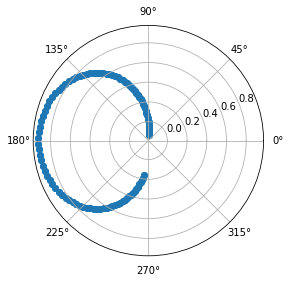

In [25]:
fig1 = plt.figure()
ax1 = fig1.add_axes([0.1,0.1,0.8,0.8],polar=True)
ax1.scatter(df_ra[ ' azimuth'], df_ra[' elevation'],lw=1)
plt.show()

In [26]:
sun_df = pd.DataFrame(suns)

In [27]:
for i in range(200):
    sun_df[0][i] = math.radians(sun_df[0][i])
    sun_df[1][i] = math.radians(sun_df[1][i])

In [28]:
sun_df.tail()

,0,1
195,-1.865321,0.294524
196,-1.865321,0.294524
197,-1.865321,0.294524
198,-1.865321,0.294524
199,-1.865321,0.294524


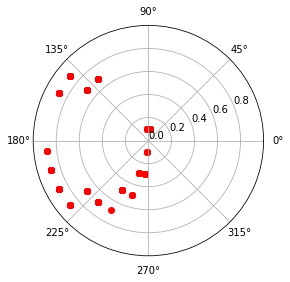

In [29]:
fig1 = plt.figure()
ax1 = fig1.add_axes([0.1,0.1,0.8,0.8],polar=True)
ax1.set_ylim(0,1)
ax1.set_yticks(np.arange(0,1,0.2))
ax1.scatter(sun_df[0], sun_df[1],lw=1, color='r')
plt.show()

[0] angular error :  13.596391277942029
gt: 84.18, -7.97
pred: 84.38, 5.62


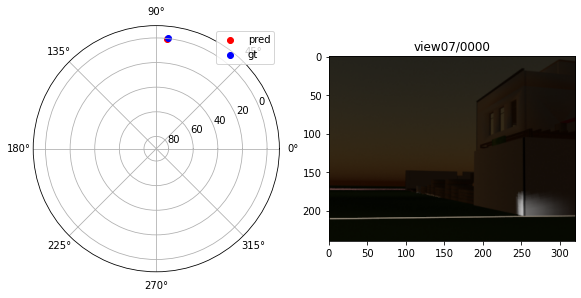

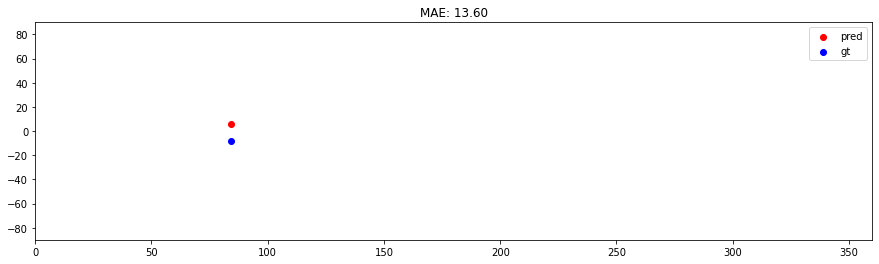

[1] angular error :  12.18629564535478
gt: 85.28, -6.53
pred: 84.38, 5.62


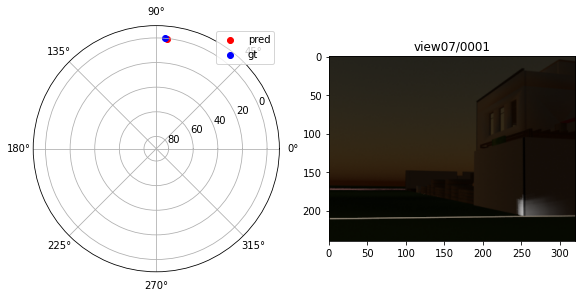

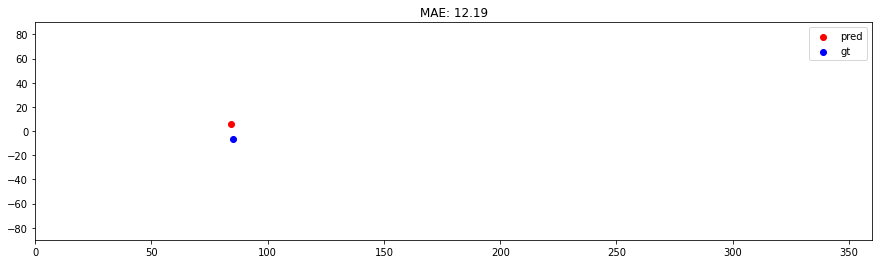

[2] angular error :  10.88746000288399
gt: 86.37, -5.08
pred: 84.38, 5.62


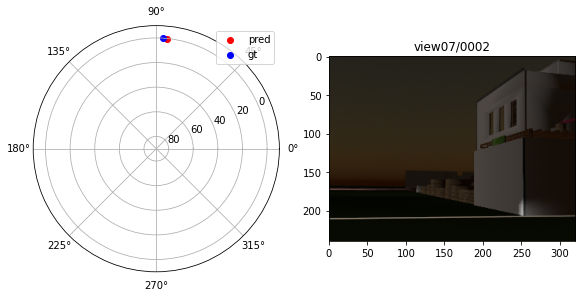

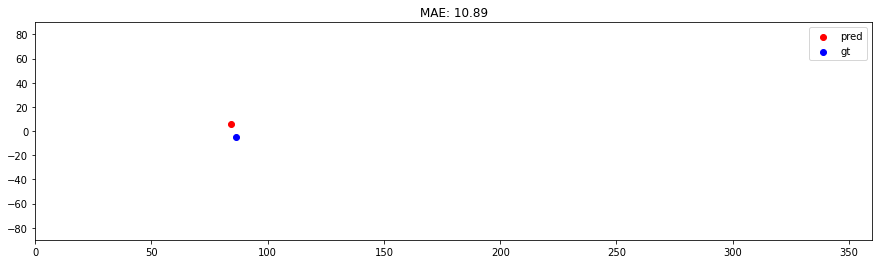

[3] angular error :  12.326921544729553
gt: 87.46, -3.62
pred: 95.63, 5.62


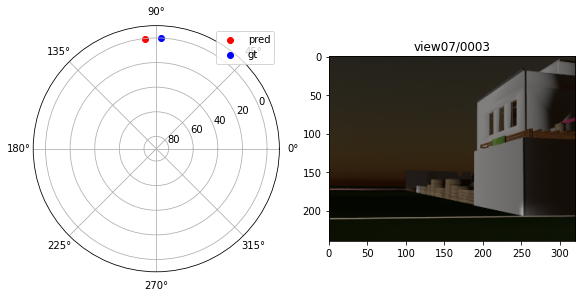

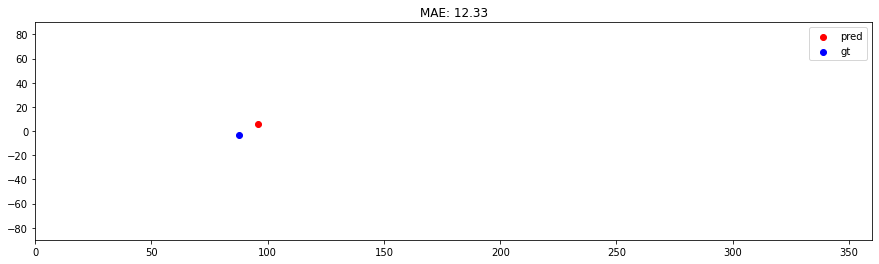

[4] angular error :  10.490964235408063
gt: 88.54, -2.12
pred: 95.63, 5.62


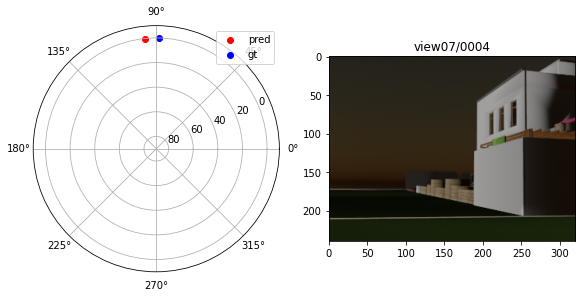

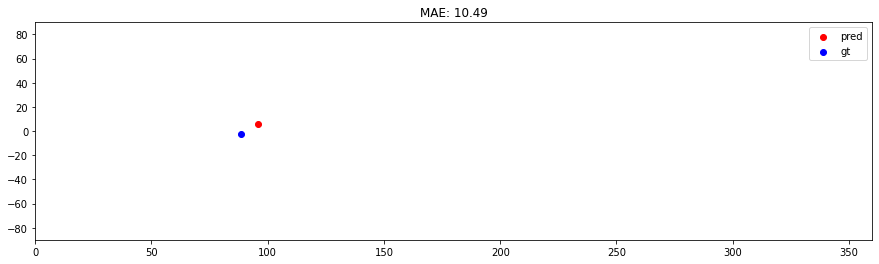

[5] angular error :  8.518236614329322
gt: 89.62, -0.43
pred: 95.63, 5.62


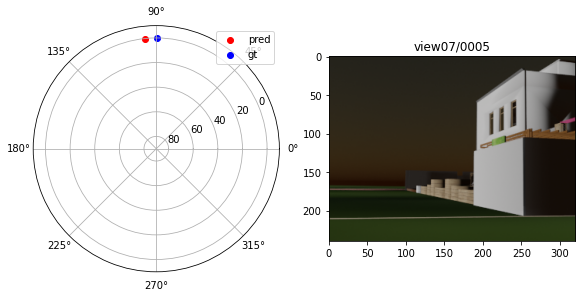

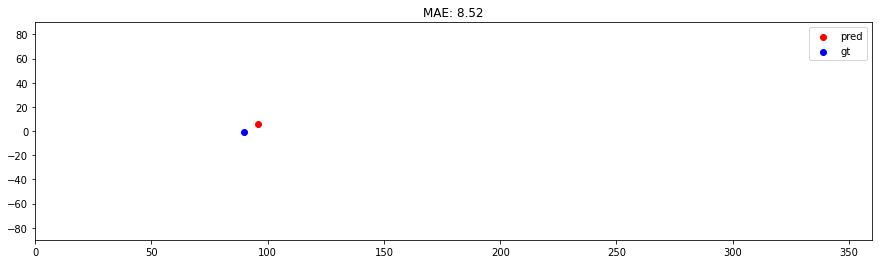

[6] angular error :  7.822715012174097
gt: 90.71, 1.01
pred: 84.38, 5.62


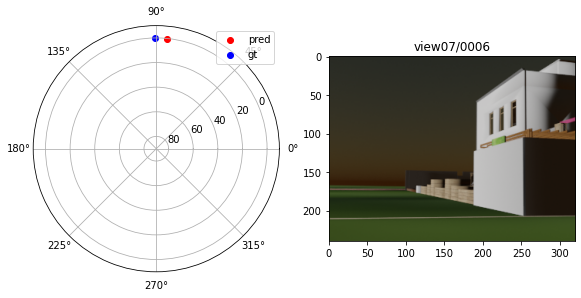

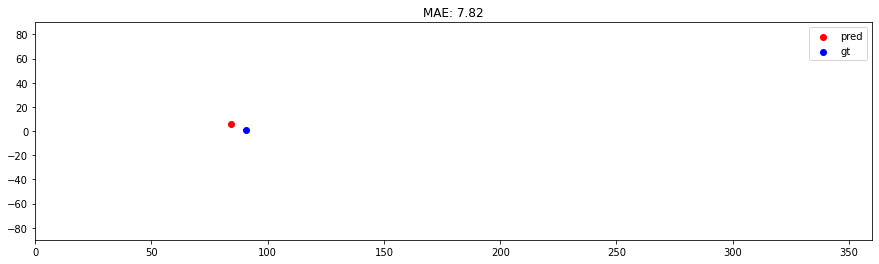

[7] angular error :  8.096629151534508
gt: 91.79, 2.33
pred: 84.38, 5.62


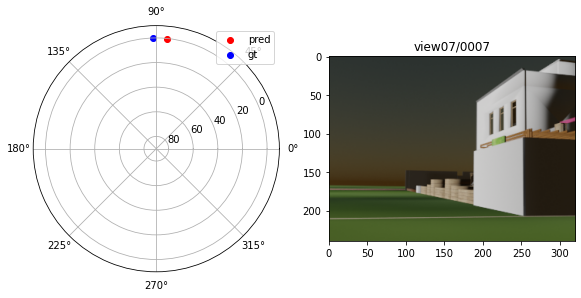

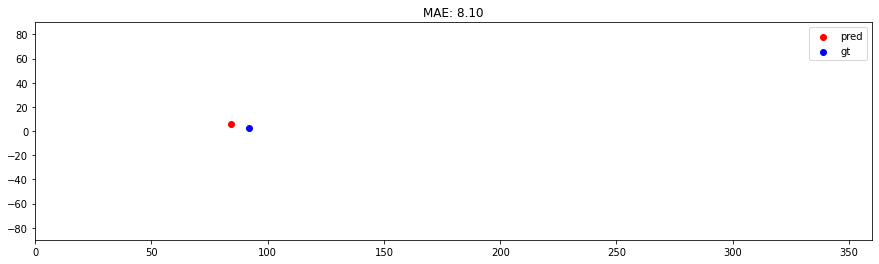

[8] angular error :  3.3531642679210716
gt: 92.87, 3.69
pred: 95.63, 5.62


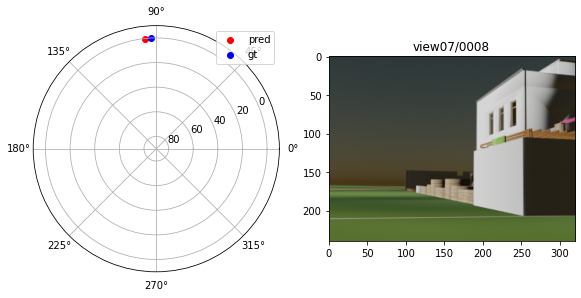

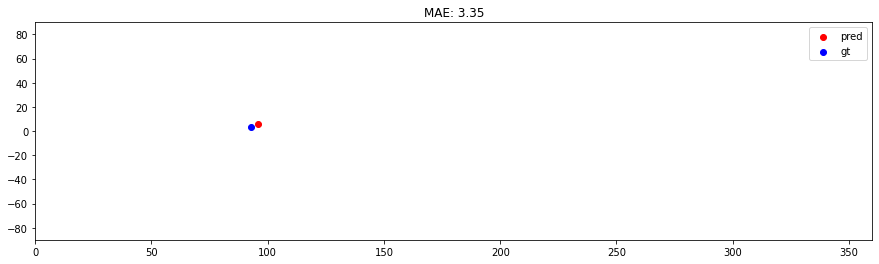

[9] angular error :  1.7412893404544196
gt: 93.96, 5.08
pred: 95.63, 5.62


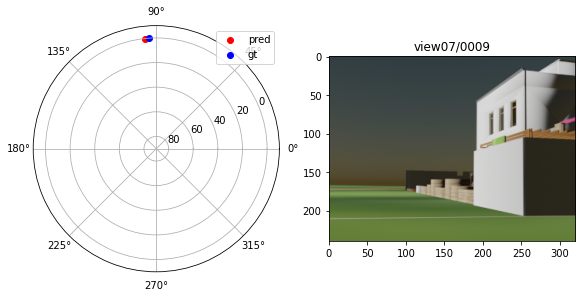

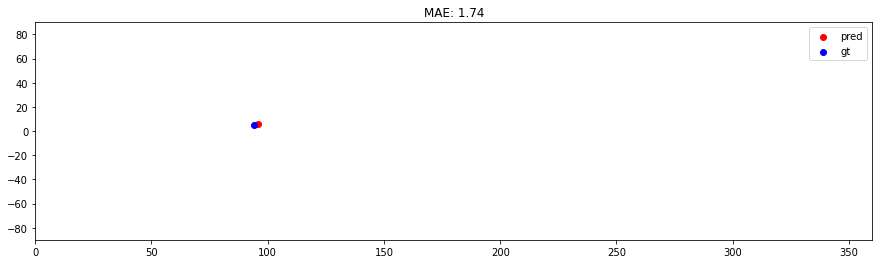

[10] angular error :  1.033594960979236
gt: 95.06, 6.49
pred: 95.63, 5.62


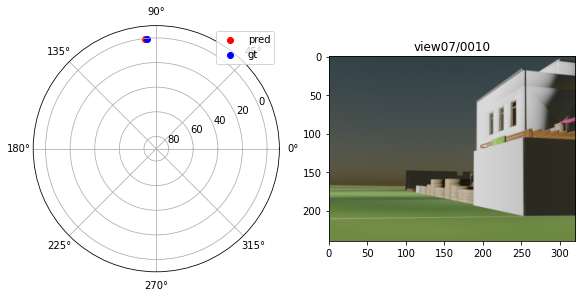

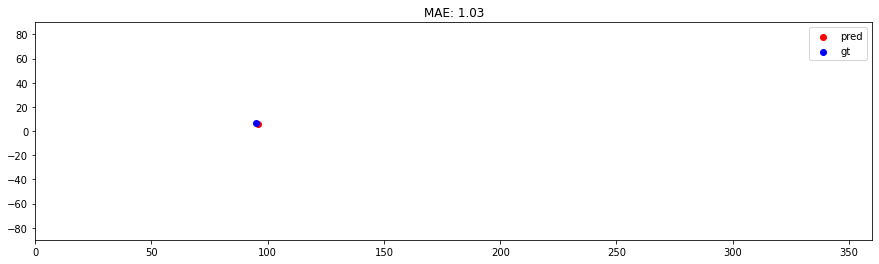

[11] angular error :  131.07261623653446
gt: 96.15, 7.90
pred: 241.88, 28.12


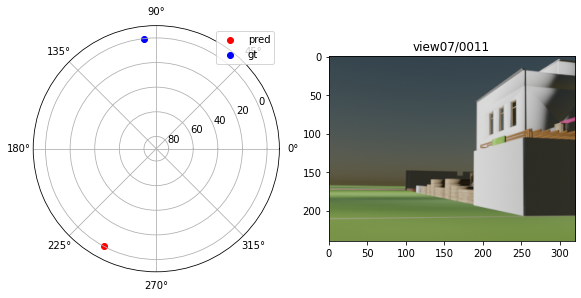

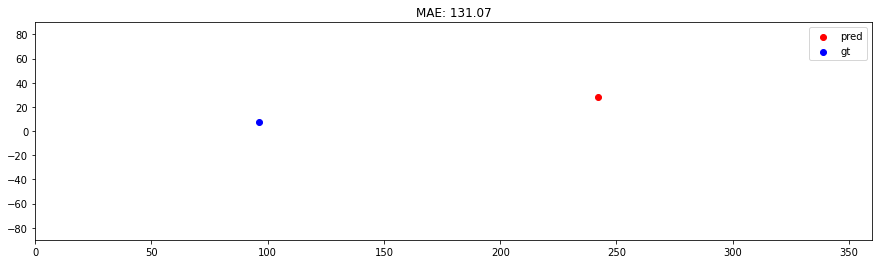

[12] angular error :  129.2882604766761
gt: 97.26, 9.31
pred: 241.88, 28.12


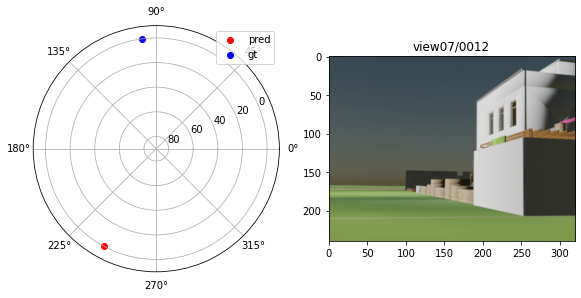

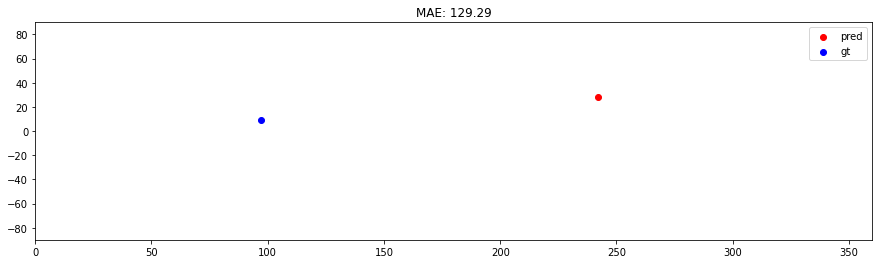

[13] angular error :  127.5009108195198
gt: 98.38, 10.73
pred: 241.88, 28.12


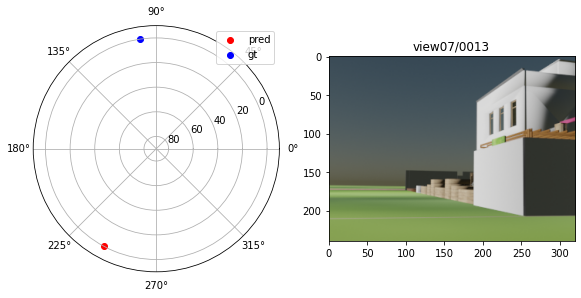

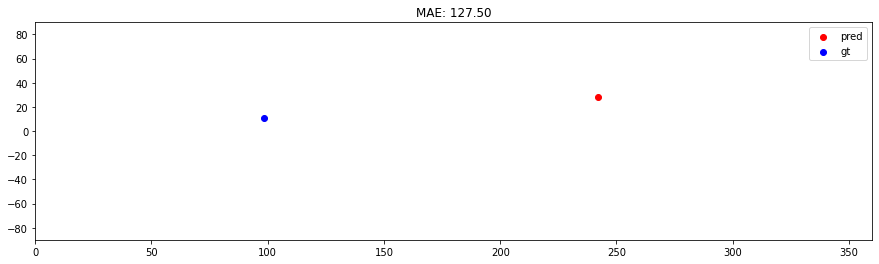

[14] angular error :  125.71143773969875
gt: 99.51, 12.14
pred: 241.88, 28.12


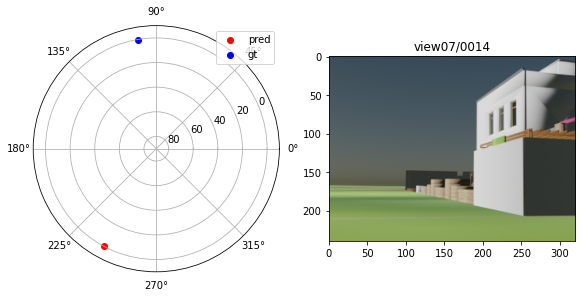

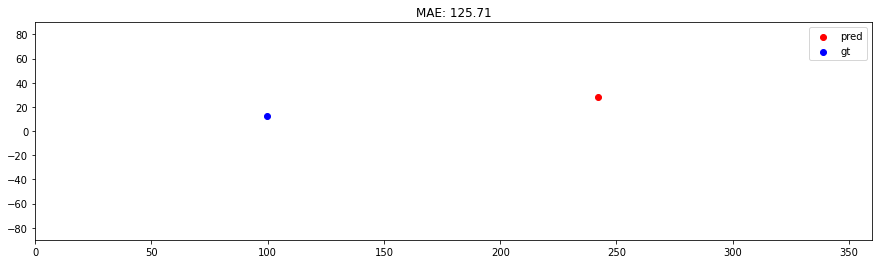

[15] angular error :  123.92040791393204
gt: 100.64, 13.55
pred: 241.88, 28.12


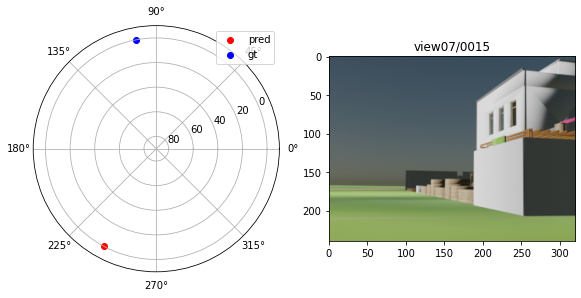

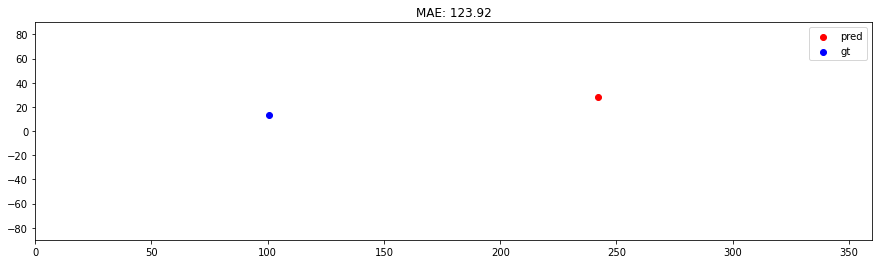

[16] angular error :  122.12820581897259
gt: 101.80, 14.95
pred: 241.88, 28.12


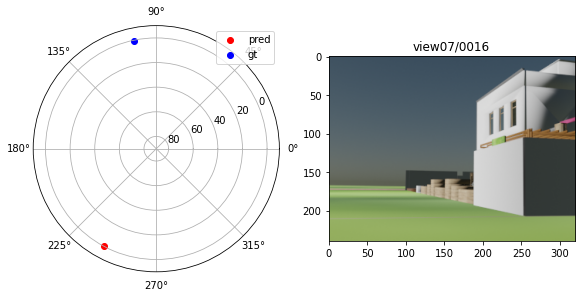

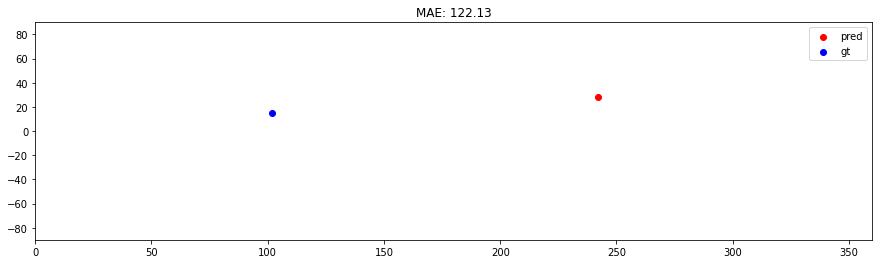

[17] angular error :  120.33509258307771
gt: 102.96, 16.35
pred: 241.88, 28.12


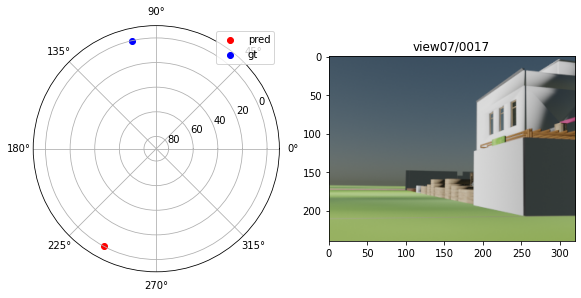

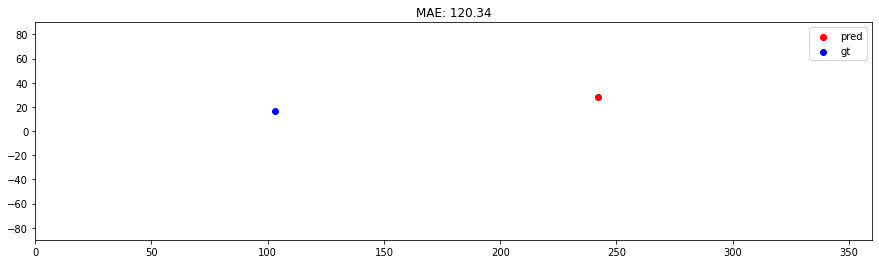

[18] angular error :  118.54125803194579
gt: 104.15, 17.75
pred: 241.88, 28.12


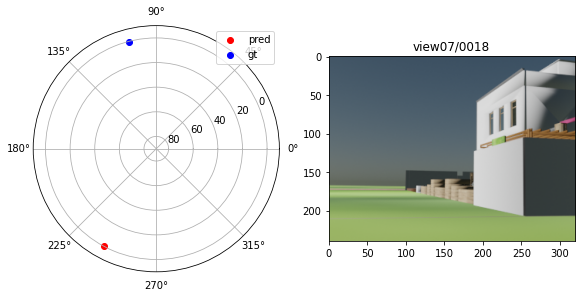

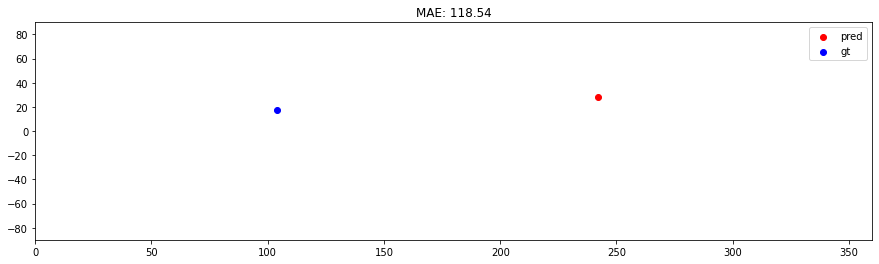

[19] angular error :  116.74684270219493
gt: 105.35, 19.14
pred: 241.88, 28.12


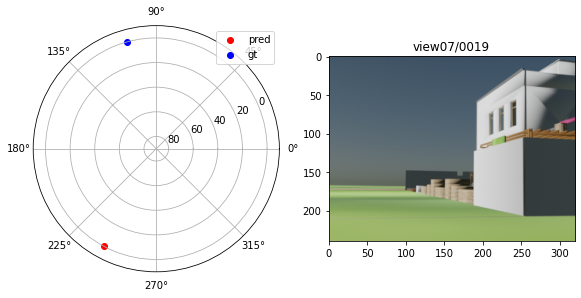

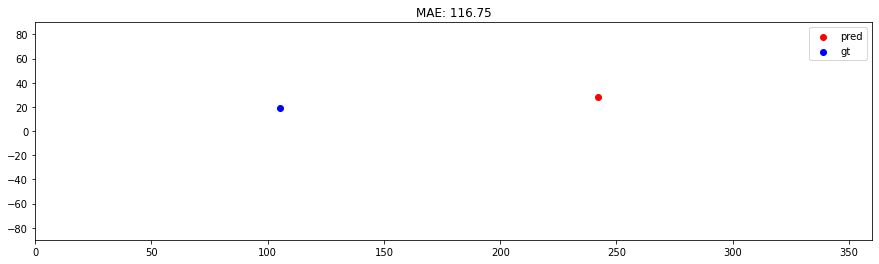

[20] angular error :  114.95195090840176
gt: 106.58, 20.52
pred: 241.88, 28.12


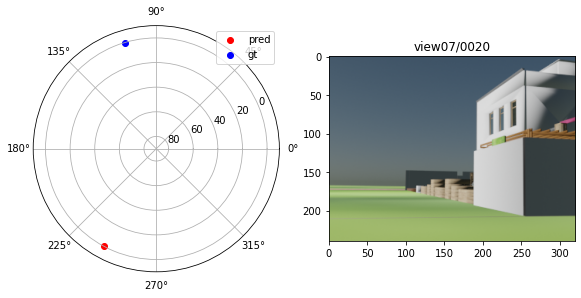

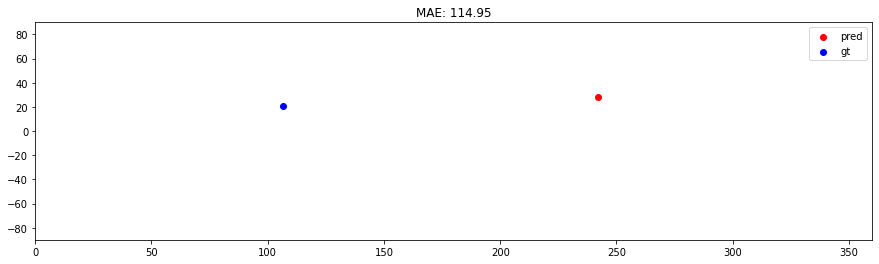

[21] angular error :  113.15666210657584
gt: 107.82, 21.89
pred: 241.88, 28.12


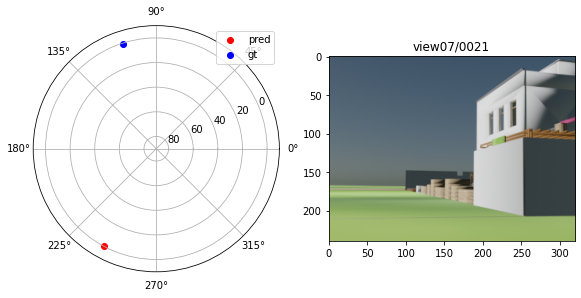

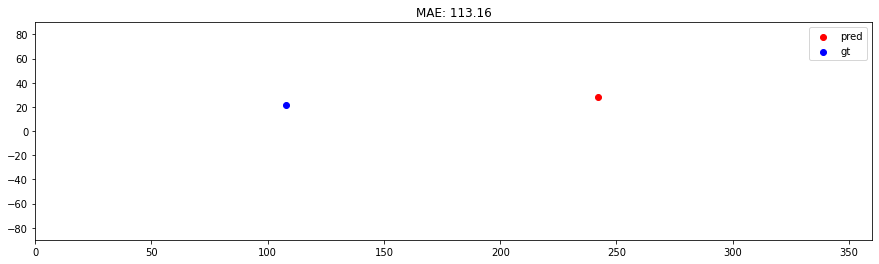

[22] angular error :  111.36103897287276
gt: 109.09, 23.25
pred: 241.88, 28.12


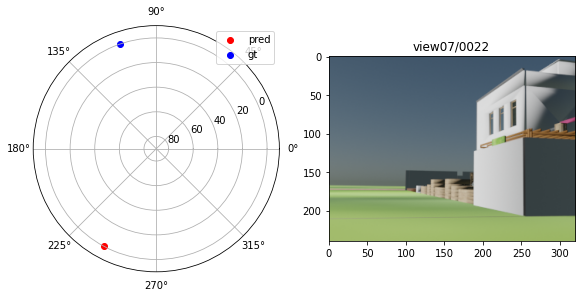

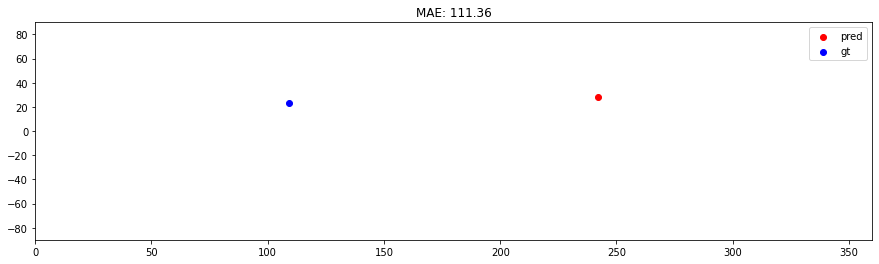

[23] angular error :  109.56513465052012
gt: 110.39, 24.60
pred: 241.88, 28.12


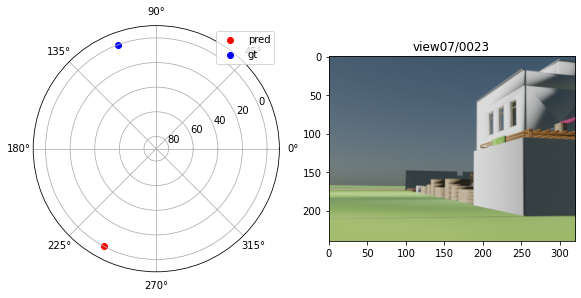

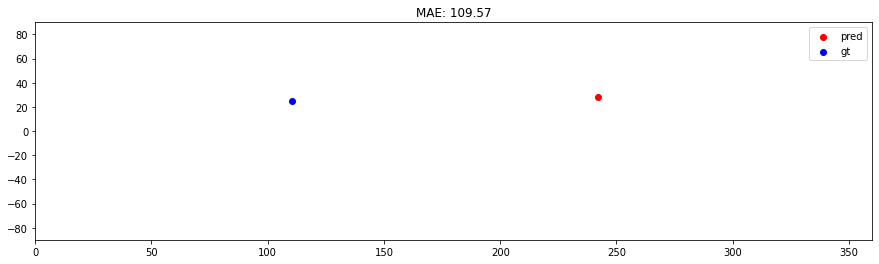

[24] angular error :  107.76898707821535
gt: 111.72, 25.95
pred: 241.88, 28.12


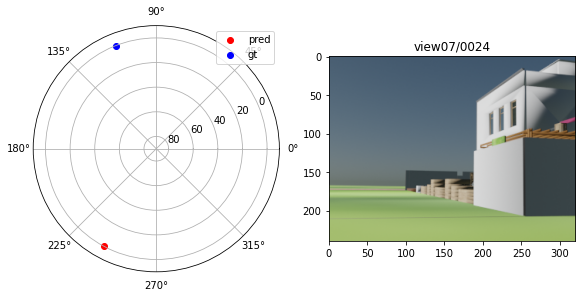

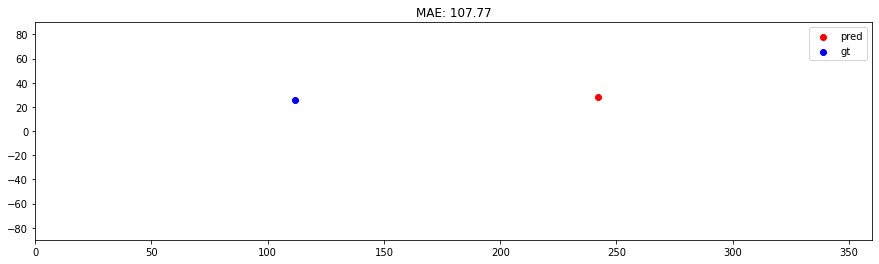

[25] angular error :  105.97263335858891
gt: 113.07, 27.27
pred: 241.88, 28.12


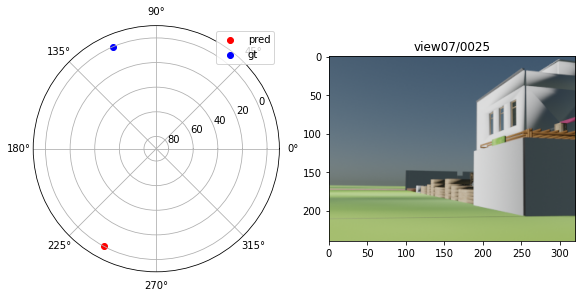

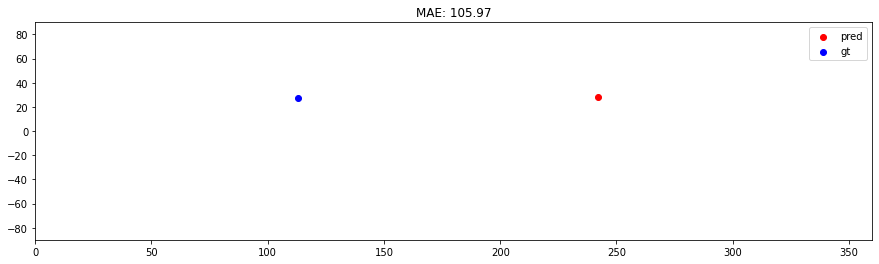

[26] angular error :  104.17609979199177
gt: 114.46, 28.59
pred: 241.88, 28.12


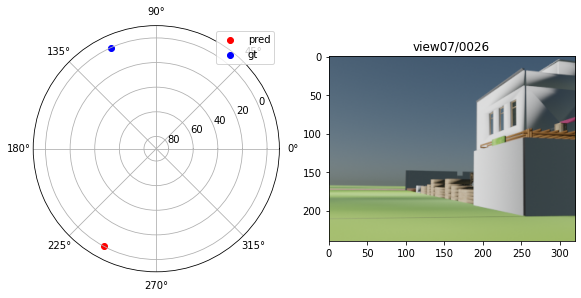

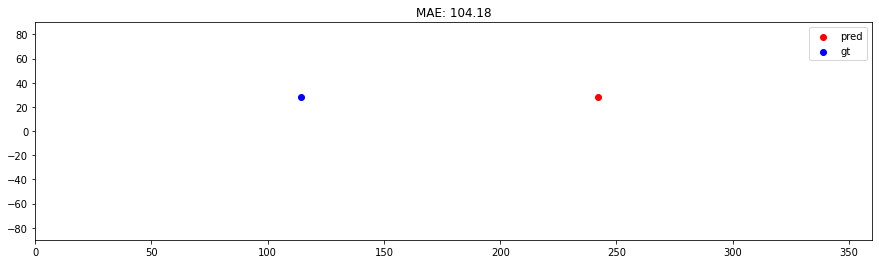

[27] angular error :  102.37941166466116
gt: 115.89, 29.89
pred: 241.88, 28.12


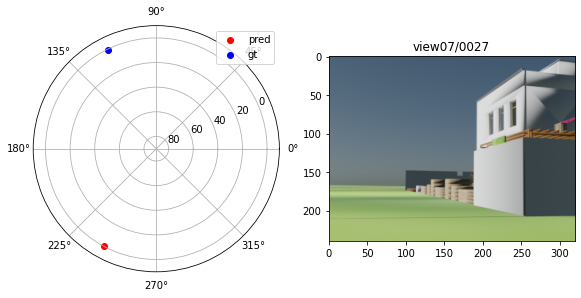

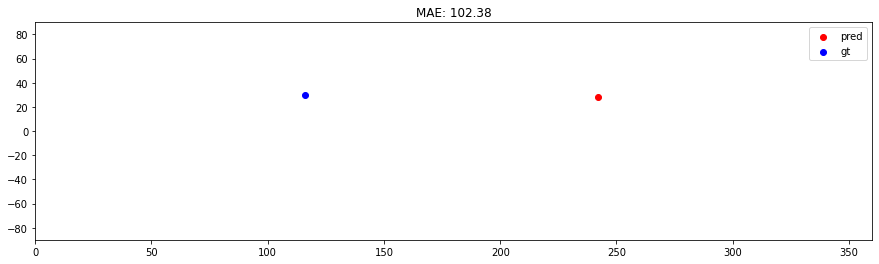

[28] angular error :  100.58258741792895
gt: 117.35, 31.18
pred: 241.88, 28.12


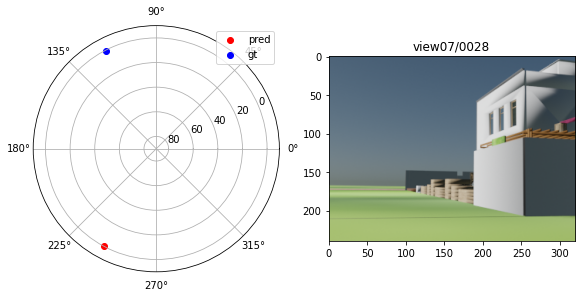

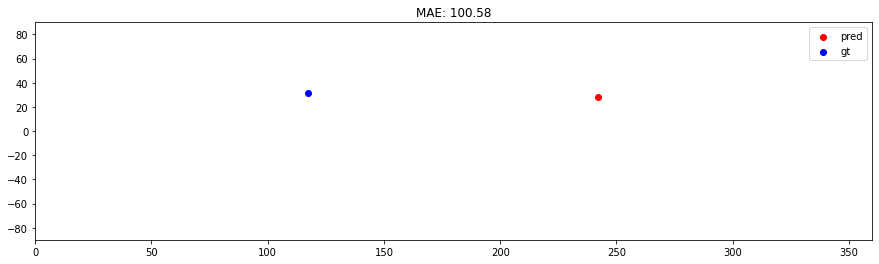

[29] angular error :  90.87093626798332
gt: 118.85, 32.44
pred: 241.88, 39.38


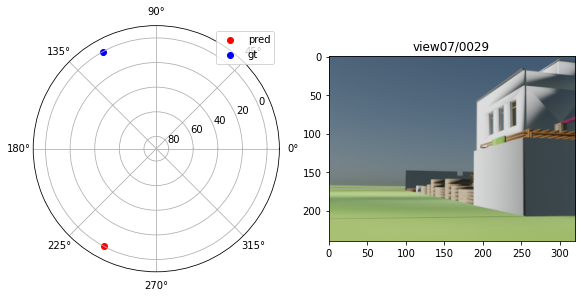

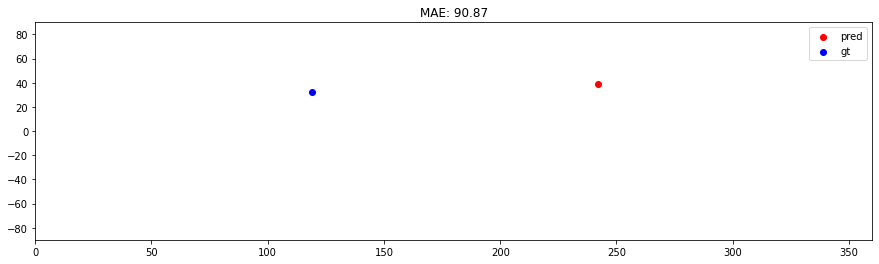

[30] angular error :  82.55746777007901
gt: 120.39, 33.69
pred: 230.62, 39.38


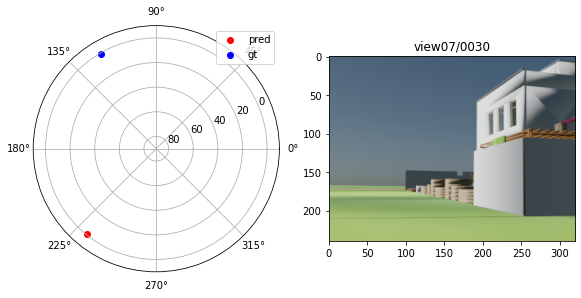

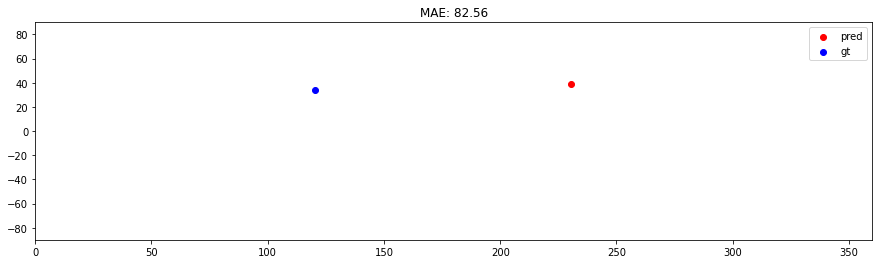

[31] angular error :  80.75821500499428
gt: 121.98, 34.93
pred: 230.62, 39.38


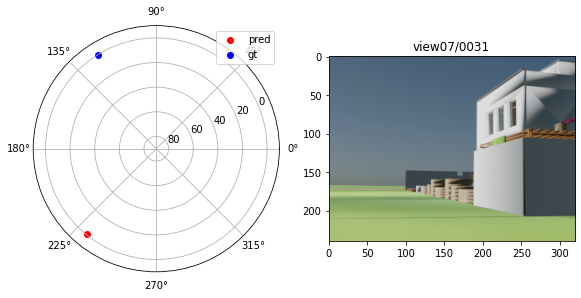

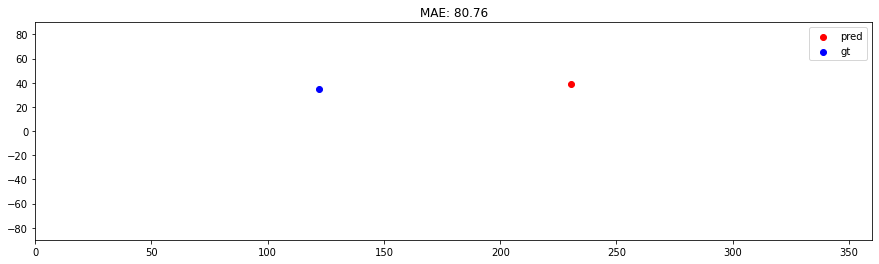

[32] angular error :  78.95890362902516
gt: 123.62, 36.13
pred: 230.62, 39.38


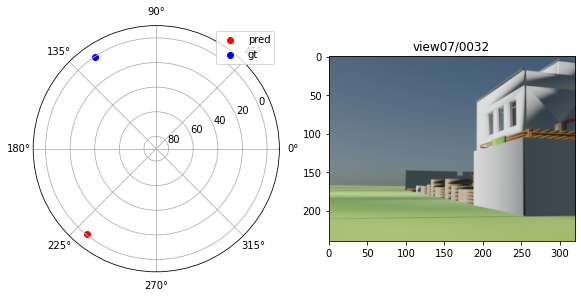

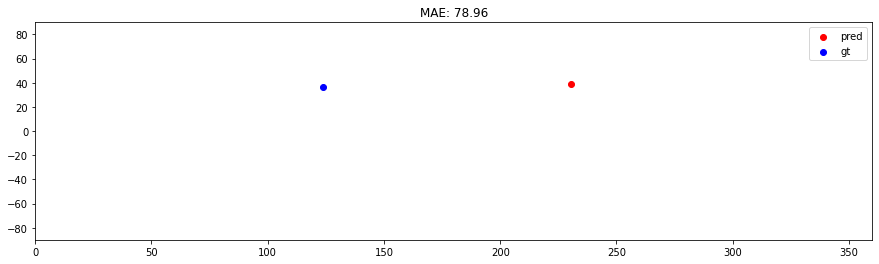

[33] angular error :  77.1595366730409
gt: 125.31, 37.32
pred: 230.62, 39.38


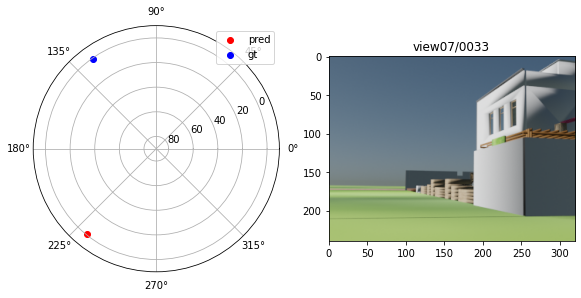

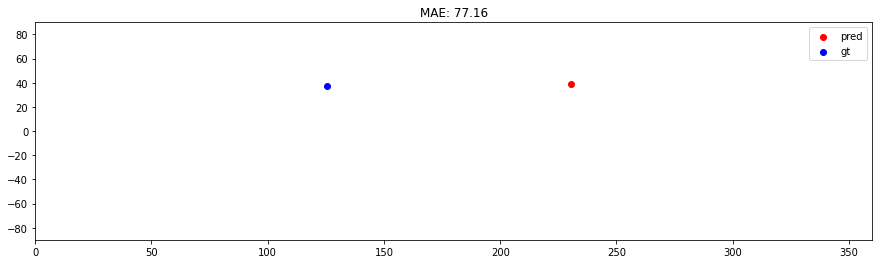

[34] angular error :  68.27036629373542
gt: 127.05, 38.48
pred: 219.38, 39.38


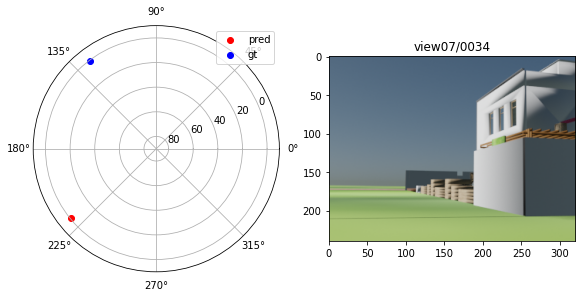

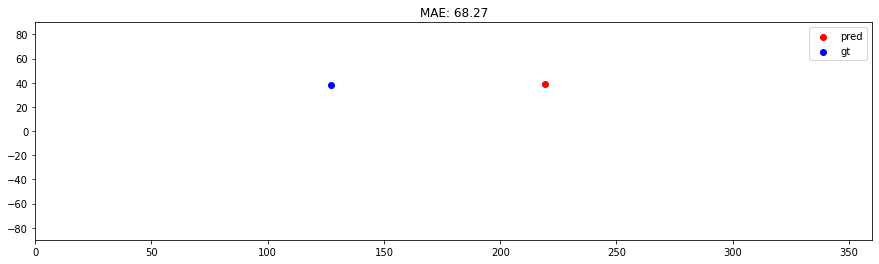

[35] angular error :  66.48045514339351
gt: 128.85, 39.62
pred: 219.38, 39.38


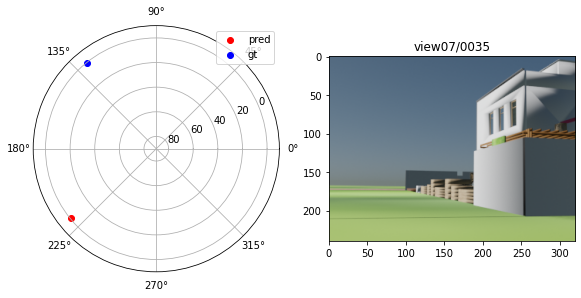

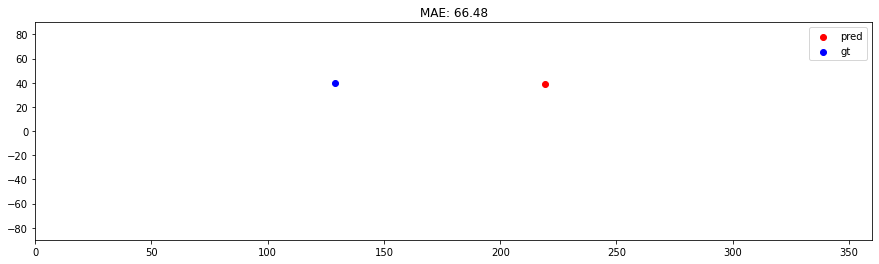

[36] angular error :  64.69076300911959
gt: 130.71, 40.72
pred: 219.38, 39.38


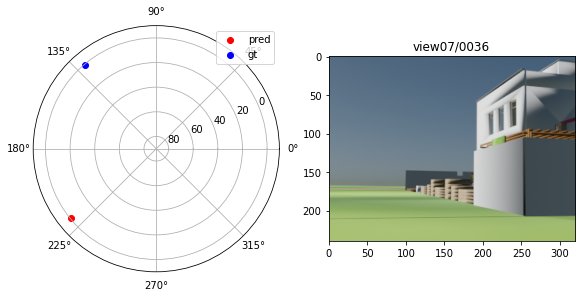

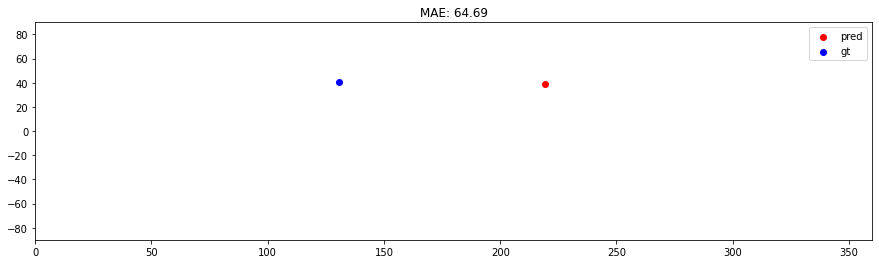

[37] angular error :  62.90132378501098
gt: 132.63, 41.80
pred: 219.38, 39.38


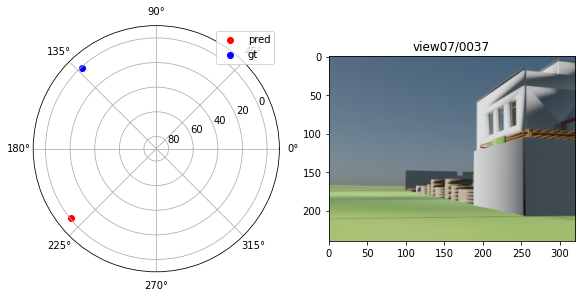

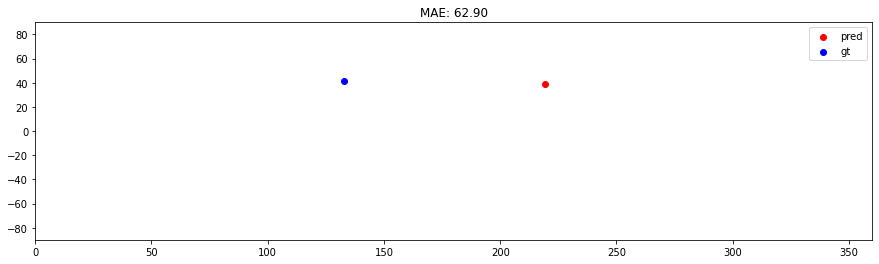

[38] angular error :  61.11217620239464
gt: 134.61, 42.84
pred: 219.38, 39.38


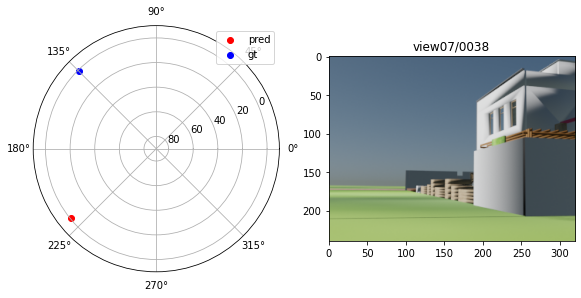

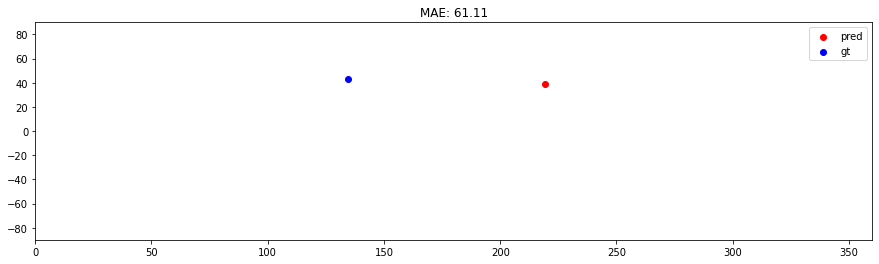

[39] angular error :  59.323361968843756
gt: 136.66, 43.85
pred: 219.38, 39.38


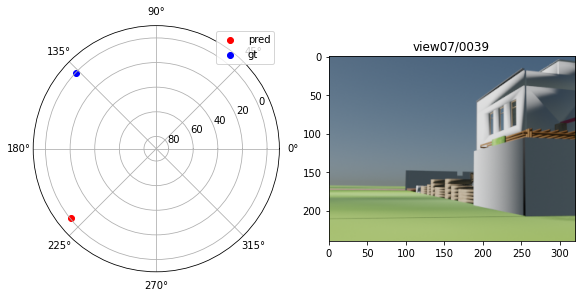

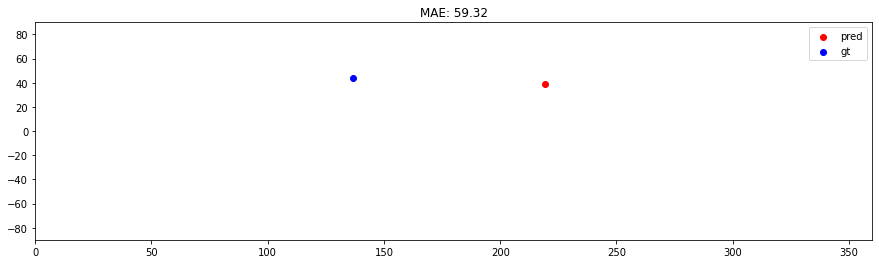

[40] angular error :  51.80027363696362
gt: 138.79, 44.81
pred: 219.38, 50.62


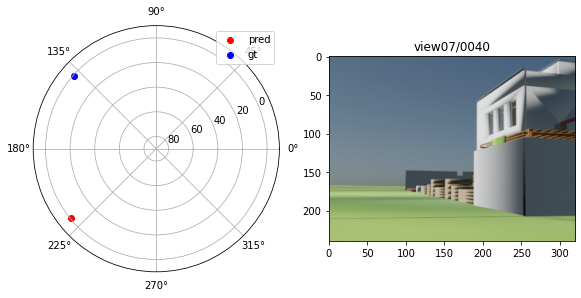

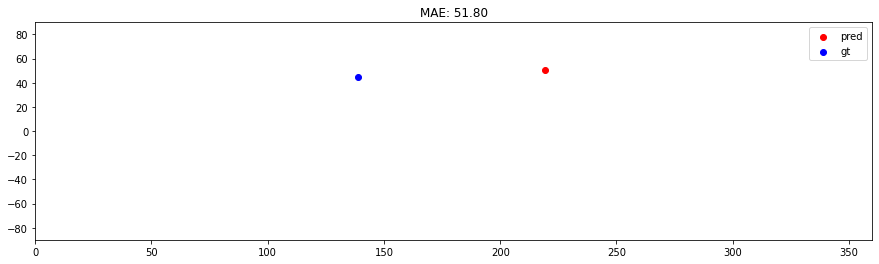

[41] angular error :  50.00876858189041
gt: 140.98, 45.74
pred: 219.38, 50.62


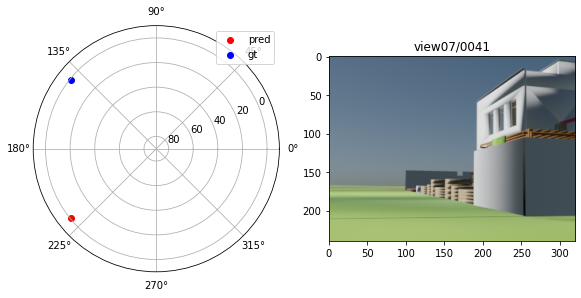

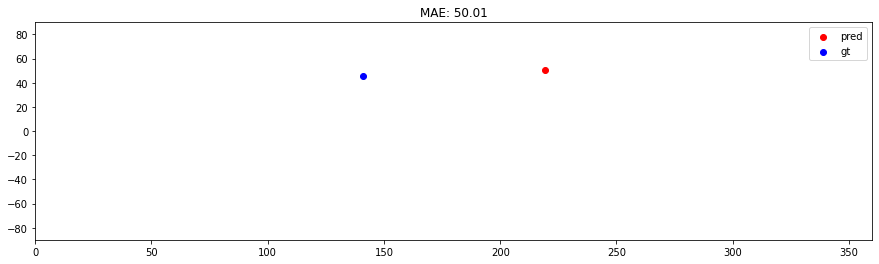

[42] angular error :  48.21769518829332
gt: 143.24, 46.63
pred: 219.38, 50.62


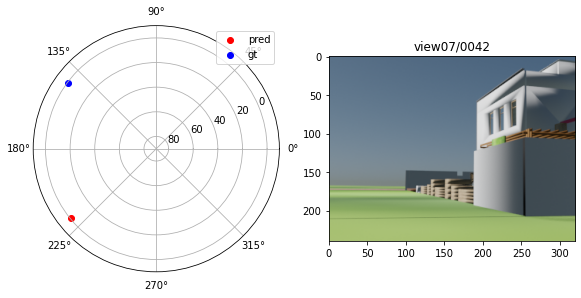

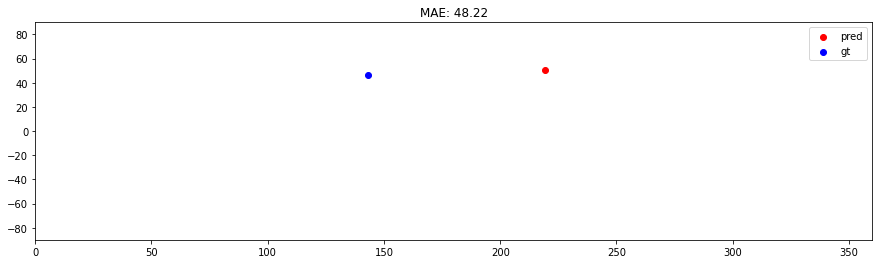

[43] angular error :  46.42711439736198
gt: 145.58, 47.46
pred: 219.38, 50.62


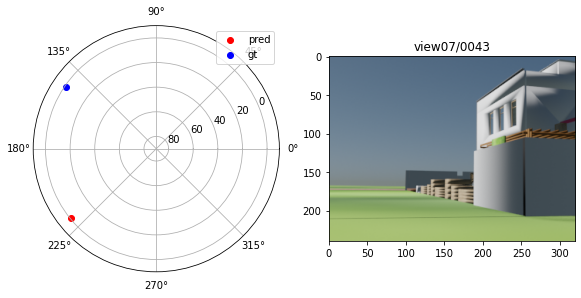

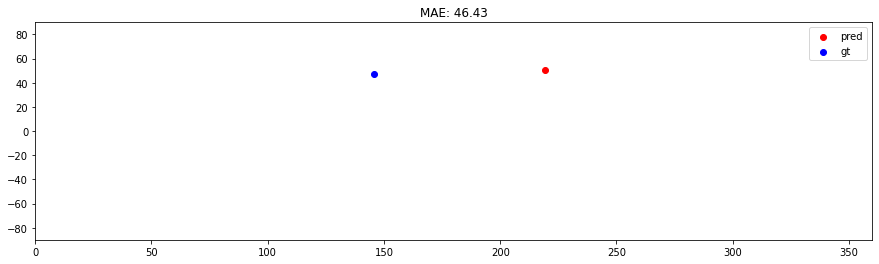

[44] angular error :  44.637092726764294
gt: 147.99, 48.25
pred: 219.38, 50.62


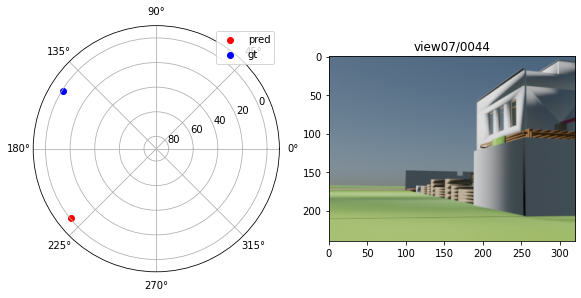

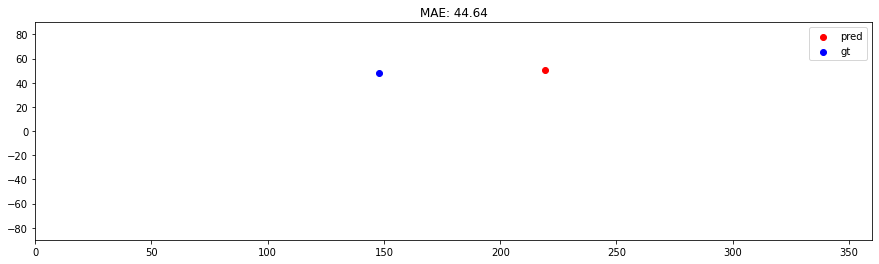

[45] angular error :  36.287954824112816
gt: 150.47, 48.99
pred: 208.12, 50.62


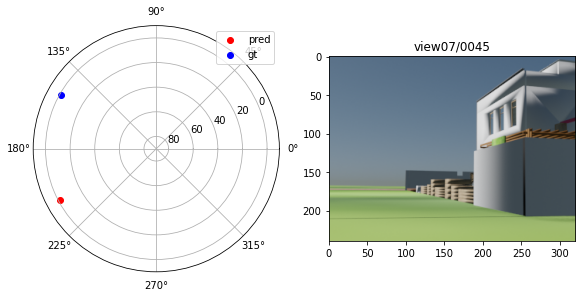

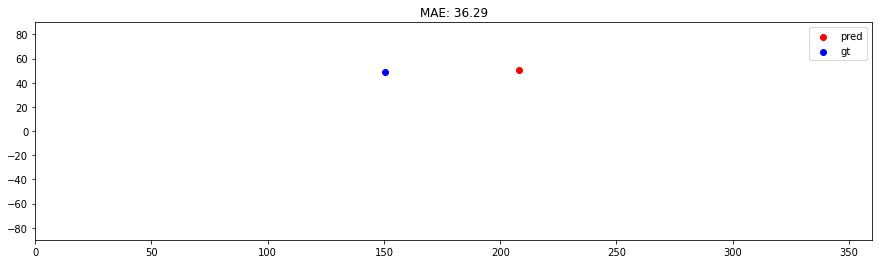

[46] angular error :  34.48915117813596
gt: 153.03, 49.67
pred: 208.12, 50.62


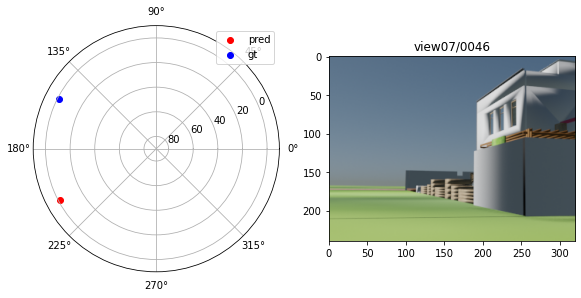

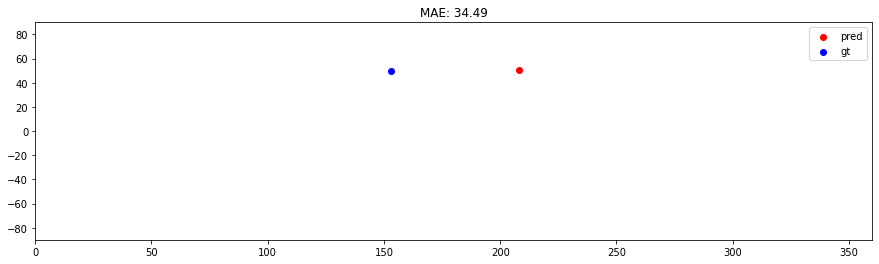

[47] angular error :  32.69043596303732
gt: 155.66, 50.30
pred: 208.12, 50.62


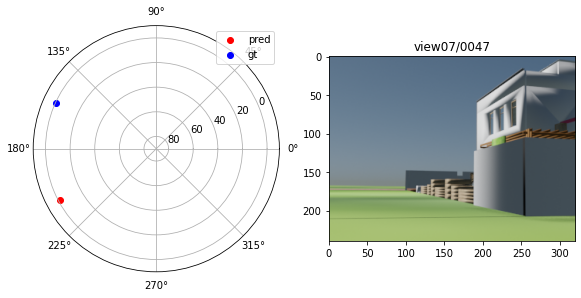

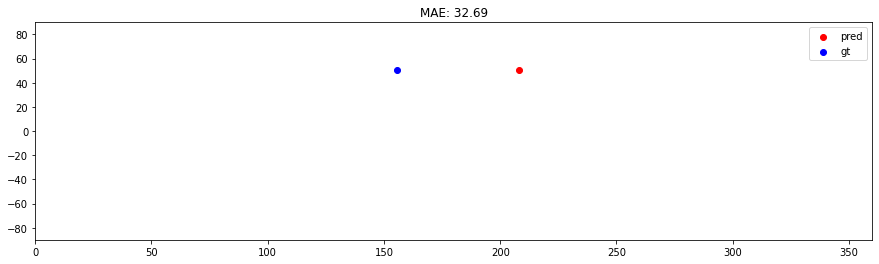

[48] angular error :  30.89182645265086
gt: 158.35, 50.86
pred: 208.12, 50.62


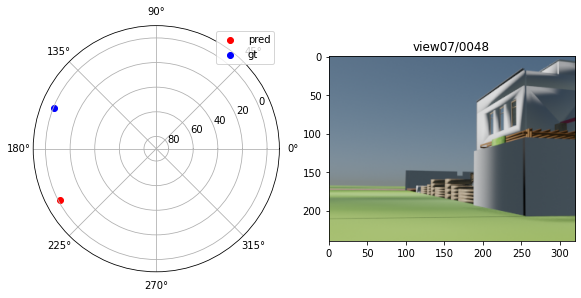

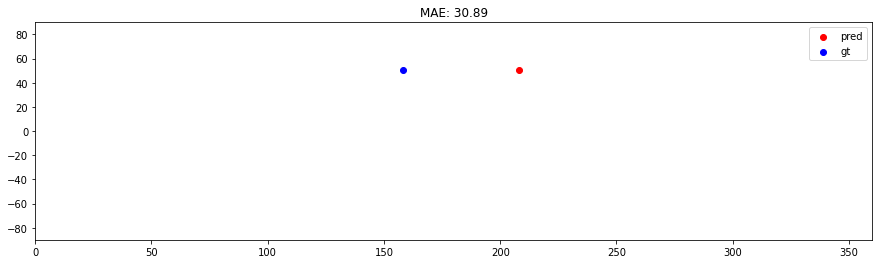

[49] angular error :  29.09334767979204
gt: 161.10, 51.36
pred: 208.12, 50.62


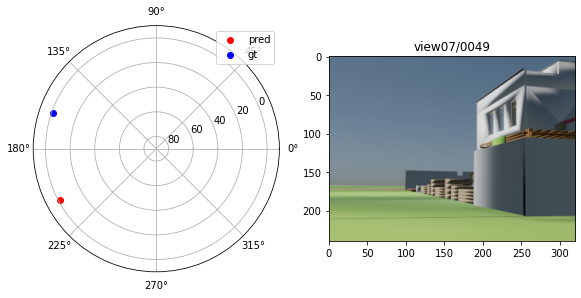

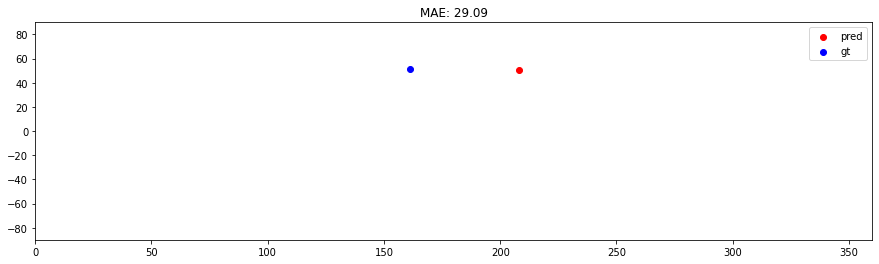

[50] angular error :  27.295028371964868
gt: 163.91, 51.79
pred: 208.12, 50.62


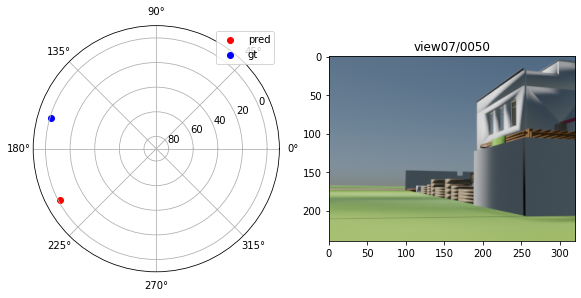

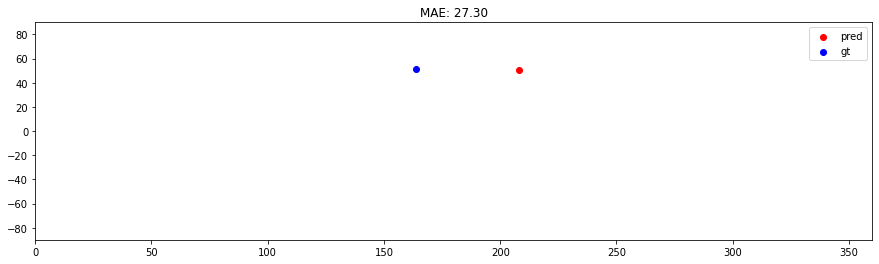

[51] angular error :  25.496903437152167
gt: 166.77, 52.16
pred: 208.12, 50.62


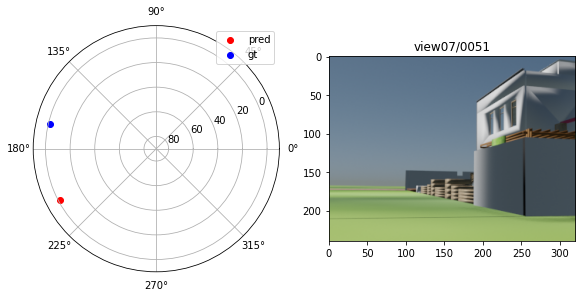

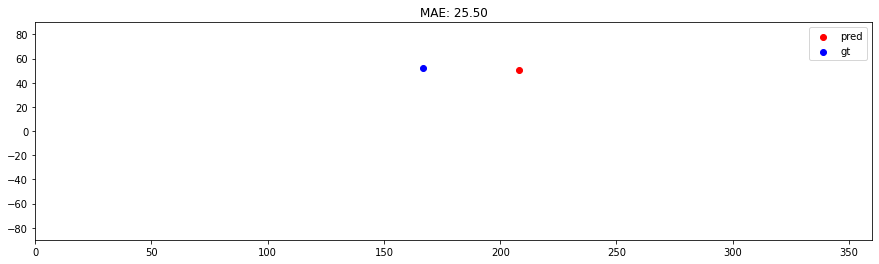

[52] angular error :  23.69902052310251
gt: 169.68, 52.45
pred: 208.12, 50.62


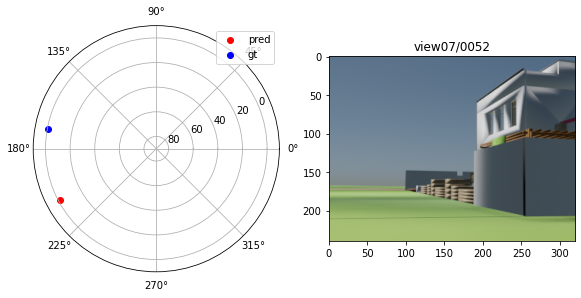

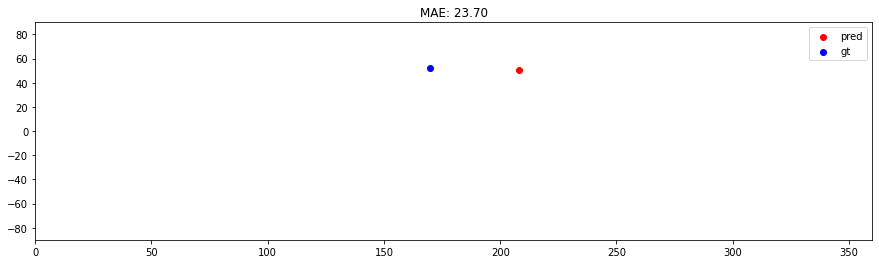

[53] angular error :  21.901441237480814
gt: 172.62, 52.68
pred: 208.12, 50.62


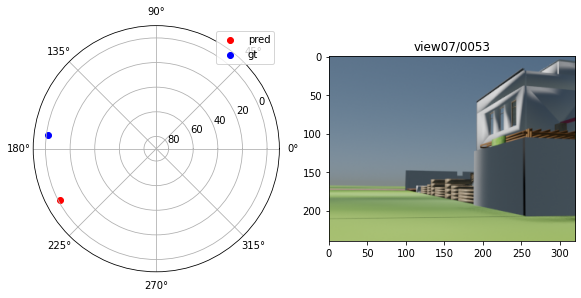

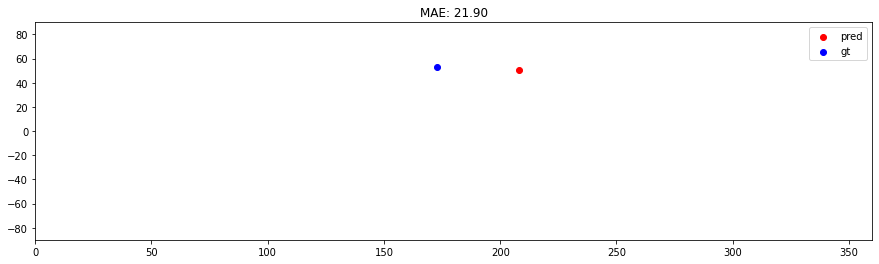

[54] angular error :  20.104249635962354
gt: 175.58, 52.83
pred: 208.12, 50.62


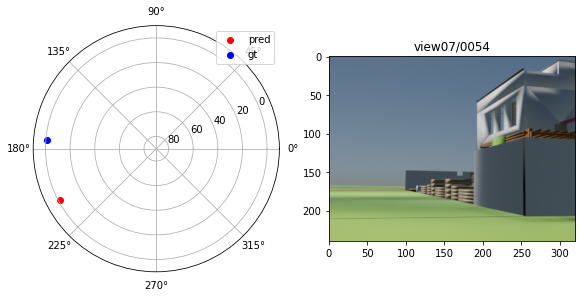

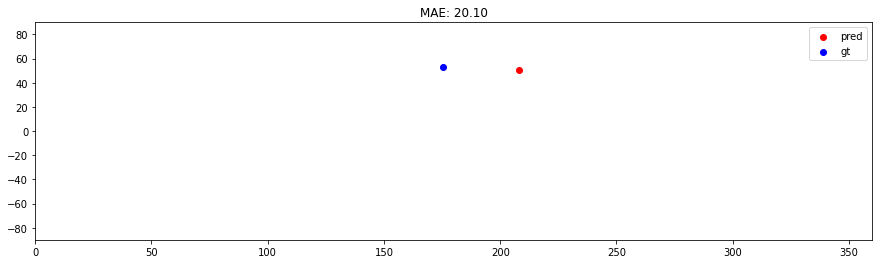

[55] angular error :  18.3075614594809
gt: 178.56, 52.90
pred: 208.12, 50.62


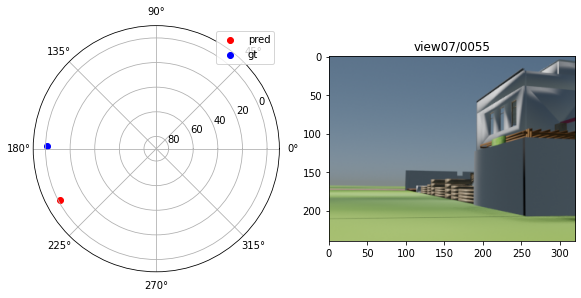

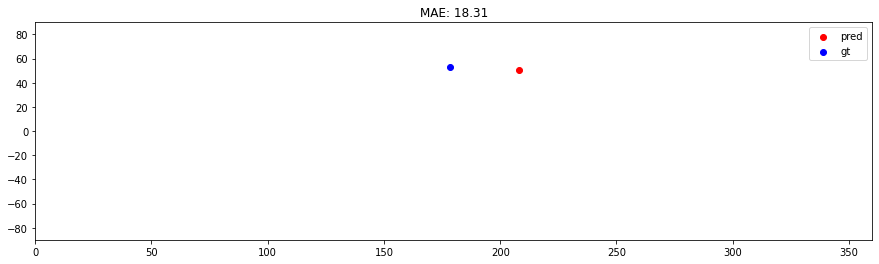

[56] angular error :  16.511542361638863
gt: 181.54, 52.90
pred: 208.12, 50.62


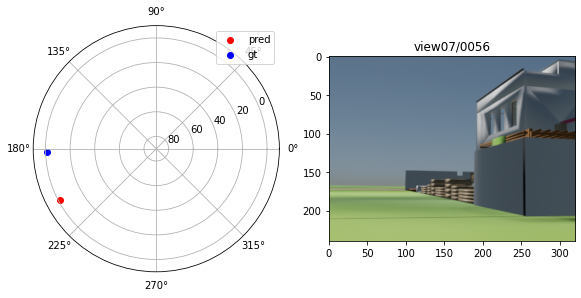

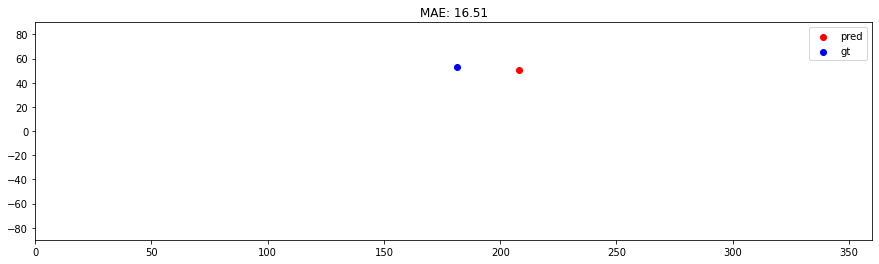

[57] angular error :  14.716438719348377
gt: 184.52, 52.83
pred: 208.12, 50.62


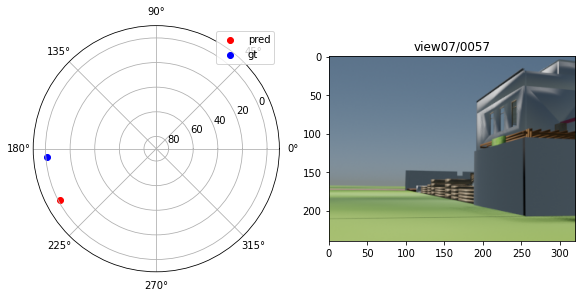

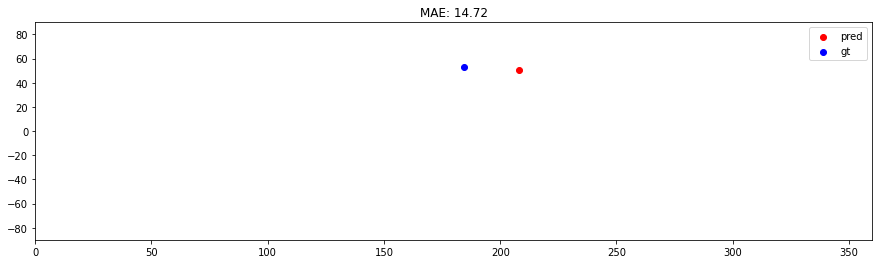

[58] angular error :  6.1717876523002975
gt: 187.49, 52.68
pred: 196.88, 50.62


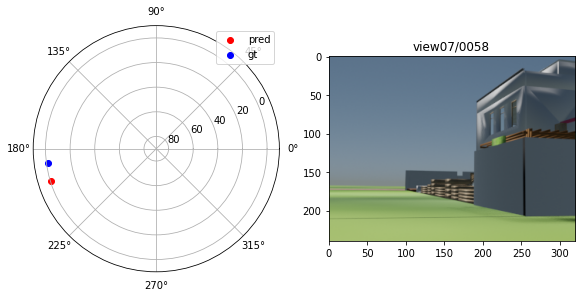

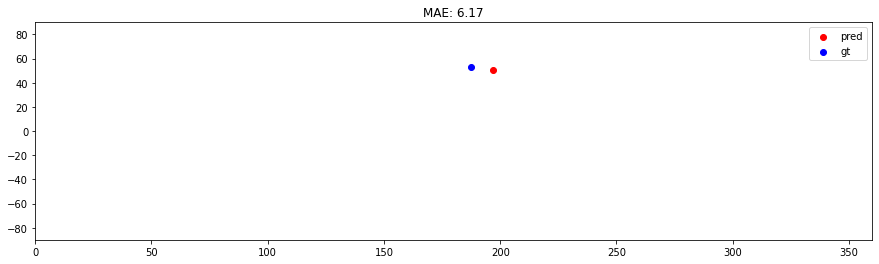

[59] angular error :  4.408864656548757
gt: 190.43, 52.46
pred: 196.88, 50.62


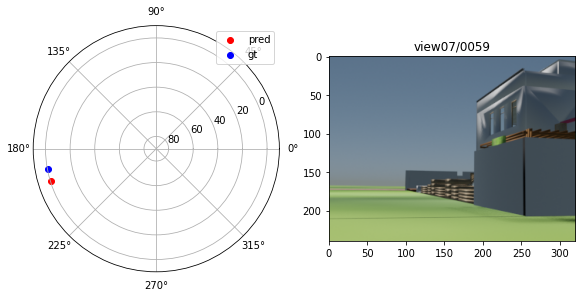

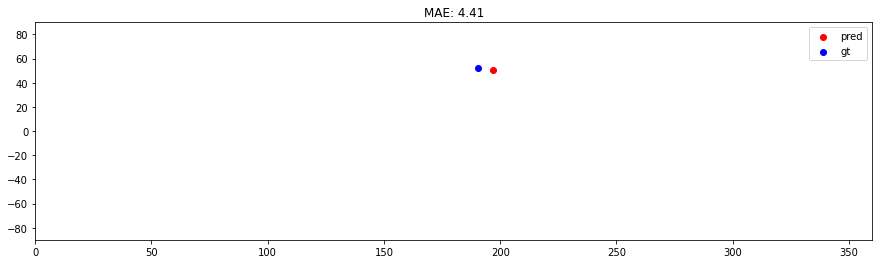

[60] angular error :  2.6950546277329366
gt: 193.33, 52.17
pred: 196.88, 50.62


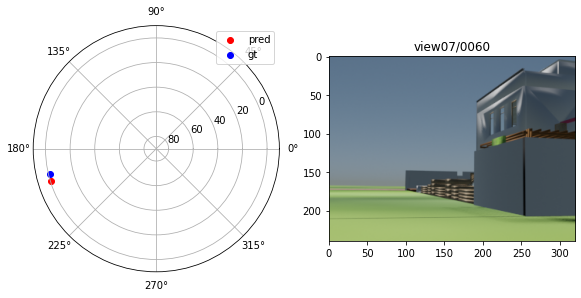

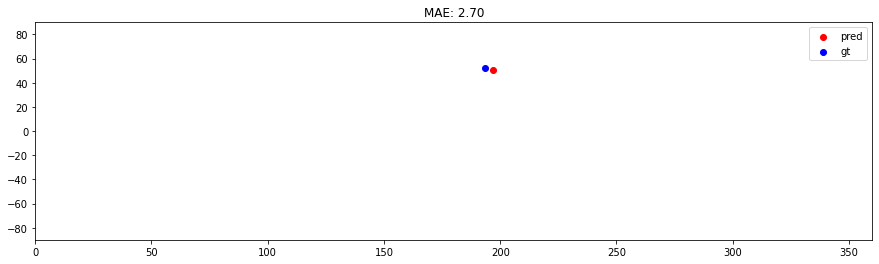

[61] angular error :  1.251653612667987
gt: 196.19, 51.80
pred: 196.88, 50.62


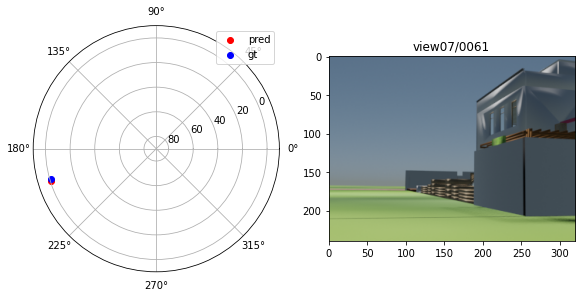

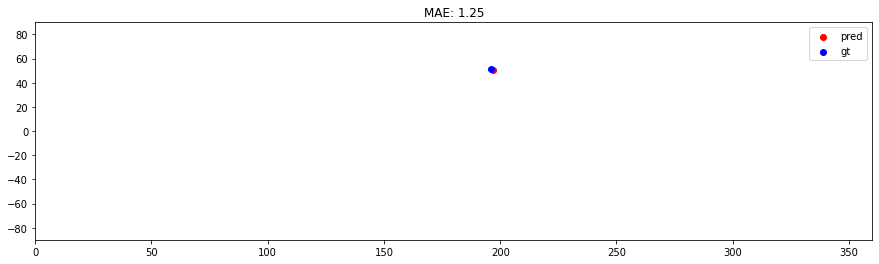

[62] angular error :  1.5323120539301596
gt: 199.00, 51.37
pred: 196.88, 50.62


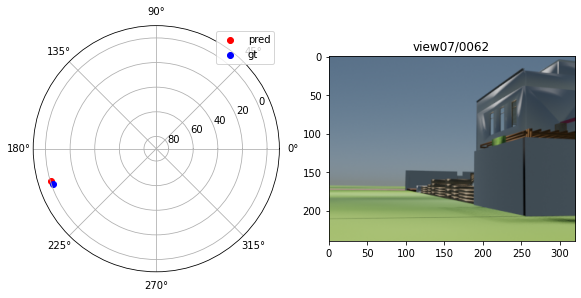

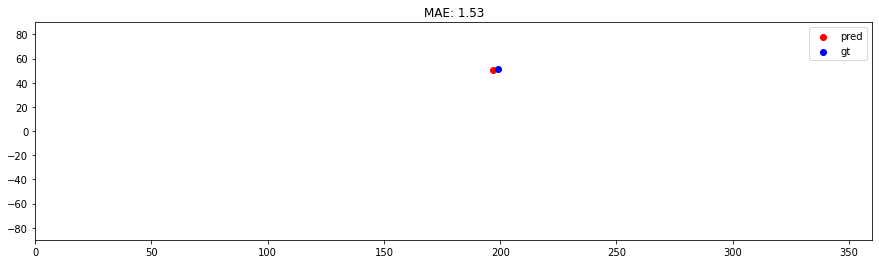

[63] angular error :  3.0995650833484163
gt: 201.76, 50.87
pred: 196.88, 50.62


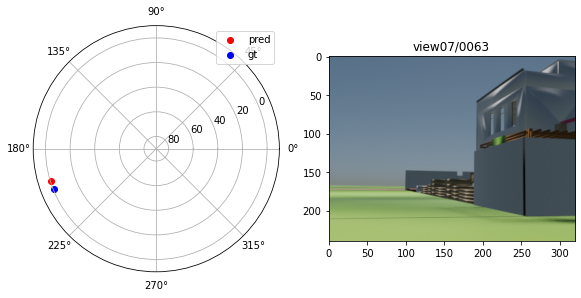

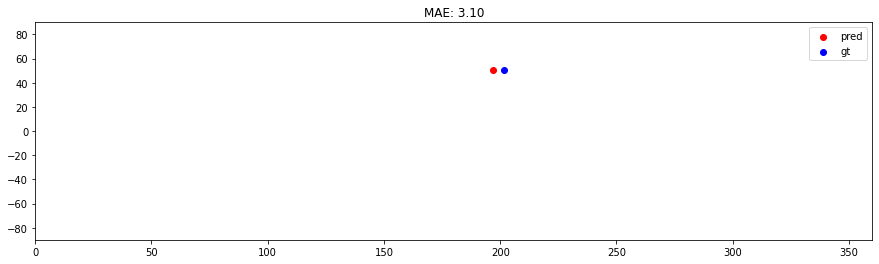

[64] angular error :  4.831616245440079
gt: 204.45, 50.31
pred: 196.88, 50.62


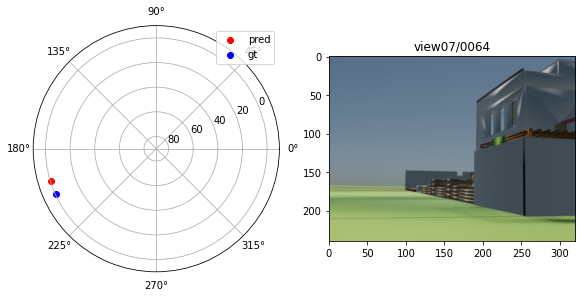

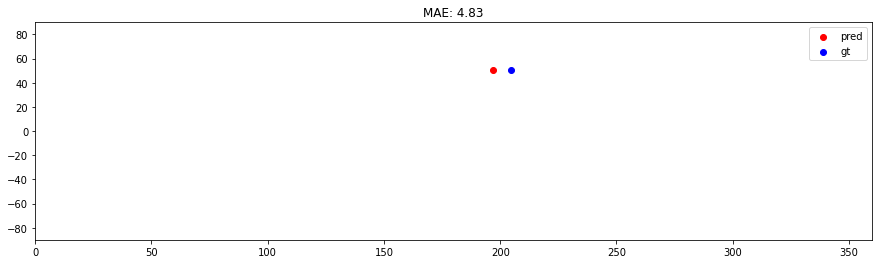

[65] angular error :  6.599963650419953
gt: 207.08, 49.68
pred: 196.88, 50.62


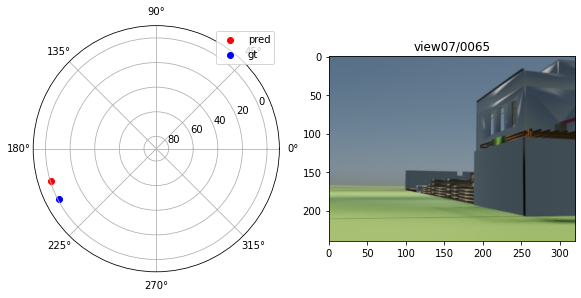

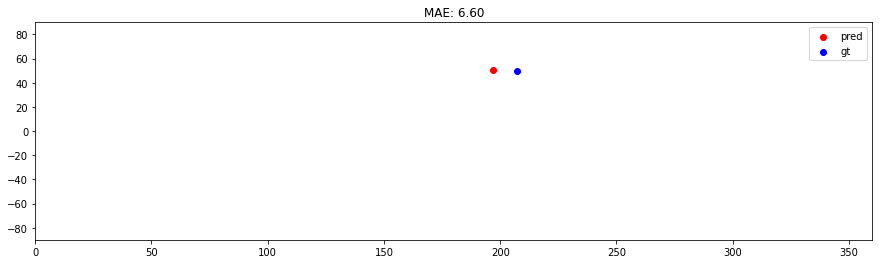

[66] angular error :  8.381659164148155
gt: 209.64, 49.00
pred: 196.88, 50.62


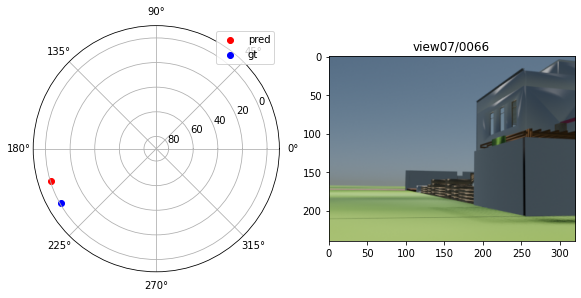

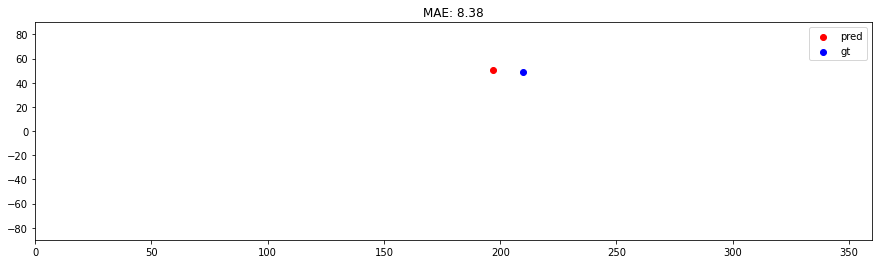

[67] angular error :  10.169681664796624
gt: 212.12, 48.27
pred: 196.88, 50.62


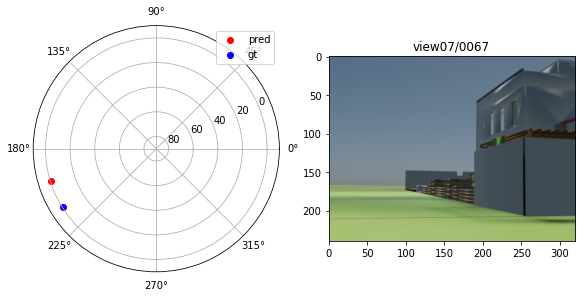

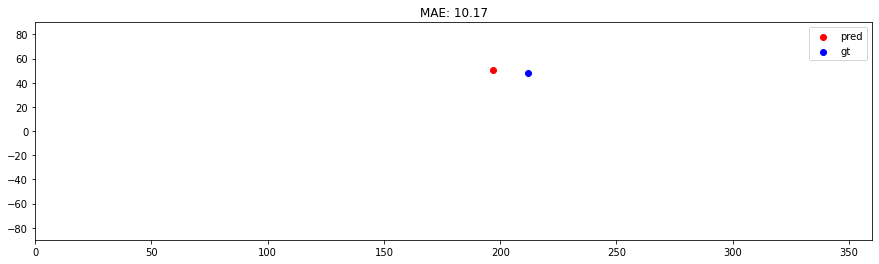

[68] angular error :  11.961187570974737
gt: 214.54, 47.48
pred: 196.88, 50.62


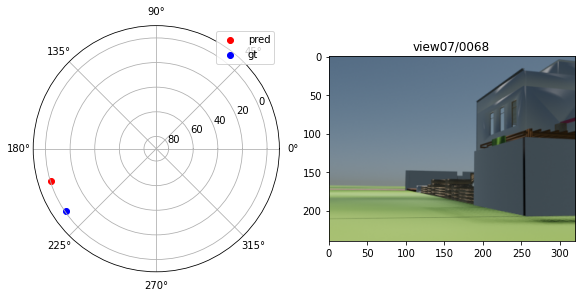

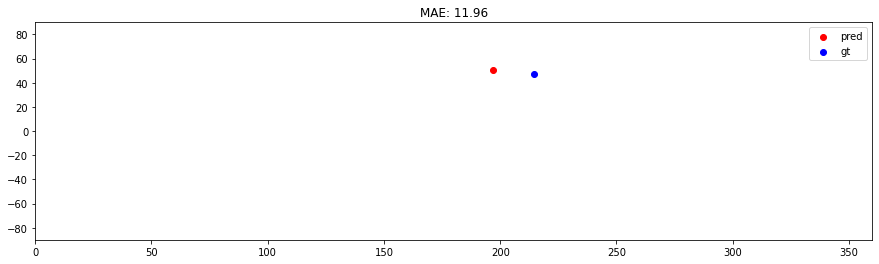

[69] angular error :  13.75480965839584
gt: 216.87, 46.64
pred: 196.88, 50.62


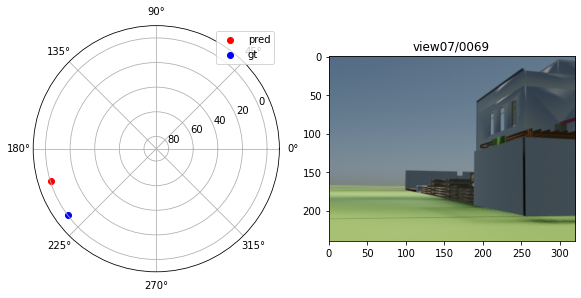

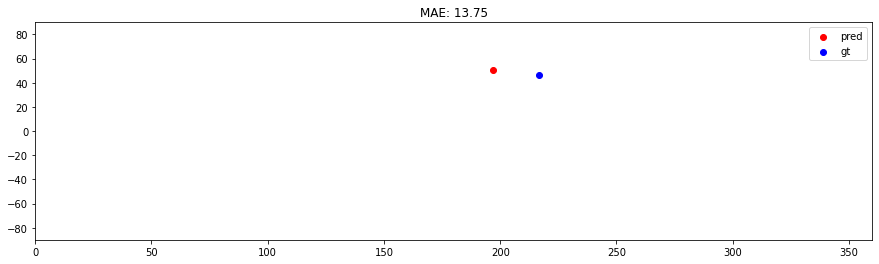

[70] angular error :  15.549807793696992
gt: 219.14, 45.76
pred: 196.88, 50.62


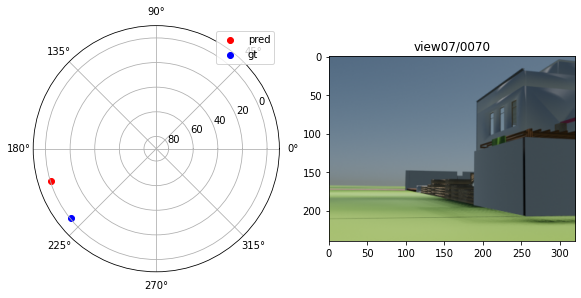

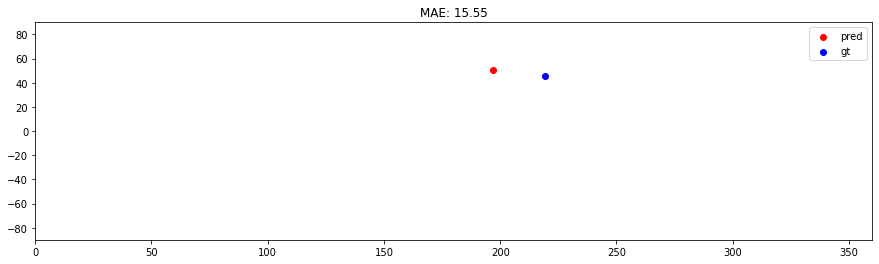

[71] angular error :  17.3457472273288
gt: 221.33, 44.83
pred: 196.88, 50.62


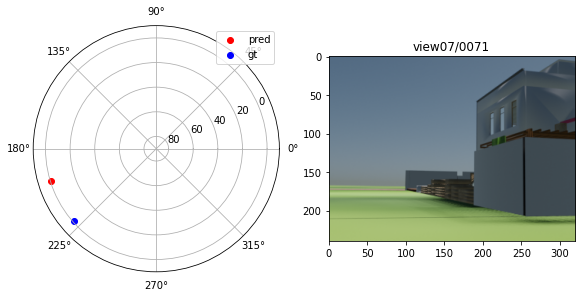

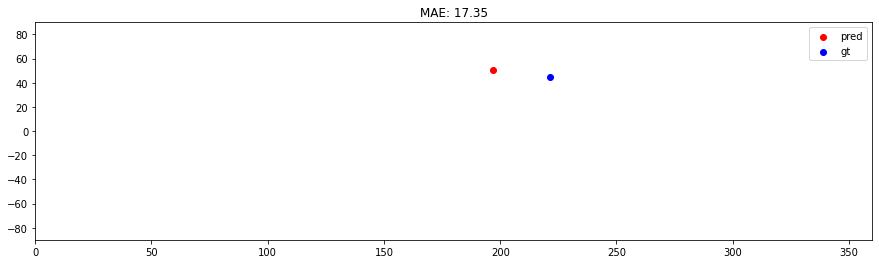

[72] angular error :  19.14235692654522
gt: 223.46, 43.87
pred: 196.88, 50.62


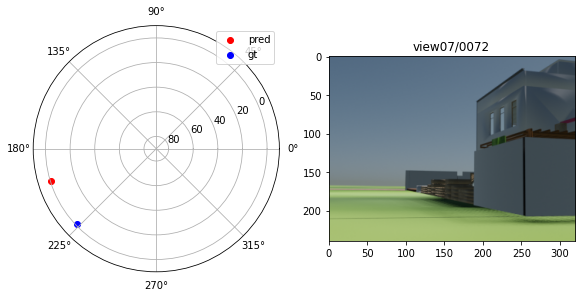

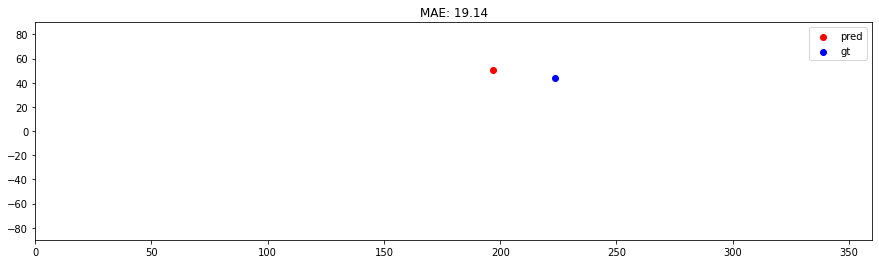

[73] angular error :  28.037343779228685
gt: 225.51, 42.86
pred: 185.62, 50.62


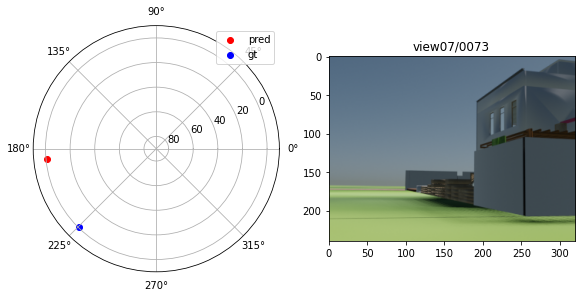

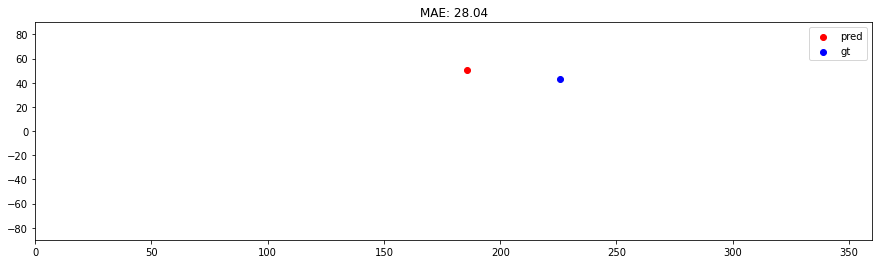

[74] angular error :  29.83154459407247
gt: 227.50, 41.82
pred: 185.62, 50.62


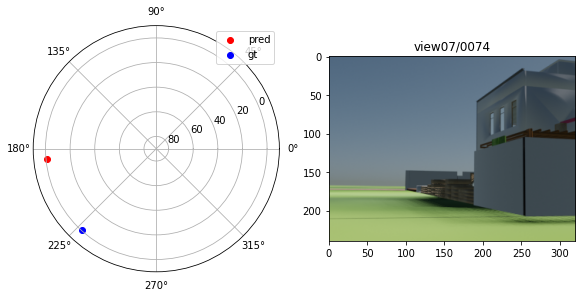

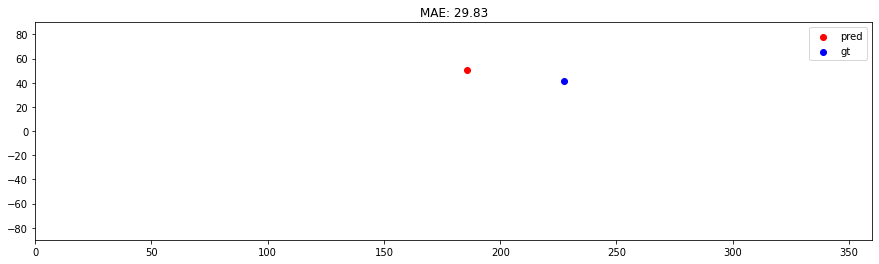

[75] angular error :  31.62627877801679
gt: 229.42, 40.75
pred: 185.62, 50.62


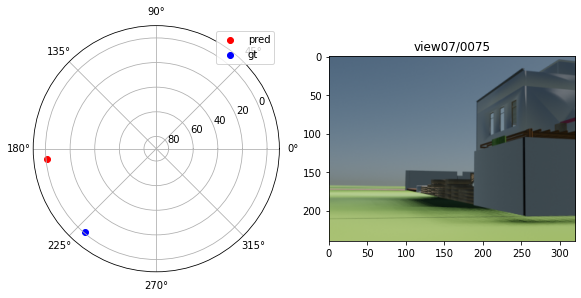

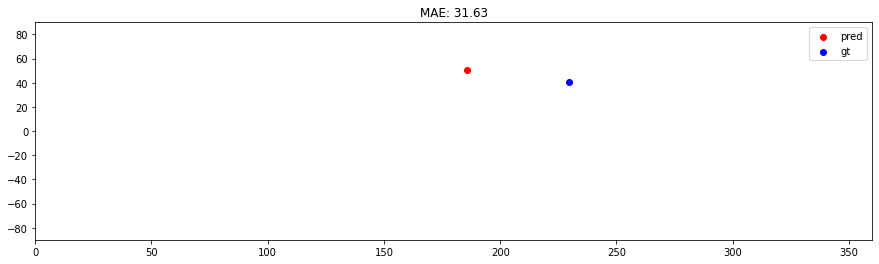

[76] angular error :  26.332604625585933
gt: 231.28, 39.64
pred: 196.88, 50.62


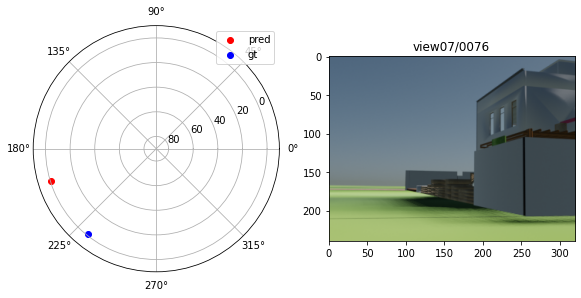

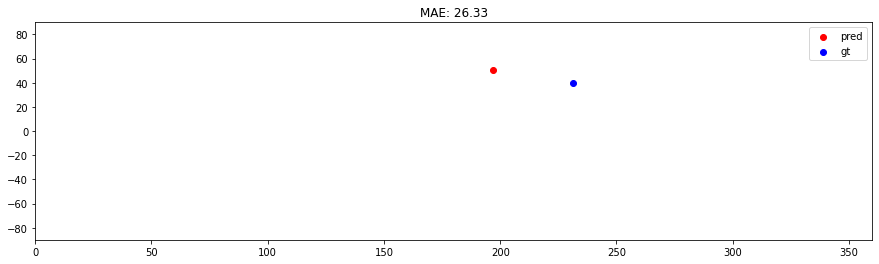

[77] angular error :  28.130710441301265
gt: 233.08, 38.51
pred: 196.88, 50.62


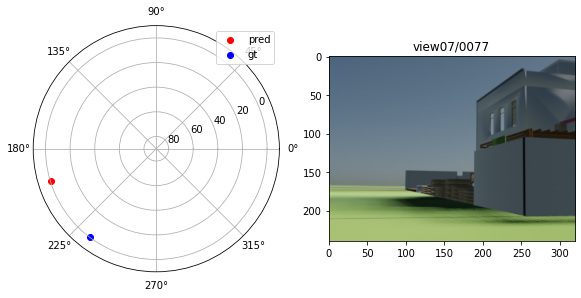

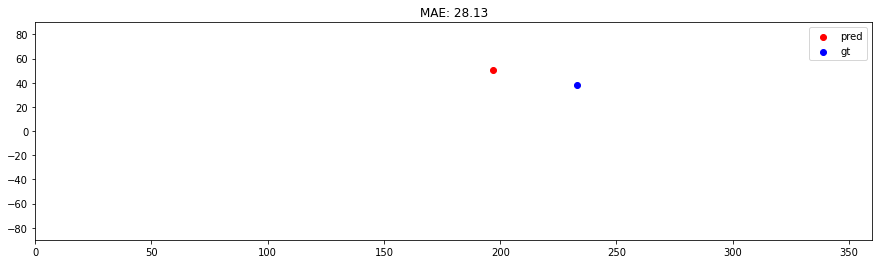

[78] angular error :  29.928936440453917
gt: 234.82, 37.35
pred: 196.88, 50.62


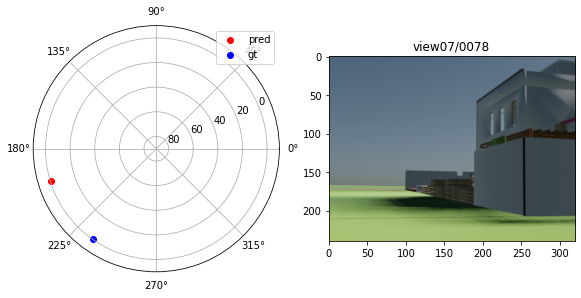

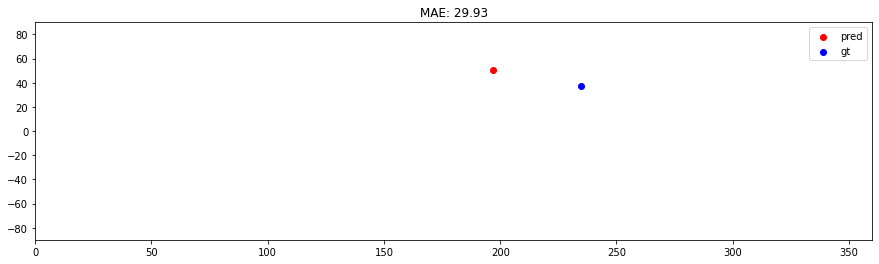

[79] angular error :  31.727250003936028
gt: 236.51, 36.16
pred: 196.88, 50.62


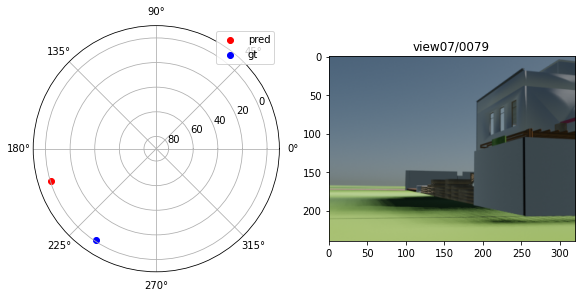

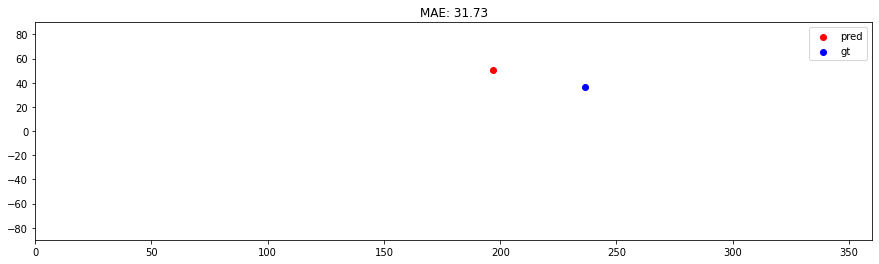

[80] angular error :  33.52562240569445
gt: 238.15, 34.95
pred: 196.88, 50.62


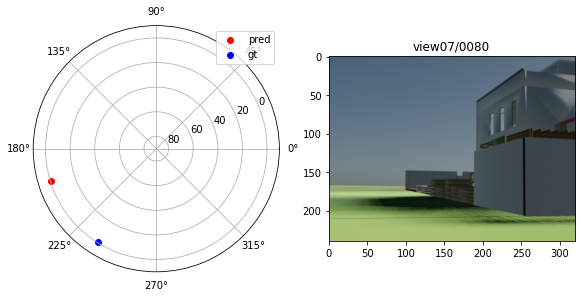

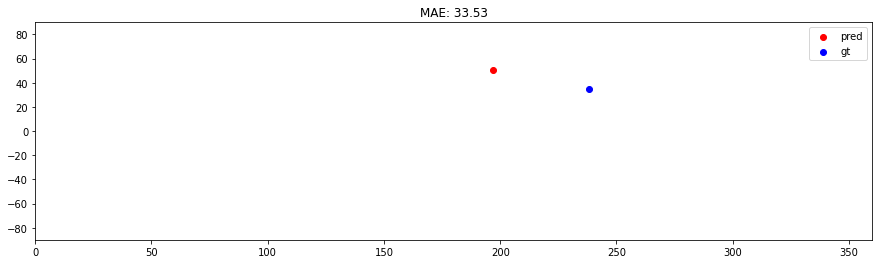

[81] angular error :  35.32403267040346
gt: 239.74, 33.73
pred: 196.88, 50.62


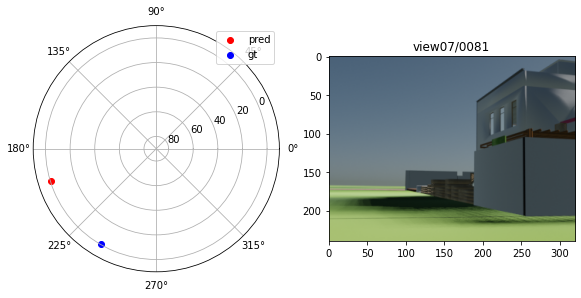

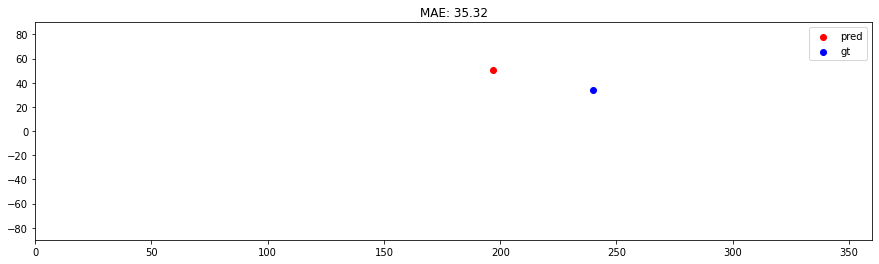

[82] angular error :  30.33670647513827
gt: 241.29, 32.48
pred: 208.12, 50.62


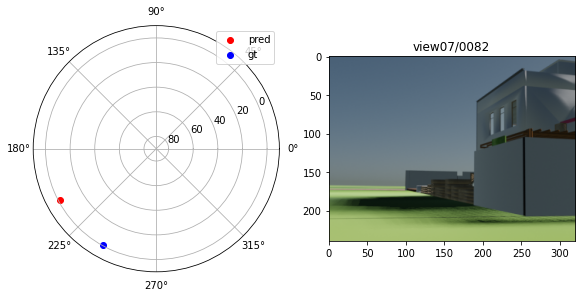

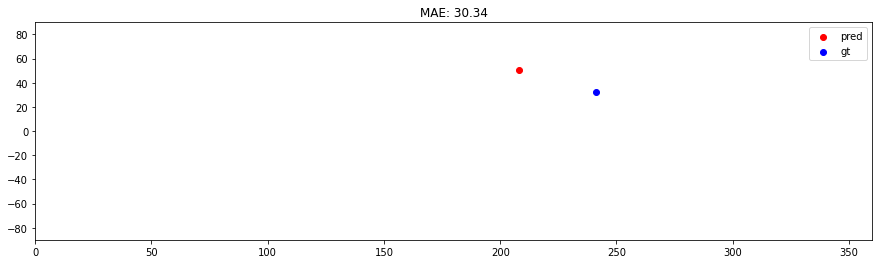

[83] angular error :  32.13464285079821
gt: 242.79, 31.21
pred: 208.12, 50.62


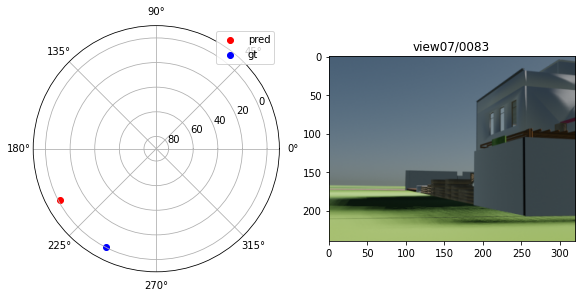

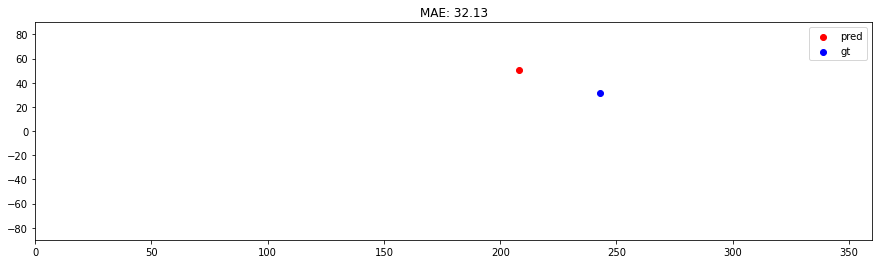

[84] angular error :  33.93261174812536
gt: 244.26, 29.92
pred: 208.12, 50.62


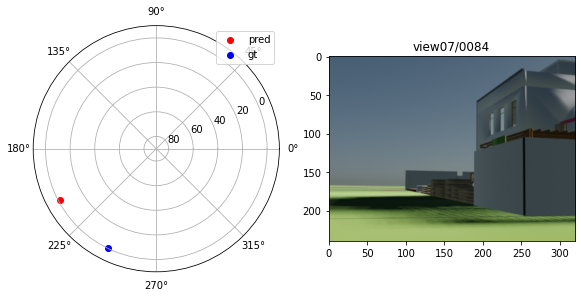

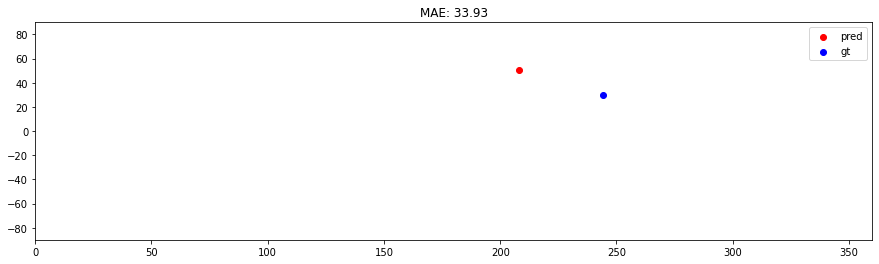

[85] angular error :  16.43247742747483
gt: 245.68, 28.62
pred: 230.62, 39.38


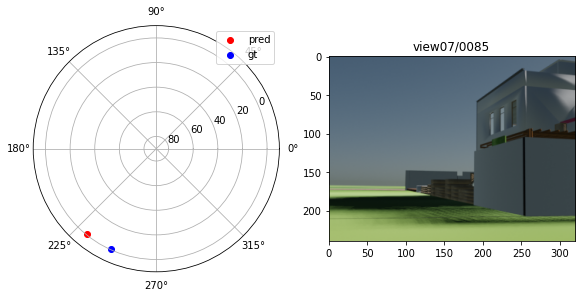

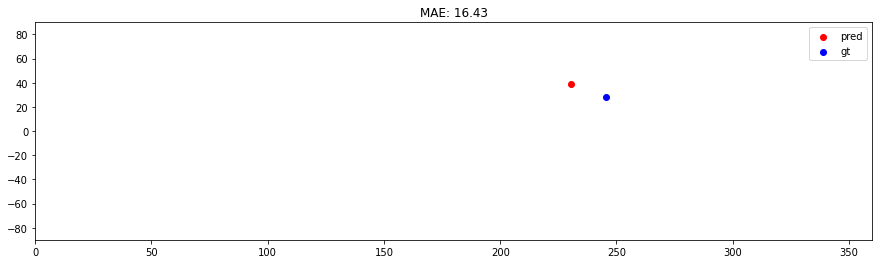

[86] angular error :  18.230574112836845
gt: 247.07, 27.31
pred: 230.62, 39.38


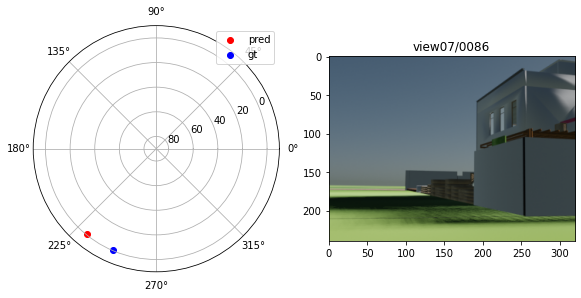

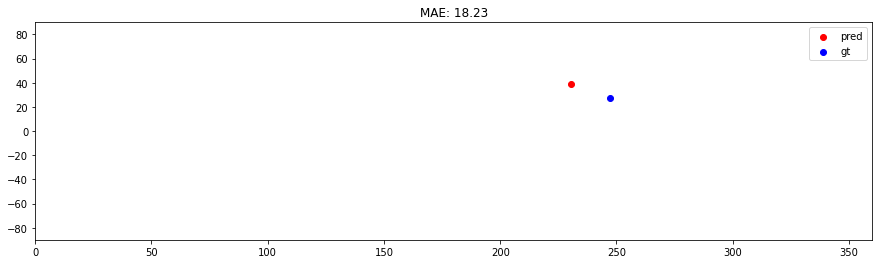

[87] angular error :  20.02868129136351
gt: 248.43, 25.98
pred: 230.62, 39.38


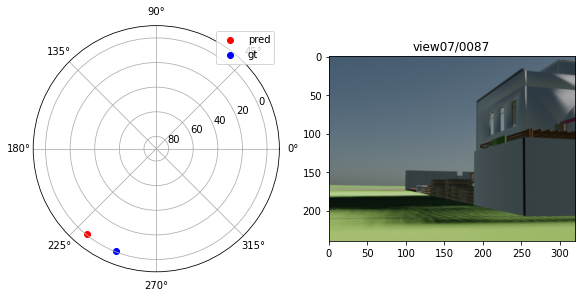

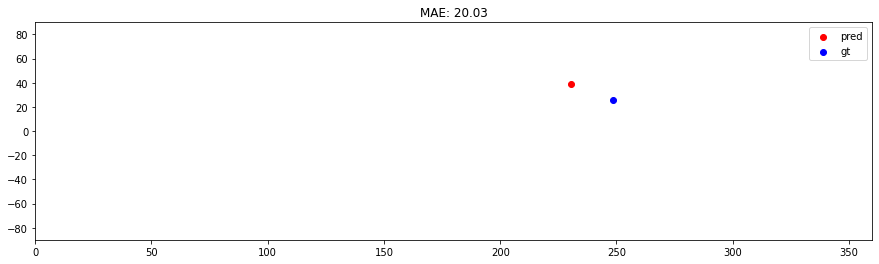

[88] angular error :  21.826743849743483
gt: 249.76, 24.64
pred: 230.62, 39.38


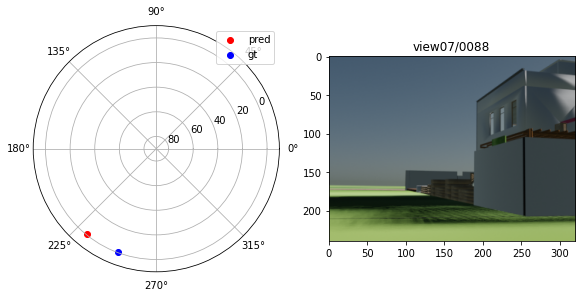

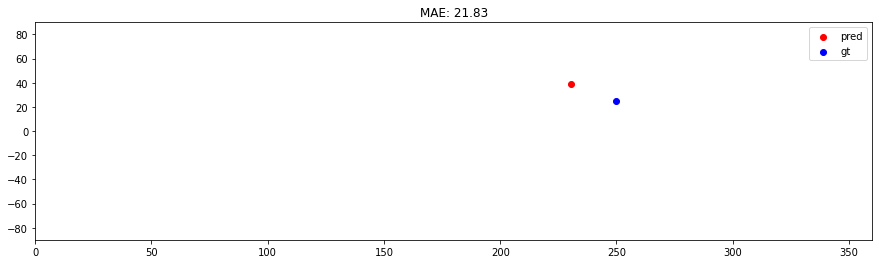

[89] angular error :  23.624708906513096
gt: 251.06, 23.29
pred: 230.62, 39.38


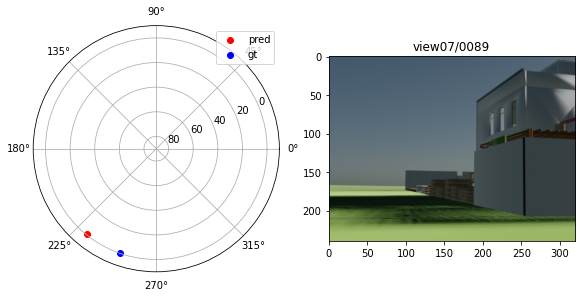

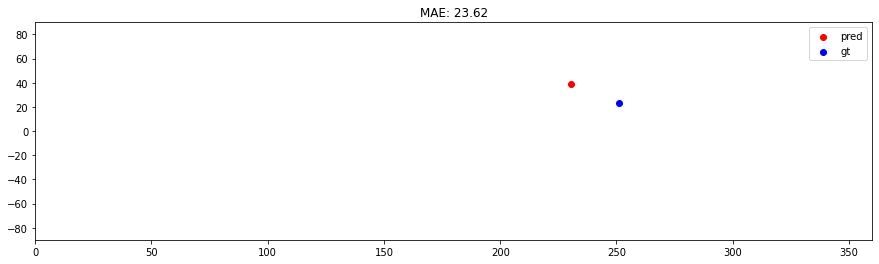

[90] angular error :  25.4225225248482
gt: 252.33, 21.93
pred: 230.62, 39.38


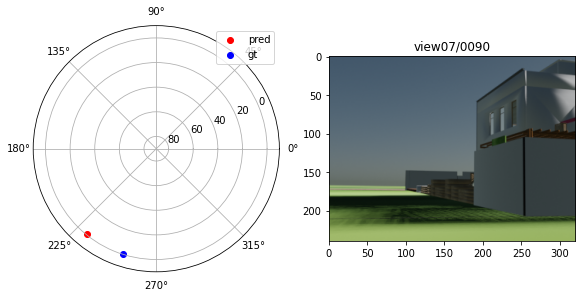

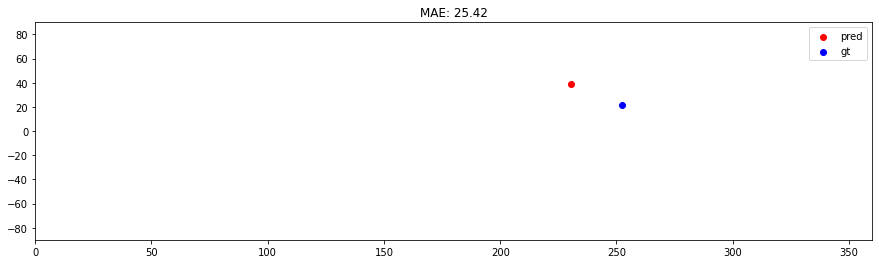

[91] angular error :  27.220129345470706
gt: 253.58, 20.56
pred: 230.62, 39.38


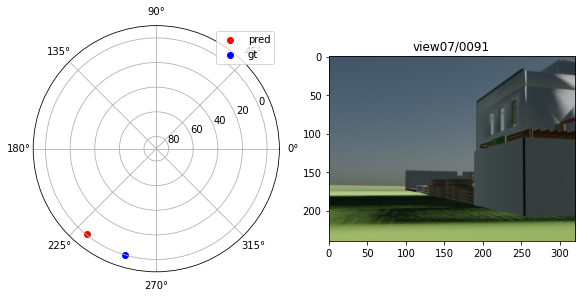

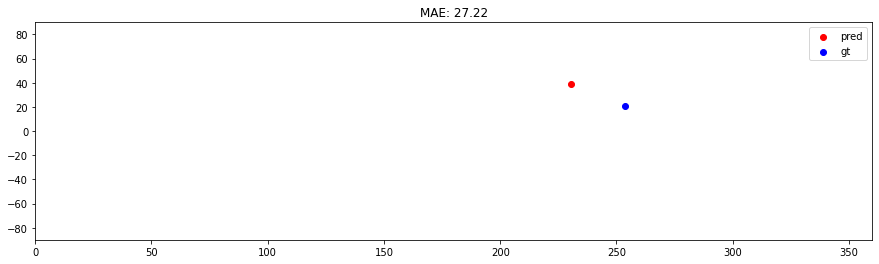

[92] angular error :  29.01745834966714
gt: 254.81, 19.18
pred: 230.62, 39.38


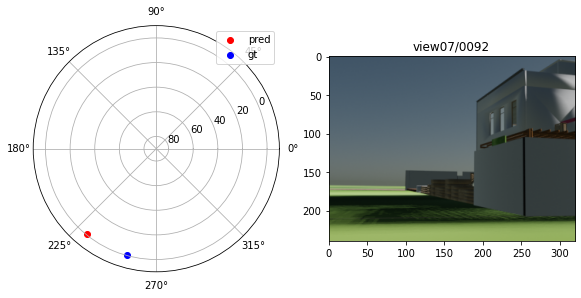

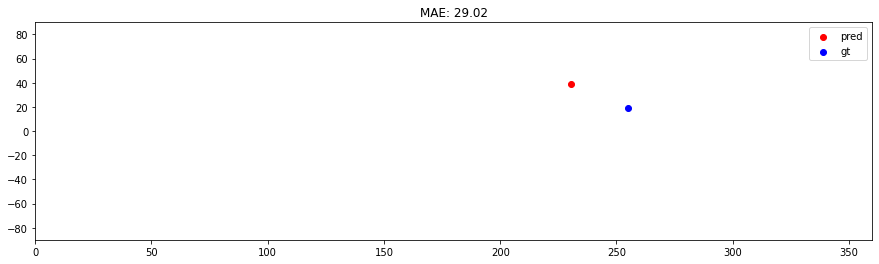

[93] angular error :  30.814432994404825
gt: 256.01, 17.79
pred: 230.62, 39.38


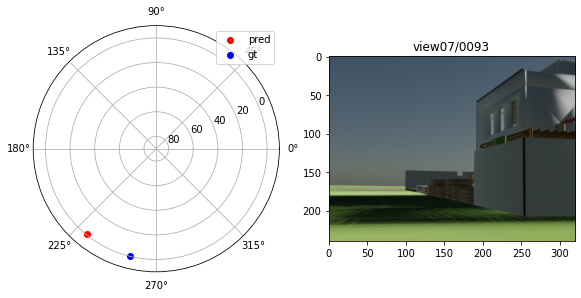

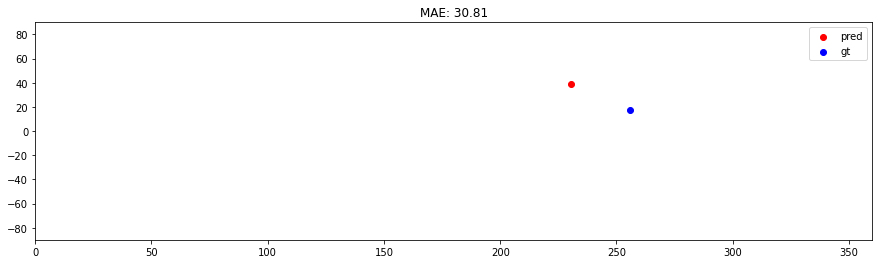

[94] angular error :  32.61094928820627
gt: 257.20, 16.40
pred: 230.62, 39.38


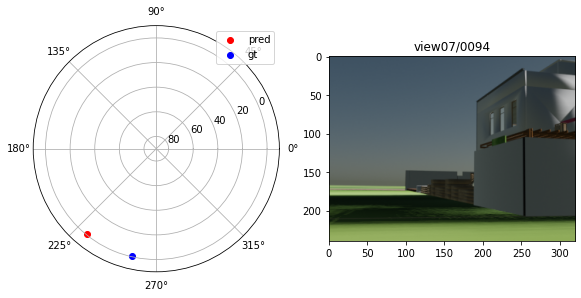

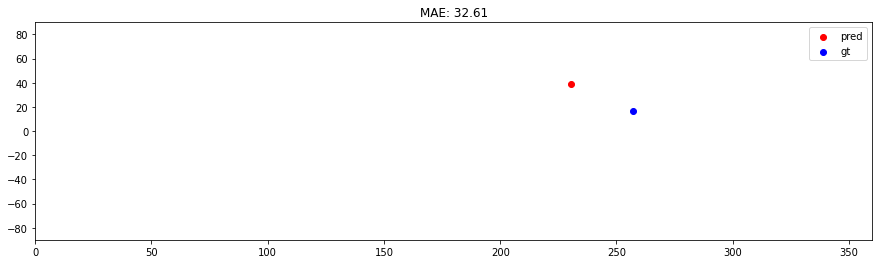

[95] angular error :  34.406866283958465
gt: 258.37, 15.00
pred: 230.62, 39.38


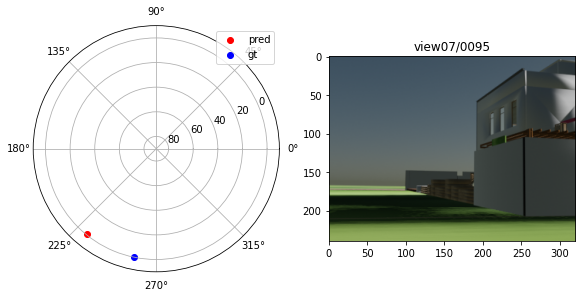

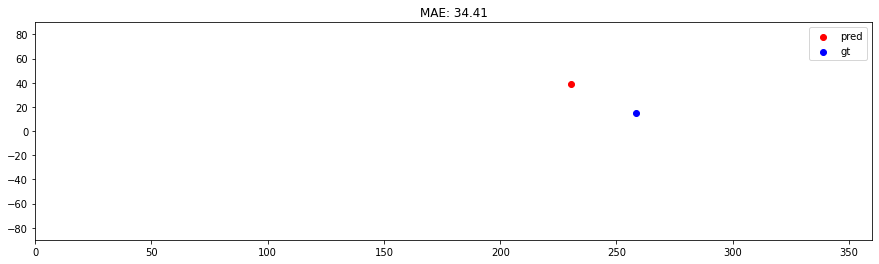

[96] angular error :  36.202003494028666
gt: 259.52, 13.60
pred: 230.62, 39.38


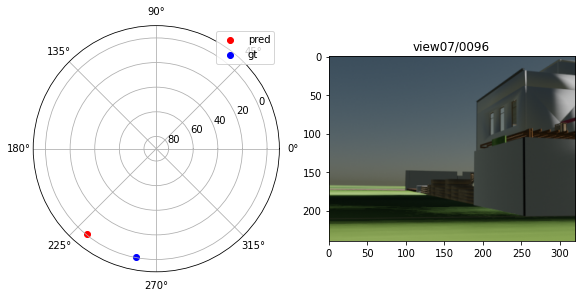

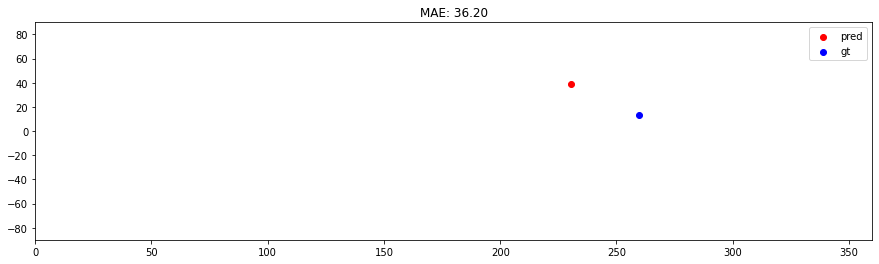

[97] angular error :  37.99609489178003
gt: 260.67, 12.19
pred: 230.62, 39.38


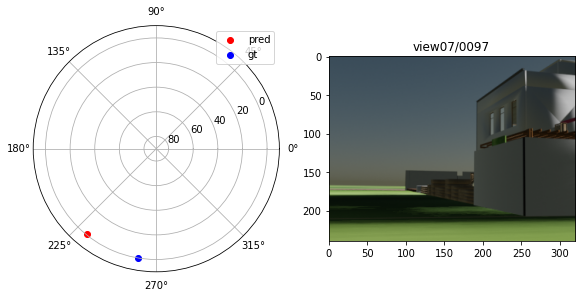

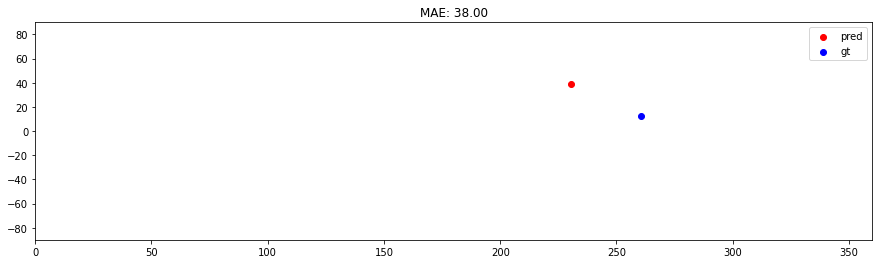

[98] angular error :  163.39384415528295
gt: 261.80, 10.78
pred: 84.38, 5.62


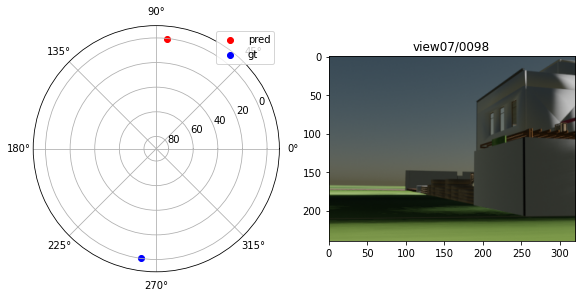

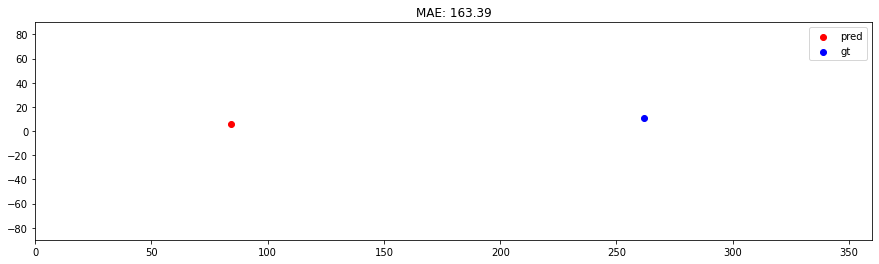

[99] angular error :  164.93503910020792
gt: 262.91, 9.37
pred: 84.38, 5.62


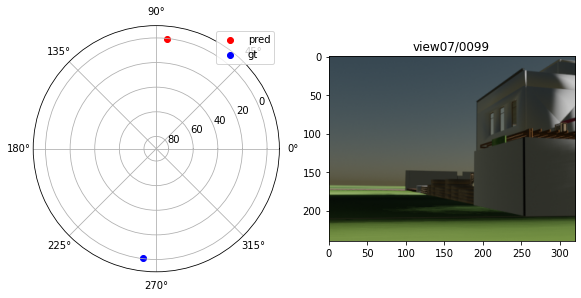

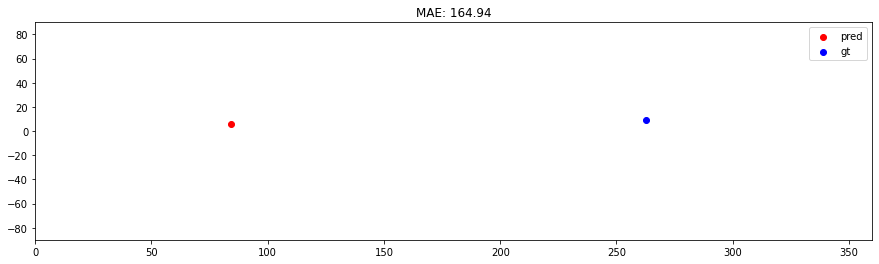

[100] angular error :  13.596391277942029
gt: 84.18, -7.97
pred: 84.38, 5.62


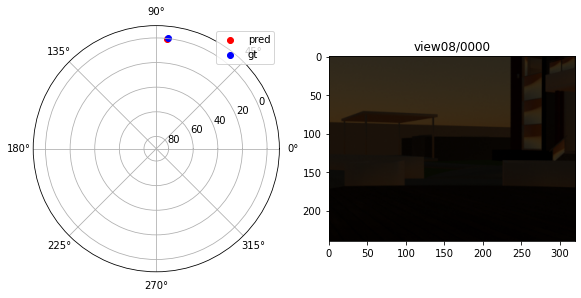

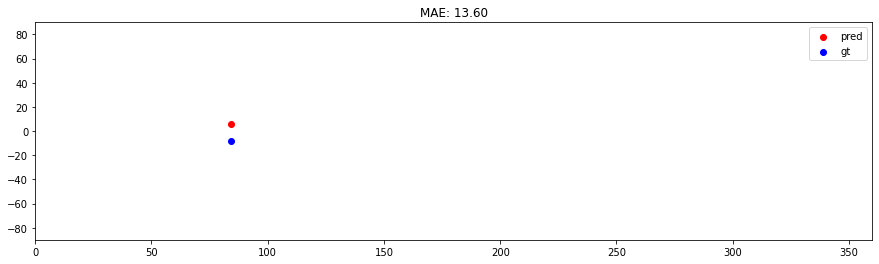

[101] angular error :  12.18629564535478
gt: 85.28, -6.53
pred: 84.38, 5.62


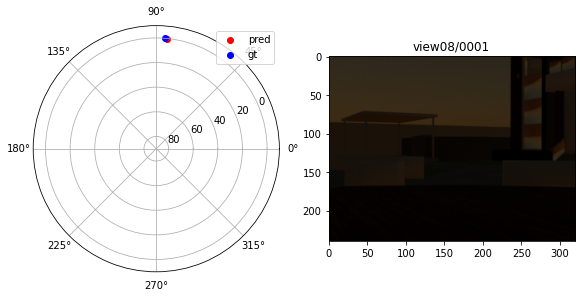

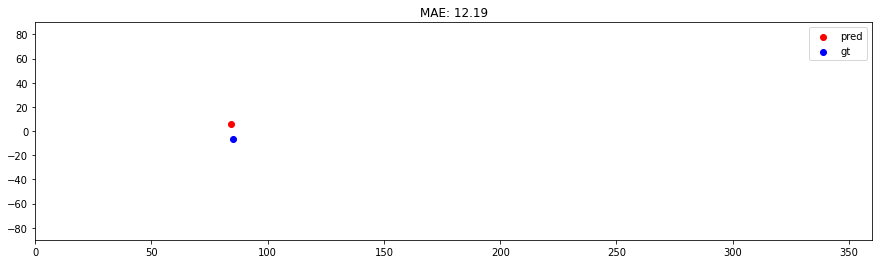

[102] angular error :  10.88746000288399
gt: 86.37, -5.08
pred: 84.38, 5.62


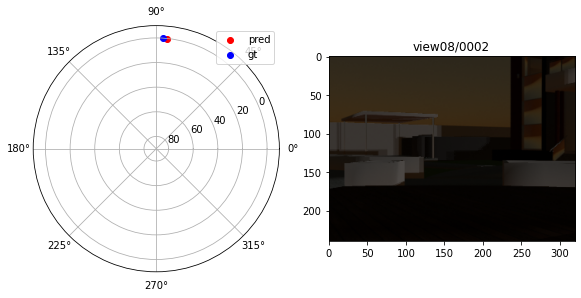

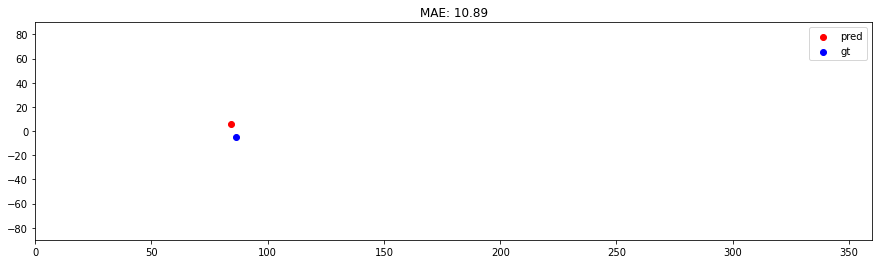

[103] angular error :  9.741163980205641
gt: 87.46, -3.62
pred: 84.38, 5.62


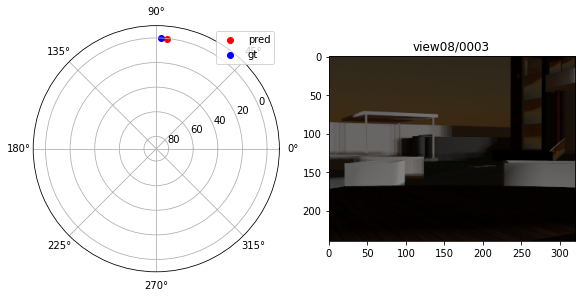

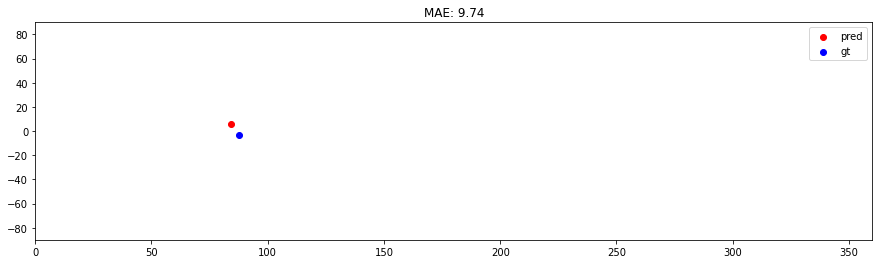

[104] angular error :  8.794301712554413
gt: 88.54, -2.12
pred: 84.38, 5.62


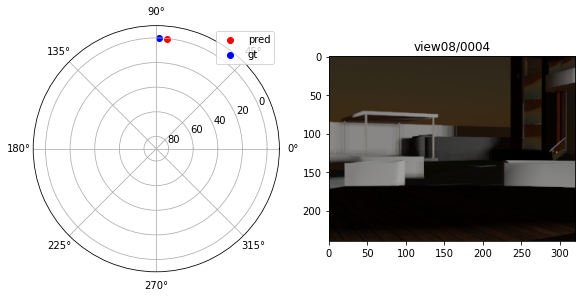

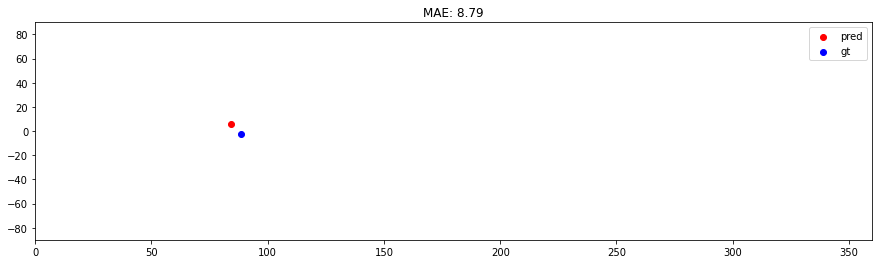

[105] angular error :  8.008899126775619
gt: 89.62, -0.43
pred: 84.38, 5.62


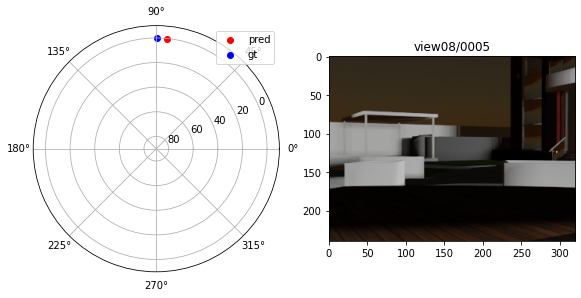

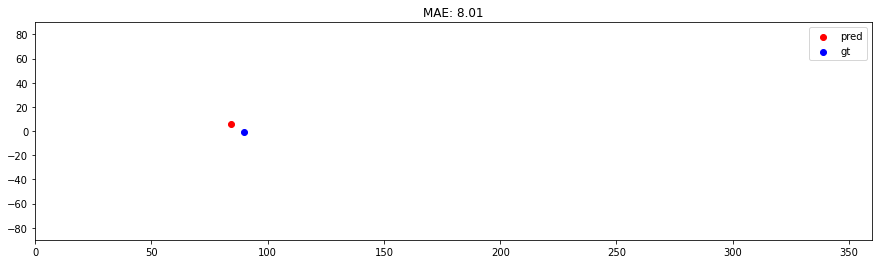

[106] angular error :  7.822715012174097
gt: 90.71, 1.01
pred: 84.38, 5.62


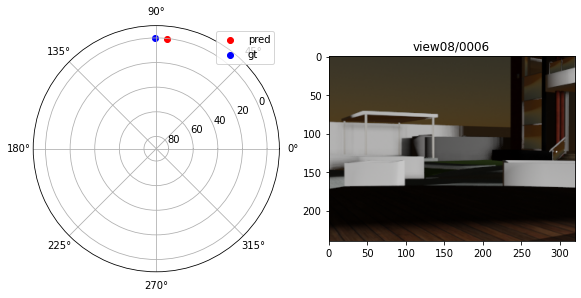

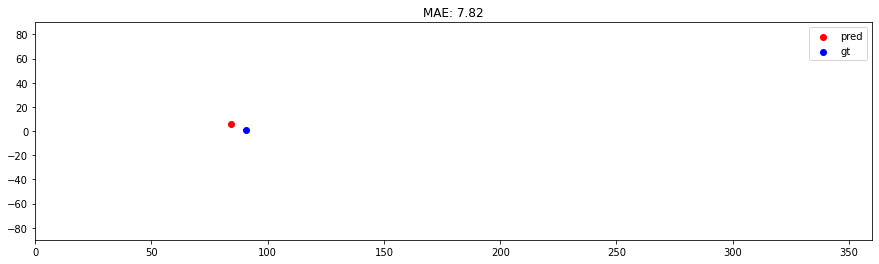

[107] angular error :  8.096629151534508
gt: 91.79, 2.33
pred: 84.38, 5.62


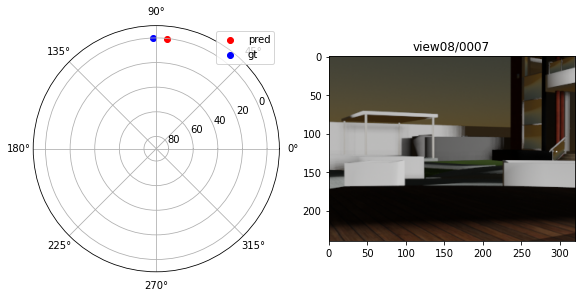

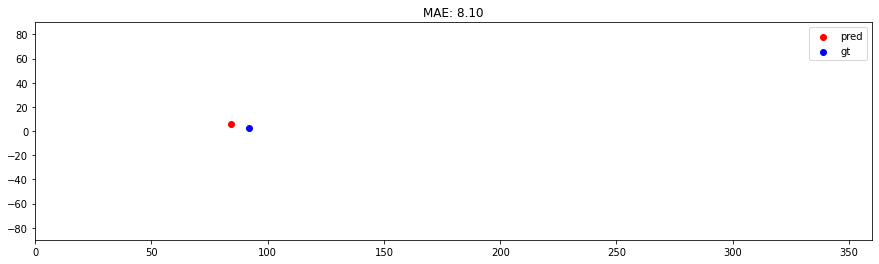

[108] angular error :  8.68787983013218
gt: 92.87, 3.69
pred: 84.38, 5.62


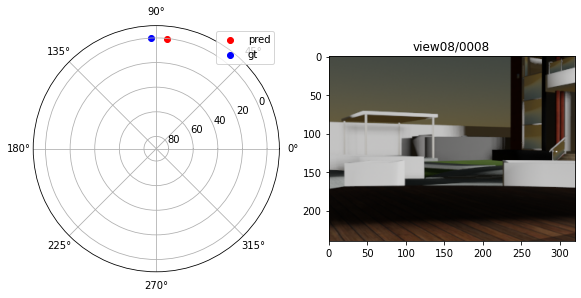

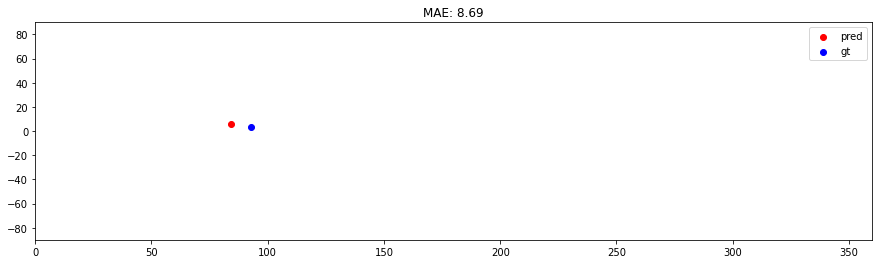

[109] angular error :  9.560781098030294
gt: 93.96, 5.08
pred: 84.38, 5.62


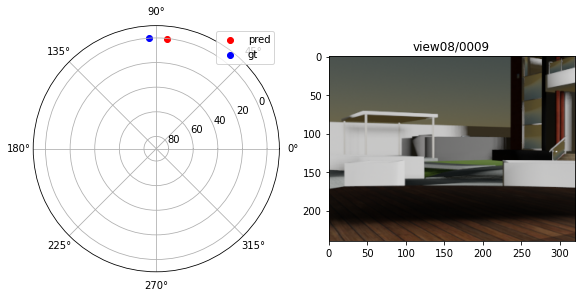

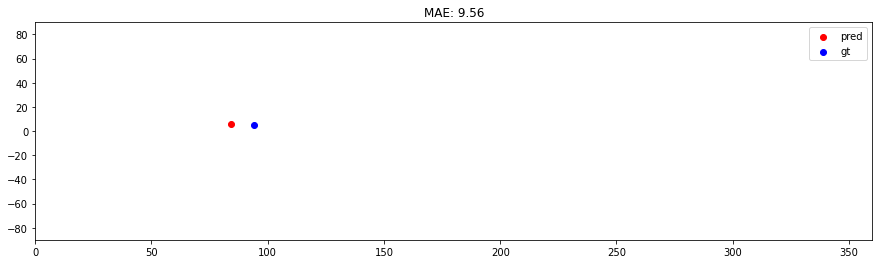

[110] angular error :  10.655825559925558
gt: 95.06, 6.49
pred: 84.38, 5.62


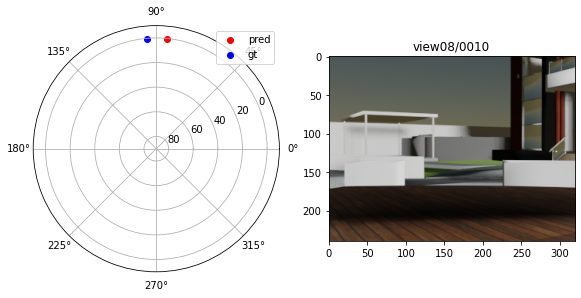

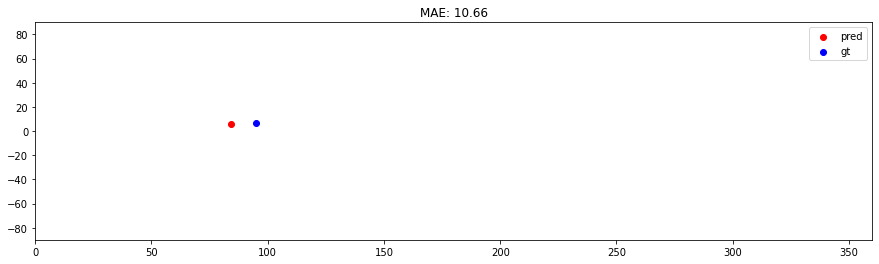

[111] angular error :  162.08332599664595
gt: 96.15, 7.90
pred: 264.38, 5.62


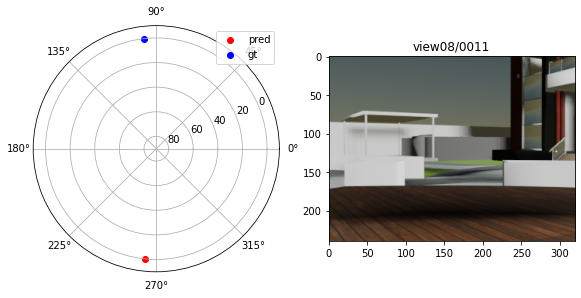

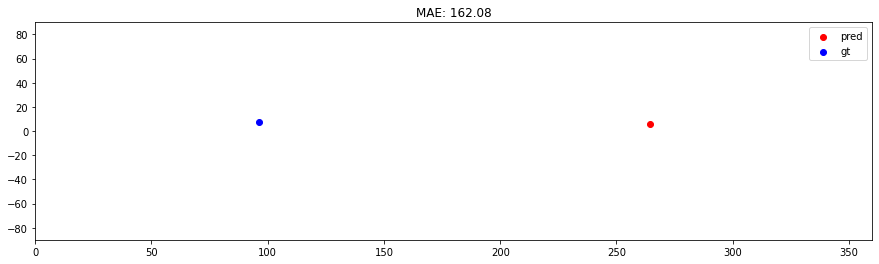

[112] angular error :  160.29896871086075
gt: 97.26, 9.31
pred: 264.38, 5.62


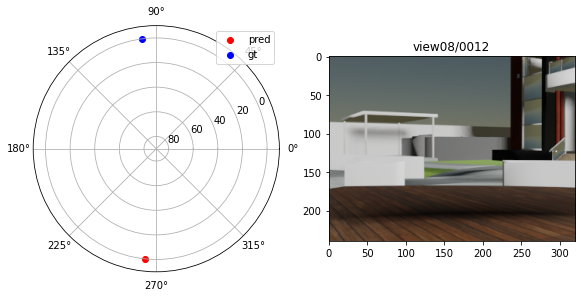

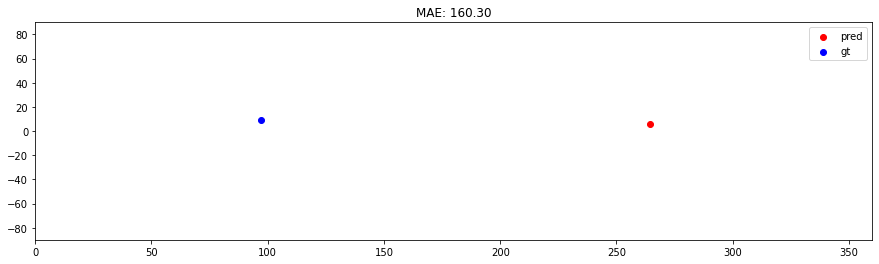

[113] angular error :  158.51123873043272
gt: 98.38, 10.73
pred: 264.38, 5.62


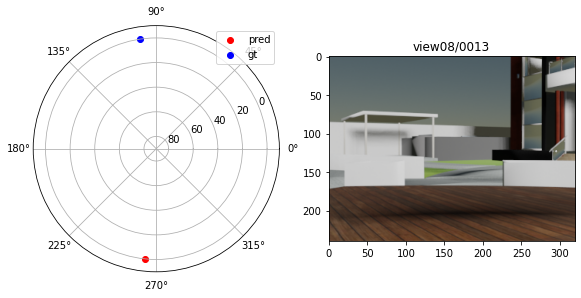

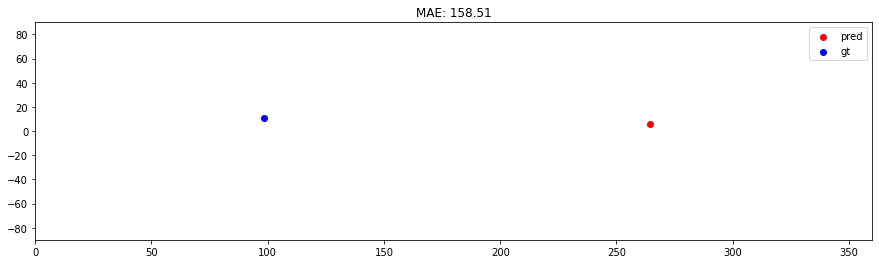

[114] angular error :  156.72109946899766
gt: 99.51, 12.14
pred: 264.38, 5.62


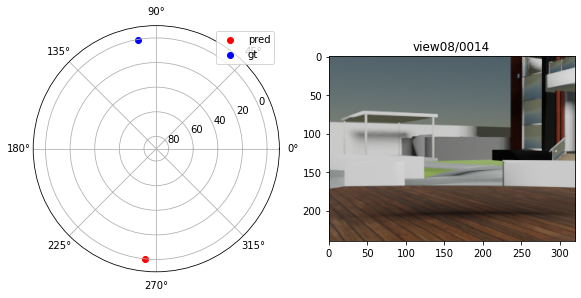

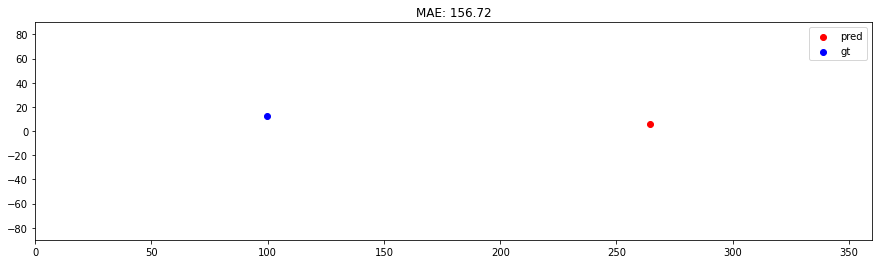

[115] angular error :  145.59357940135425
gt: 100.64, 13.55
pred: 264.38, 16.88


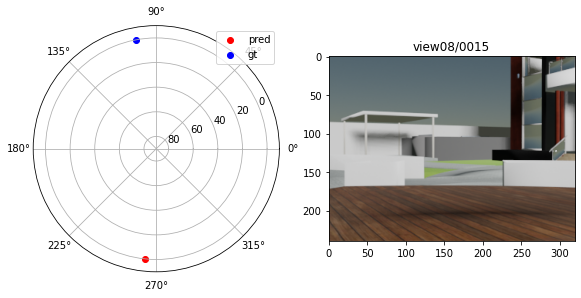

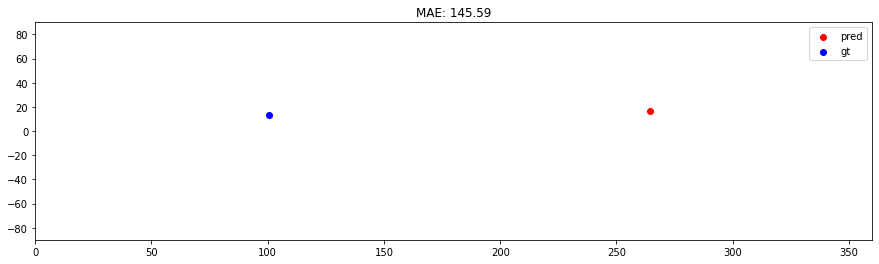

[116] angular error :  143.82453458428623
gt: 101.80, 14.95
pred: 264.38, 16.88


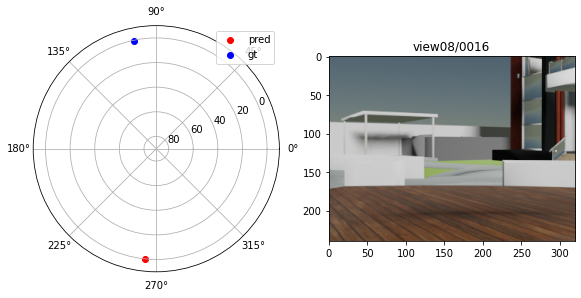

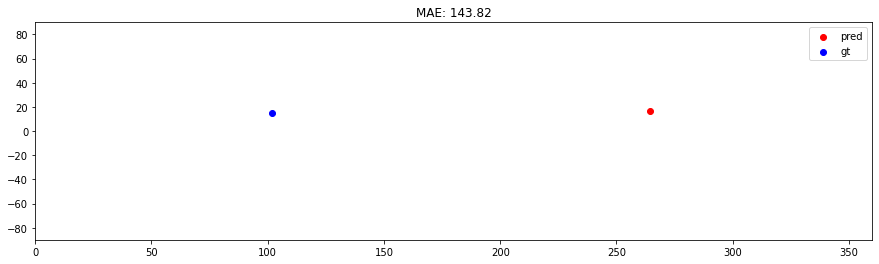

[117] angular error :  142.05246104623836
gt: 102.96, 16.35
pred: 264.38, 16.88


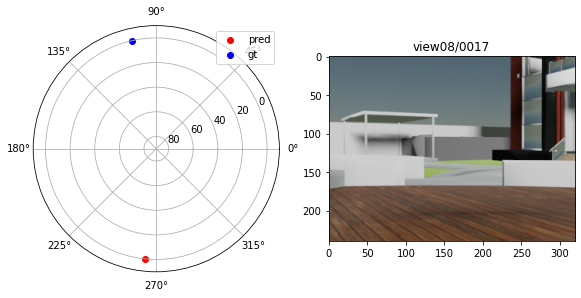

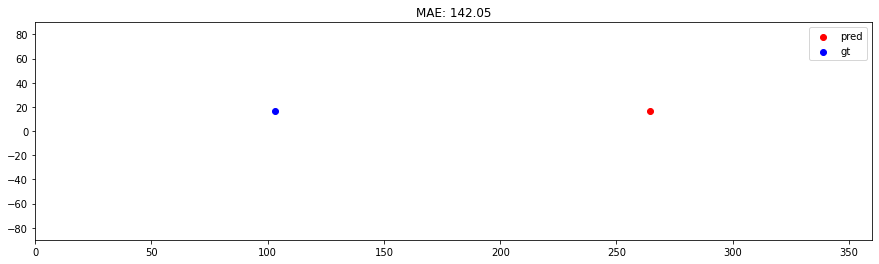

[118] angular error :  140.2778639706145
gt: 104.15, 17.75
pred: 264.38, 16.88


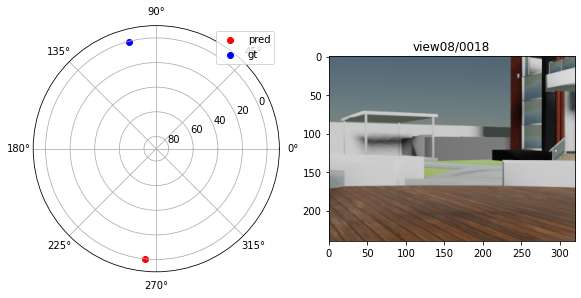

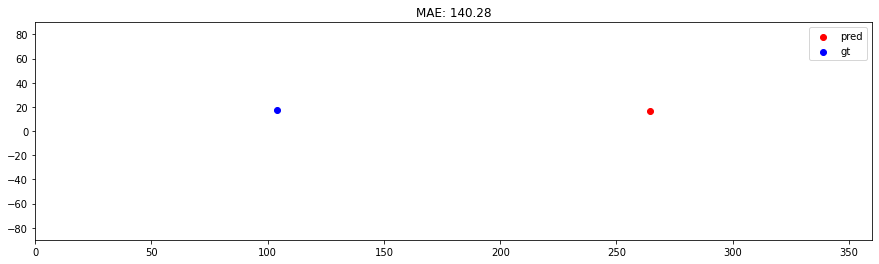

[119] angular error :  138.50113906380906
gt: 105.35, 19.14
pred: 264.38, 16.88


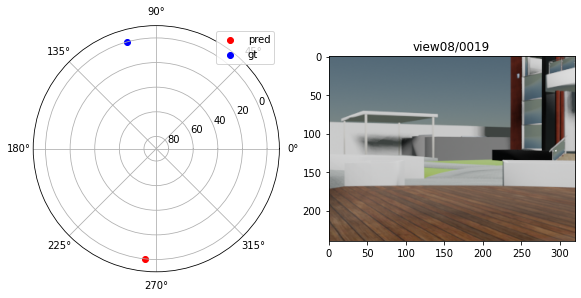

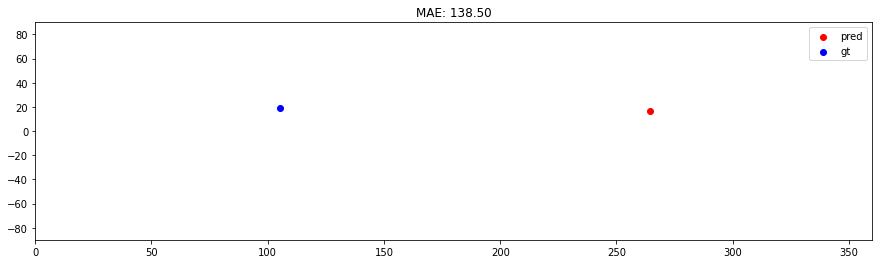

[120] angular error :  136.7226001025237
gt: 106.58, 20.52
pred: 264.38, 16.88


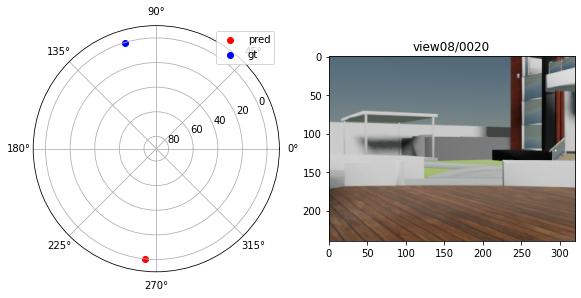

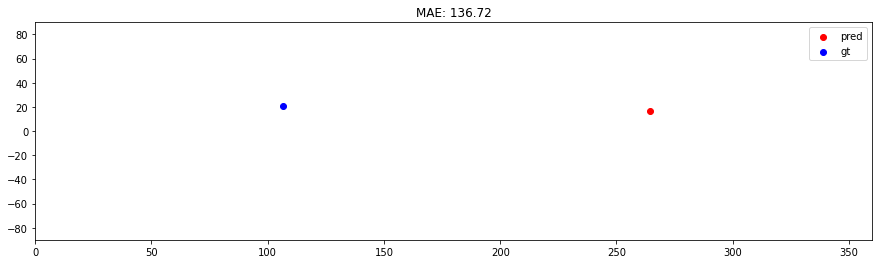

[121] angular error :  134.9425005739499
gt: 107.82, 21.89
pred: 264.38, 16.88


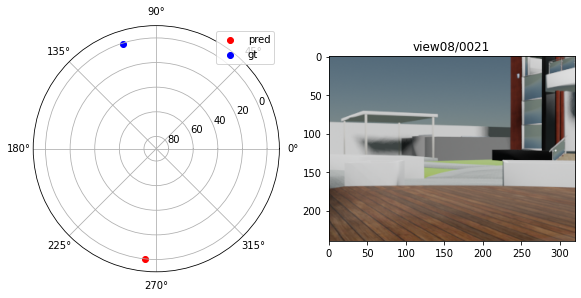

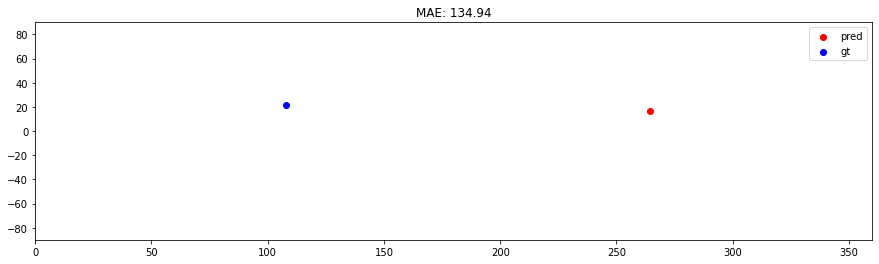

[122] angular error :  23.560356663971916
gt: 109.09, 23.25
pred: 129.38, 39.38


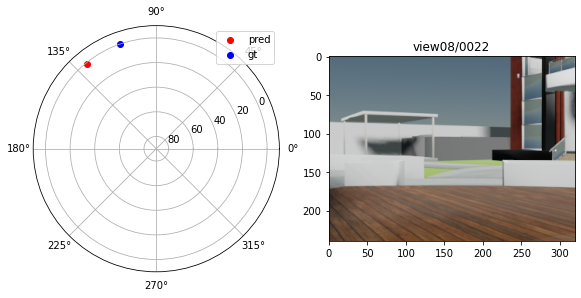

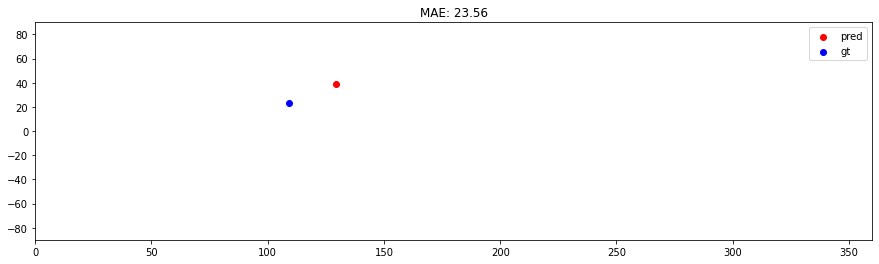

[123] angular error :  21.762297956180753
gt: 110.39, 24.60
pred: 129.38, 39.38


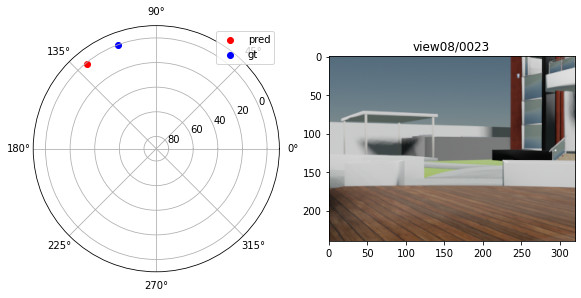

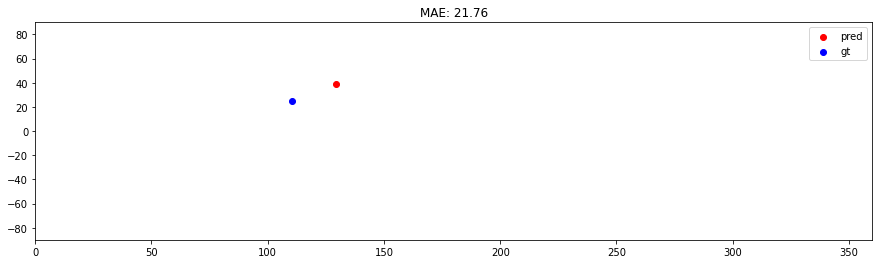

[124] angular error :  19.964113365573603
gt: 111.72, 25.95
pred: 129.38, 39.38


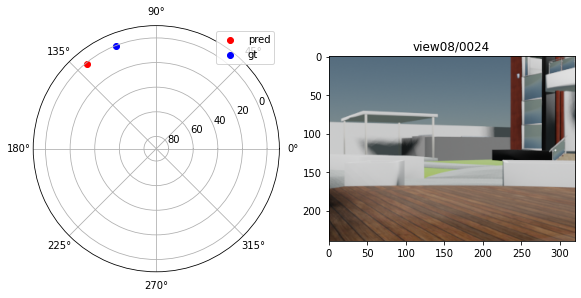

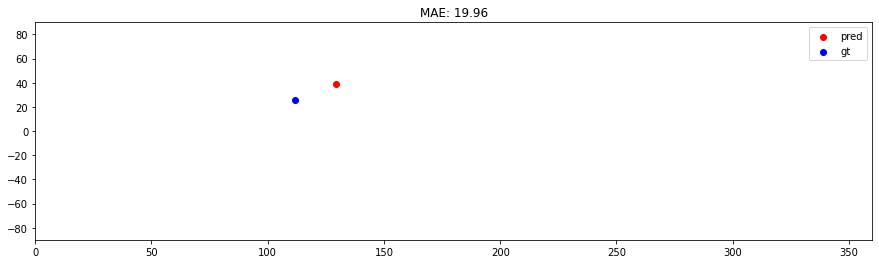

[125] angular error :  18.16585261129123
gt: 113.07, 27.27
pred: 129.38, 39.38


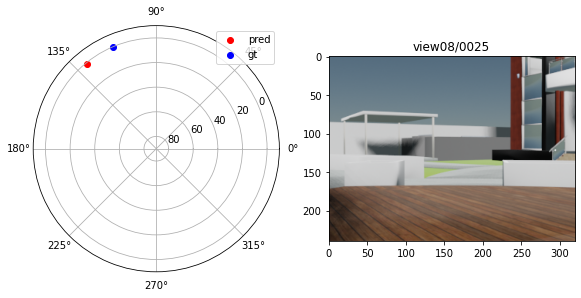

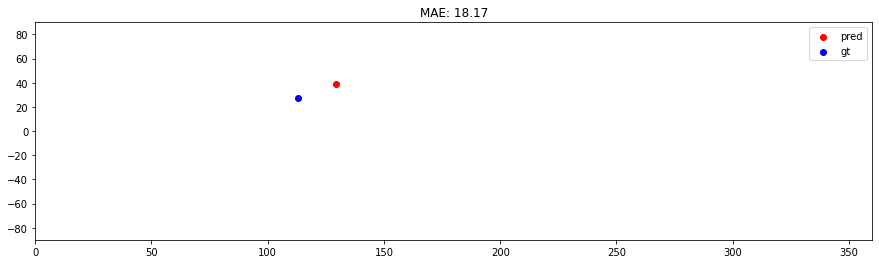

[126] angular error :  16.3675628516062
gt: 114.46, 28.59
pred: 129.38, 39.38


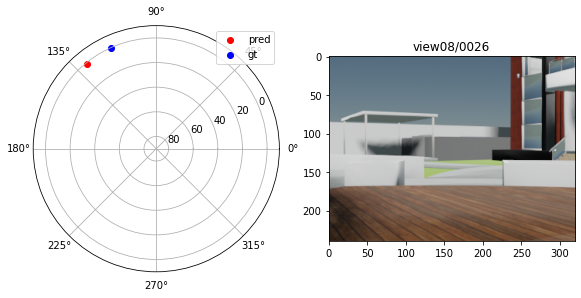

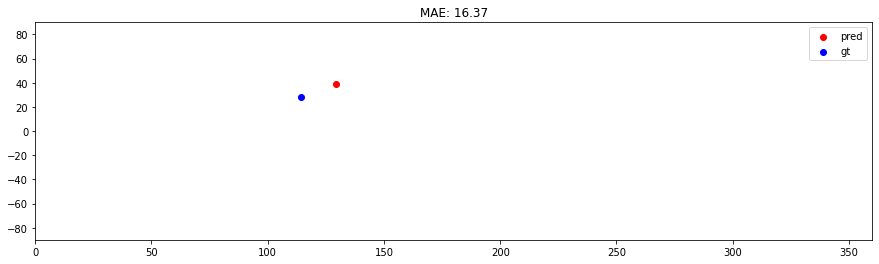

[127] angular error :  14.569303386688354
gt: 115.89, 29.89
pred: 129.38, 39.38


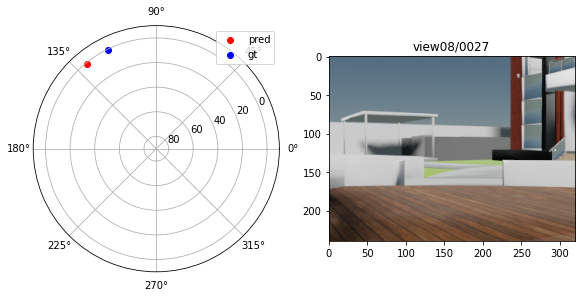

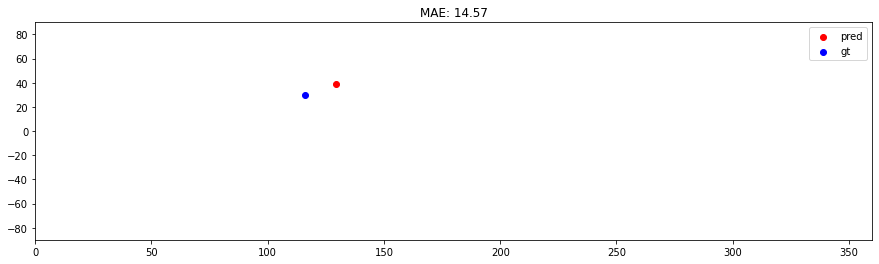

[128] angular error :  12.771148827216807
gt: 117.35, 31.18
pred: 129.38, 39.38


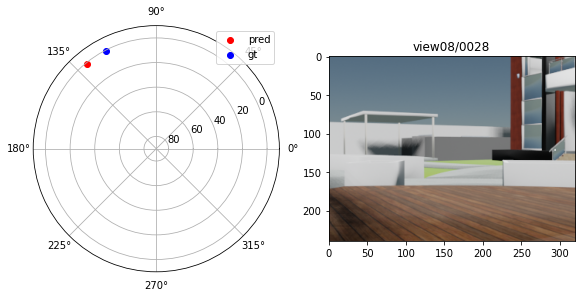

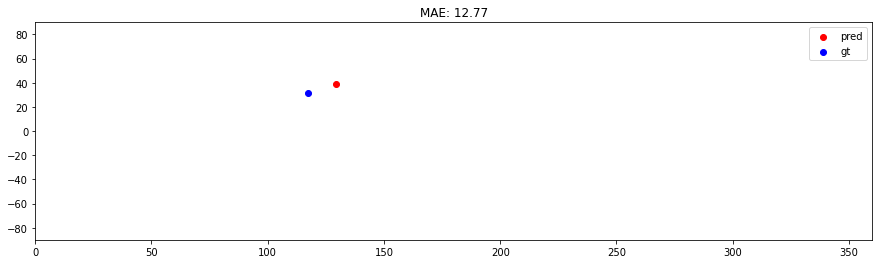

[129] angular error :  10.973214029681111
gt: 118.85, 32.44
pred: 129.38, 39.38


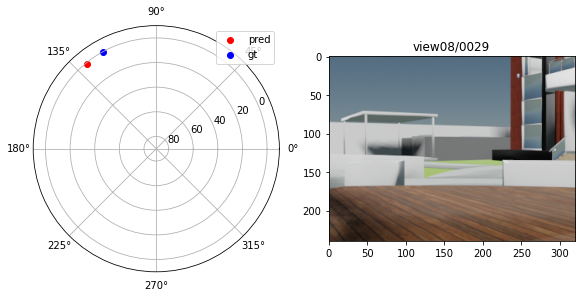

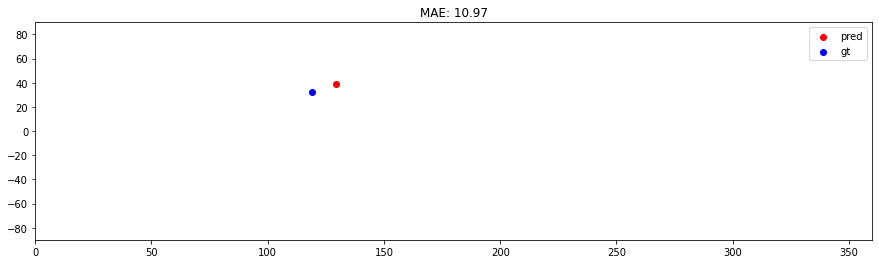

[130] angular error :  9.175688654679286
gt: 120.39, 33.69
pred: 129.38, 39.38


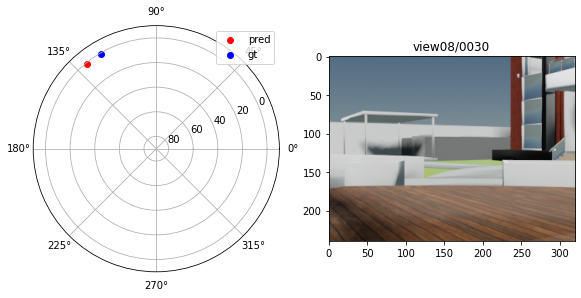

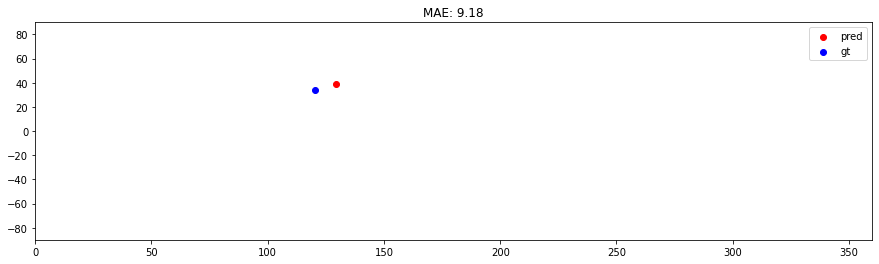

[131] angular error :  15.477874124298282
gt: 121.98, 34.93
pred: 140.62, 39.38


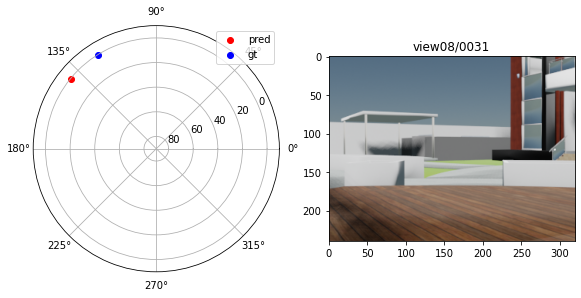

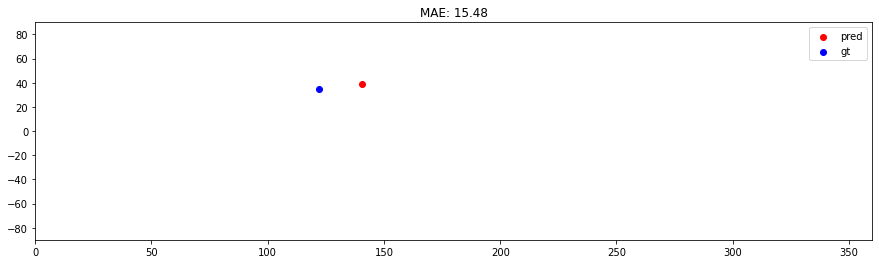

[132] angular error :  13.806374281010262
gt: 123.62, 36.13
pred: 140.62, 39.38


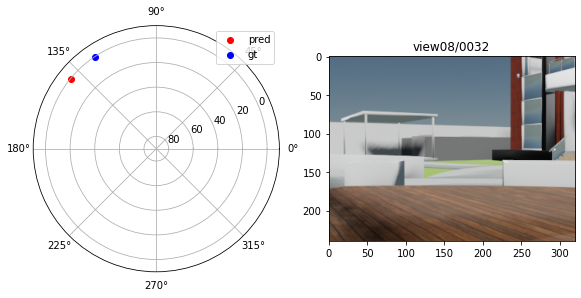

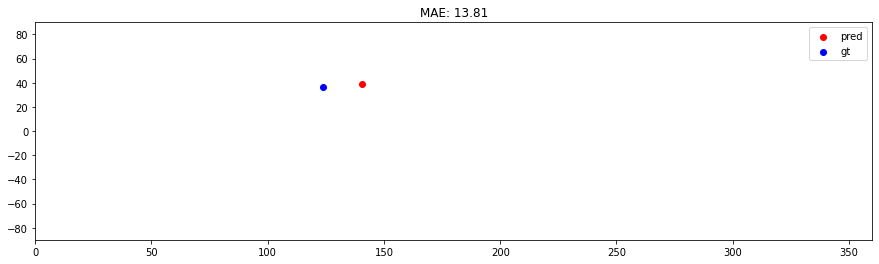

[133] angular error :  12.170524776669625
gt: 125.31, 37.32
pred: 140.62, 39.38


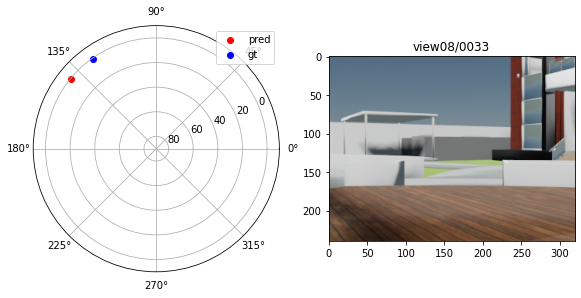

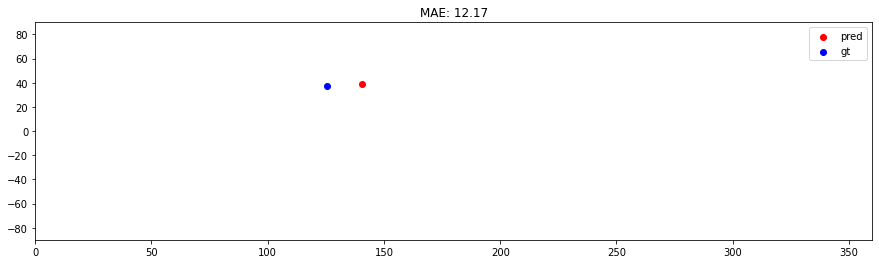

[134] angular error :  10.586905473679883
gt: 127.05, 38.48
pred: 140.62, 39.38


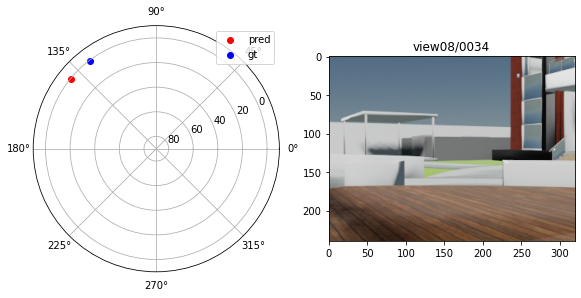

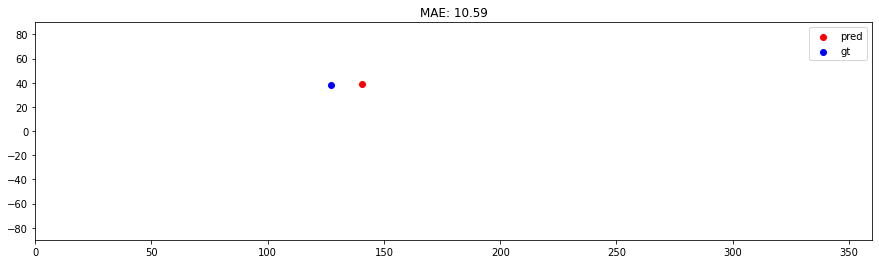

[135] angular error :  9.08291255937919
gt: 128.85, 39.62
pred: 140.62, 39.38


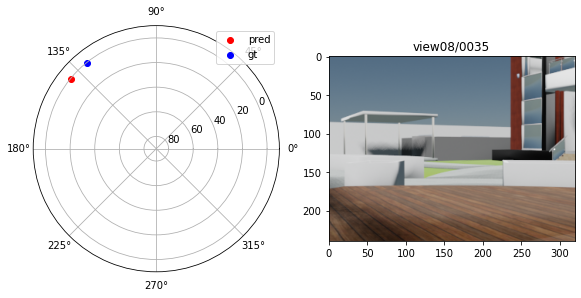

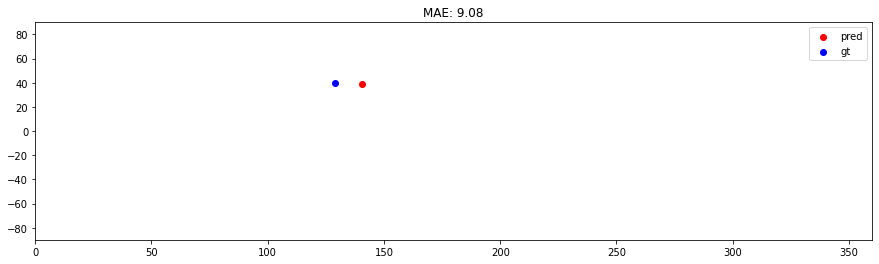

[136] angular error :  7.705346634778435
gt: 130.71, 40.72
pred: 140.62, 39.38


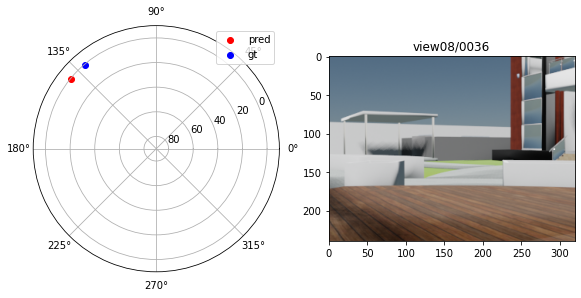

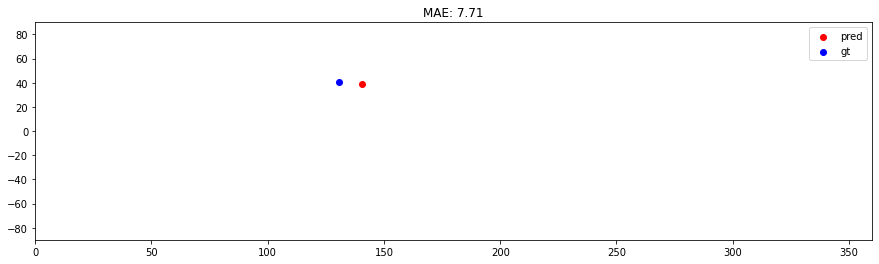

[137] angular error :  6.534696517110062
gt: 132.63, 41.80
pred: 140.62, 39.38


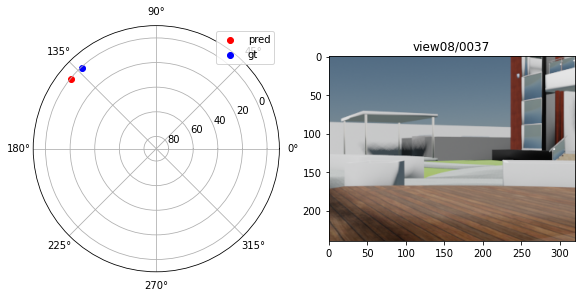

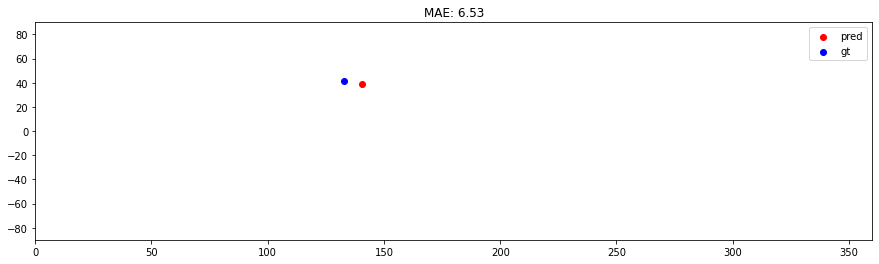

[138] angular error :  5.699946917566195
gt: 134.61, 42.84
pred: 140.62, 39.38


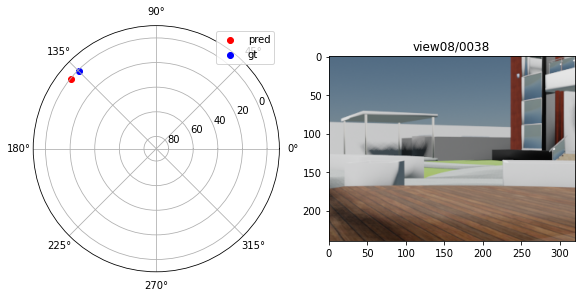

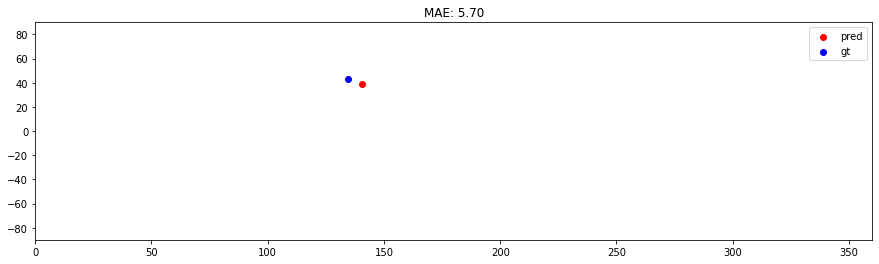

[139] angular error :  5.36042183873264
gt: 136.66, 43.85
pred: 140.62, 39.38


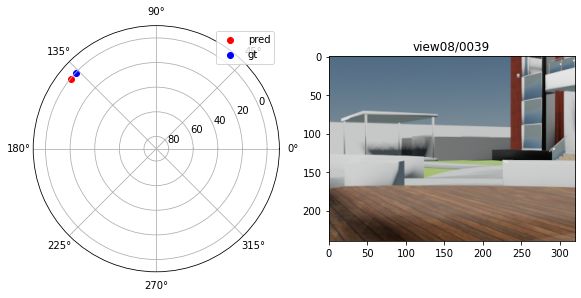

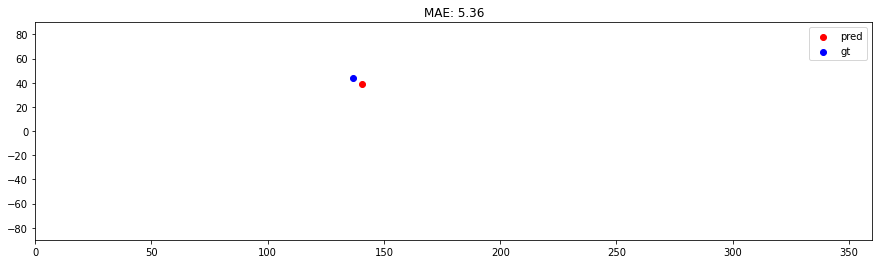

[140] angular error :  5.606848038821707
gt: 138.79, 44.81
pred: 140.62, 39.38


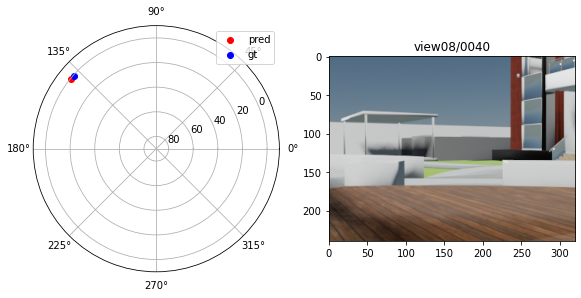

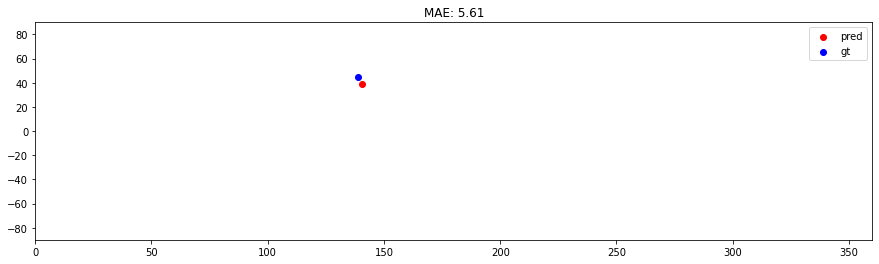

[141] angular error :  6.371613516844471
gt: 140.98, 45.74
pred: 140.62, 39.38


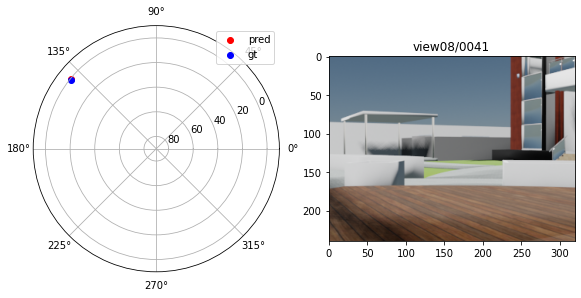

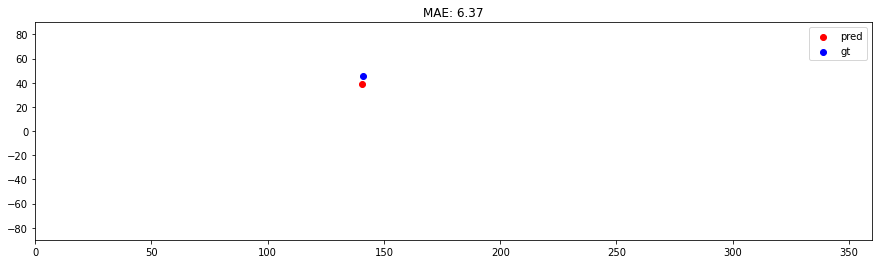

[142] angular error :  7.497765036234529
gt: 143.24, 46.63
pred: 140.62, 39.38


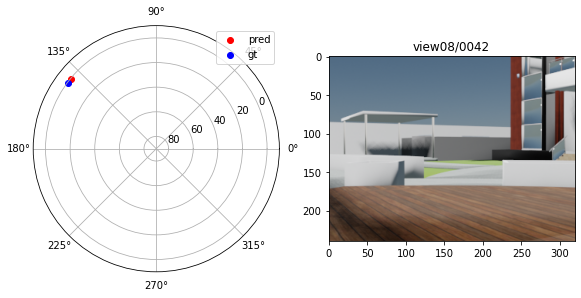

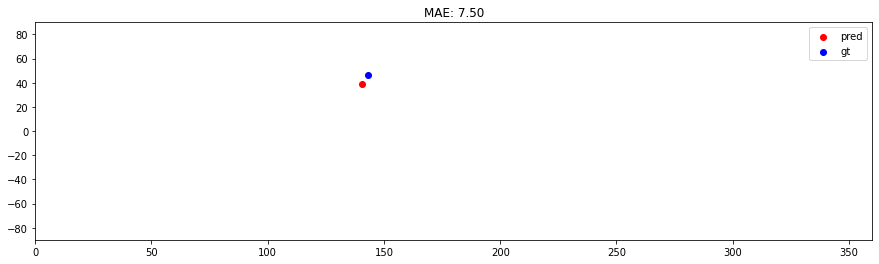

[143] angular error :  8.848388734324697
gt: 145.58, 47.46
pred: 140.62, 39.38


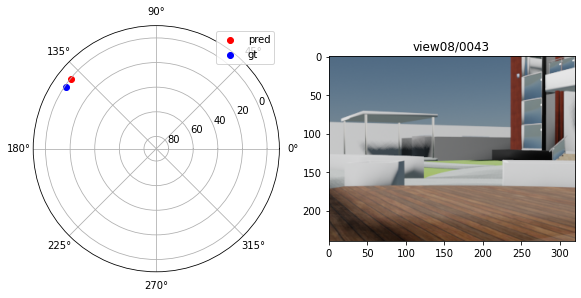

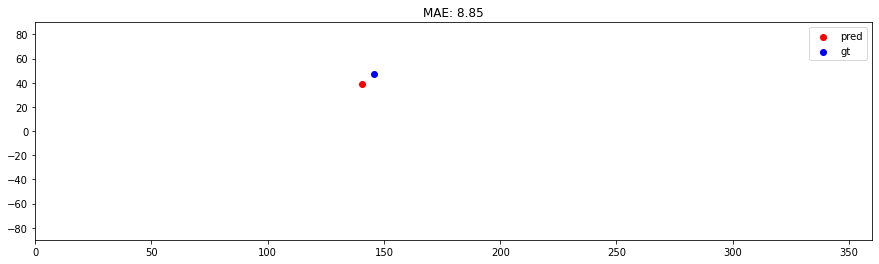

[144] angular error :  10.335860001573867
gt: 147.99, 48.25
pred: 140.62, 39.38


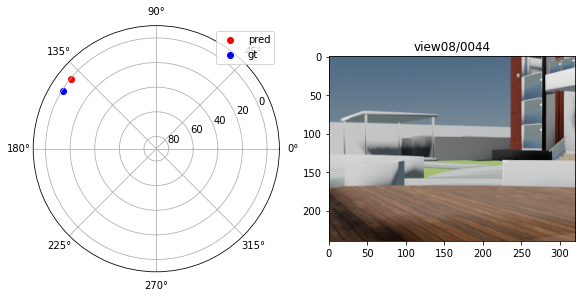

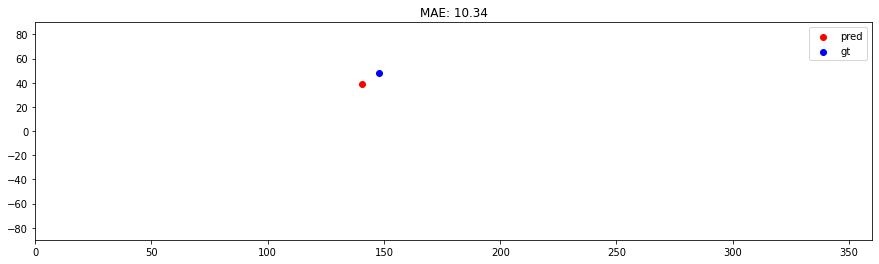

[145] angular error :  11.909017178529032
gt: 150.47, 48.99
pred: 140.62, 39.38


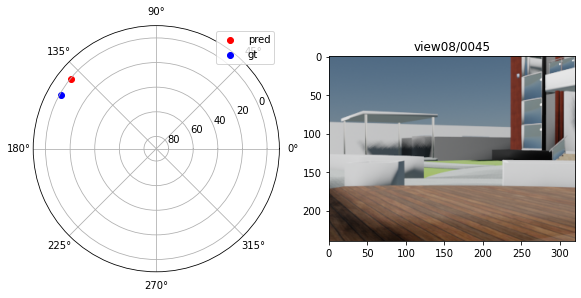

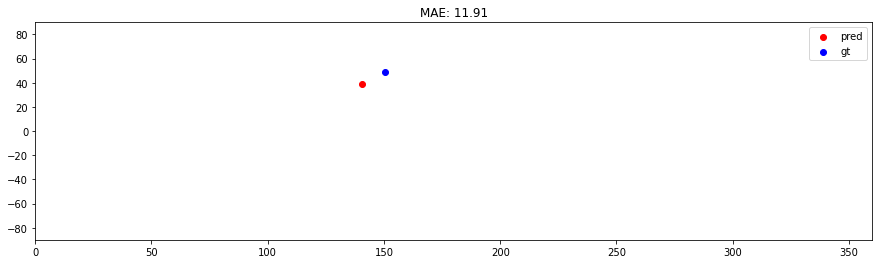

[146] angular error :  13.538021507525453
gt: 153.03, 49.67
pred: 140.62, 39.38


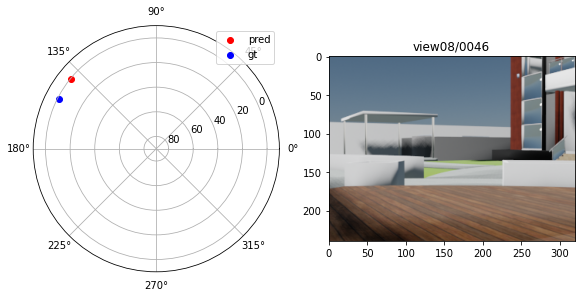

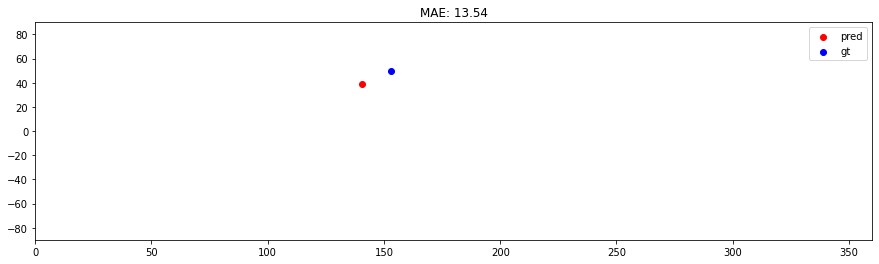

[147] angular error :  15.204933462052917
gt: 155.66, 50.30
pred: 140.62, 39.38


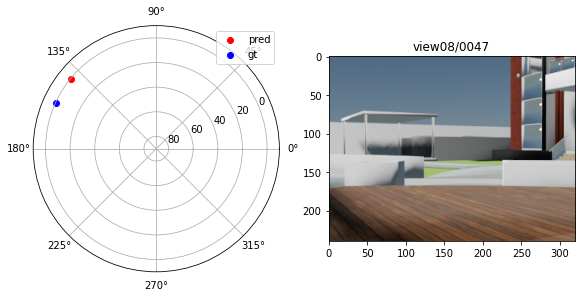

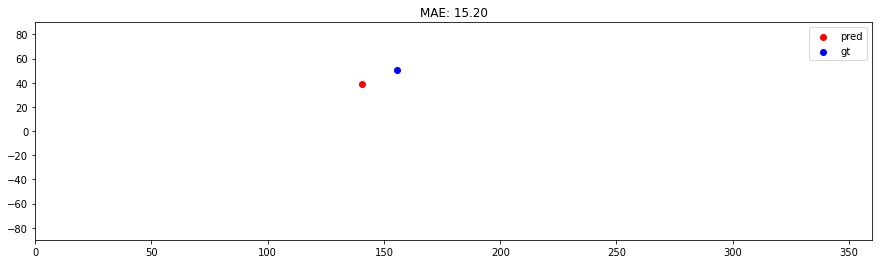

[148] angular error :  16.89853947286206
gt: 158.35, 50.86
pred: 140.62, 39.38


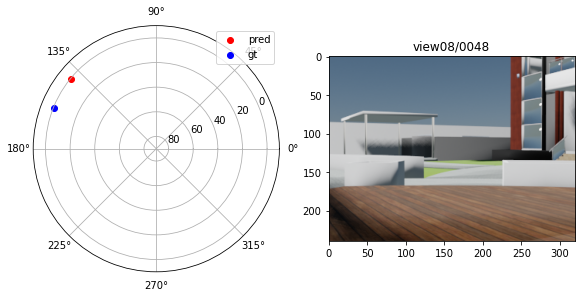

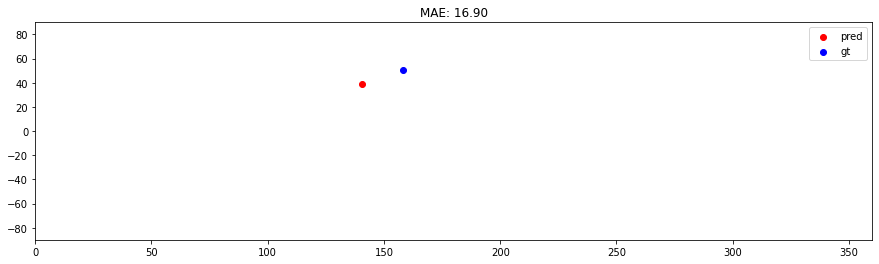

[149] angular error :  18.61155100575089
gt: 161.10, 51.36
pred: 140.62, 39.38


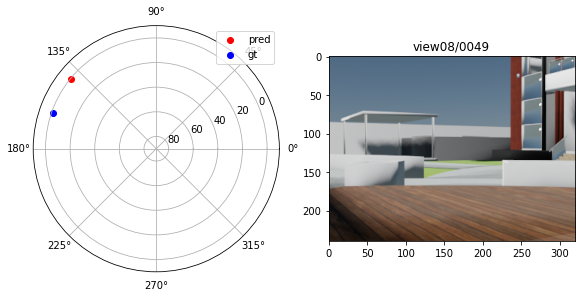

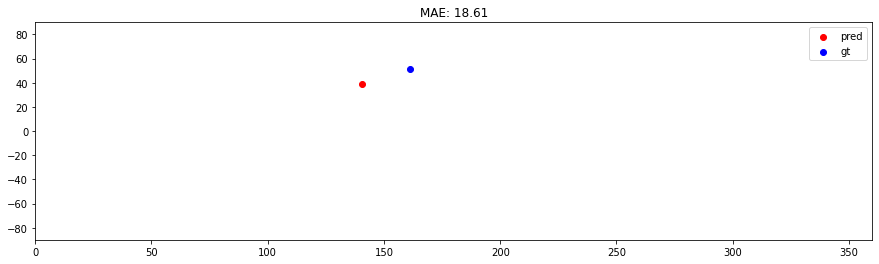

[150] angular error :  20.339062550995596
gt: 163.91, 51.79
pred: 140.62, 39.38


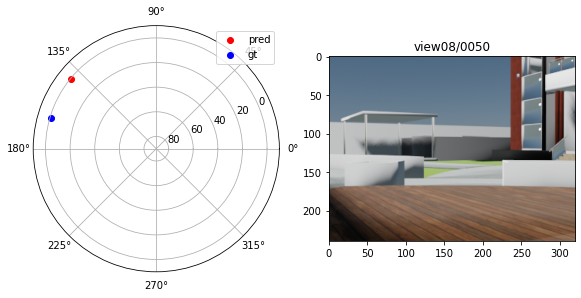

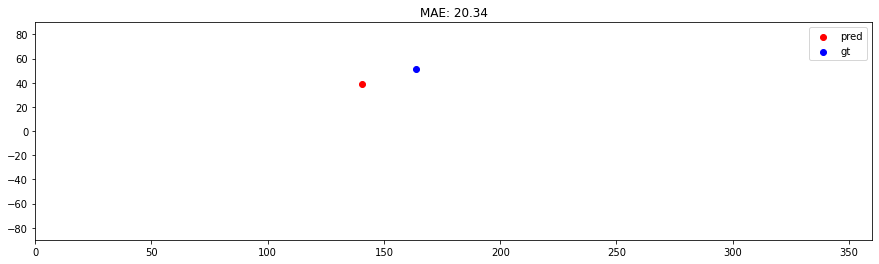

[151] angular error :  22.077669129165574
gt: 166.77, 52.16
pred: 140.62, 39.38


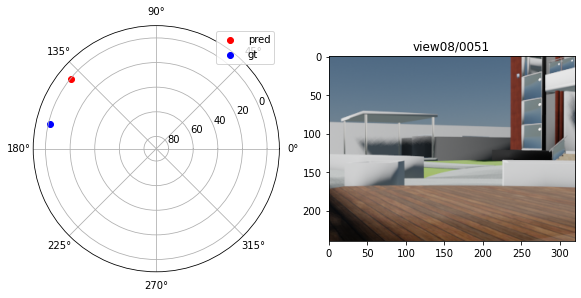

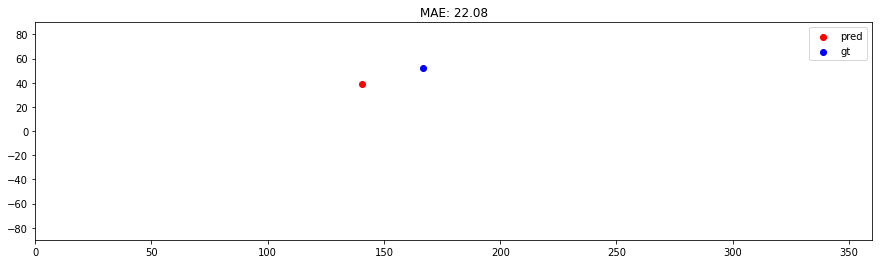

[152] angular error :  23.82493683803619
gt: 169.68, 52.45
pred: 140.62, 39.38


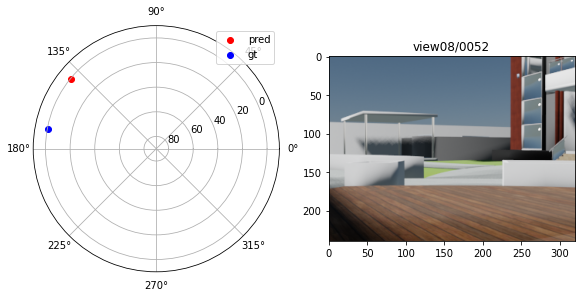

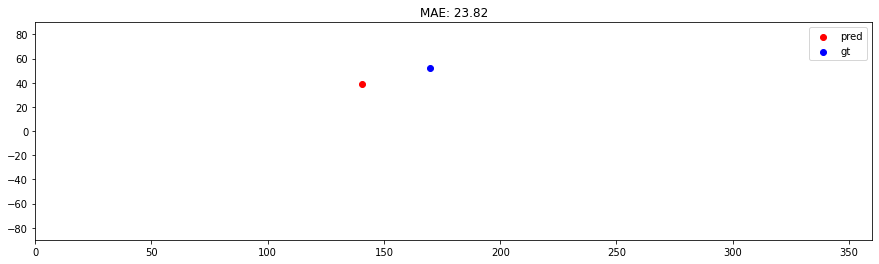

[153] angular error :  25.579088337033095
gt: 172.62, 52.68
pred: 140.62, 39.38


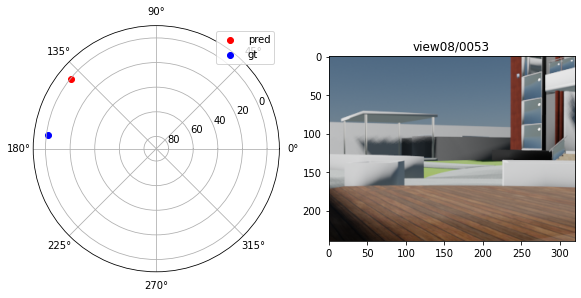

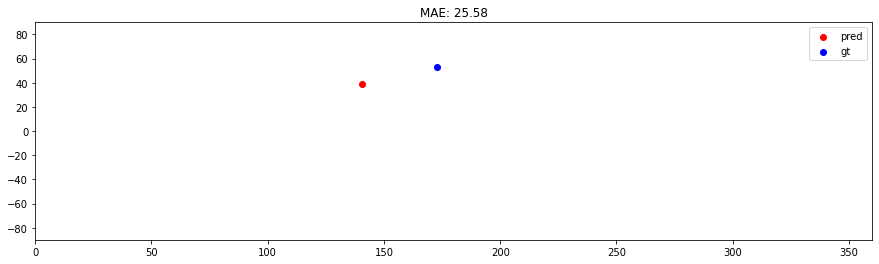

[154] angular error :  27.338793611303988
gt: 175.58, 52.83
pred: 140.62, 39.38


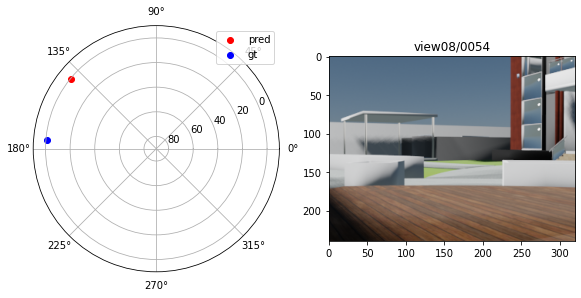

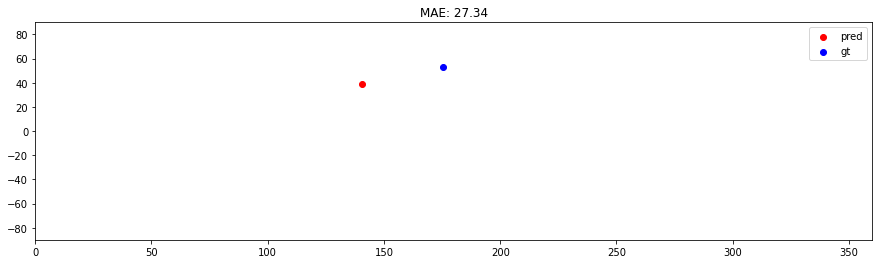

[155] angular error :  29.103041100146932
gt: 178.56, 52.90
pred: 140.62, 39.38


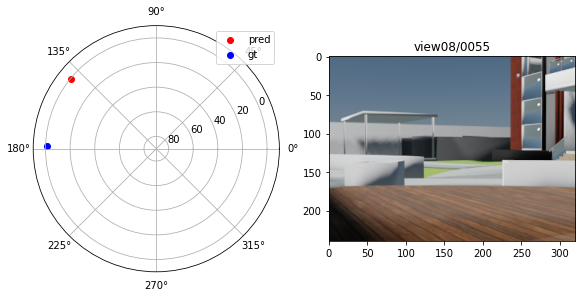

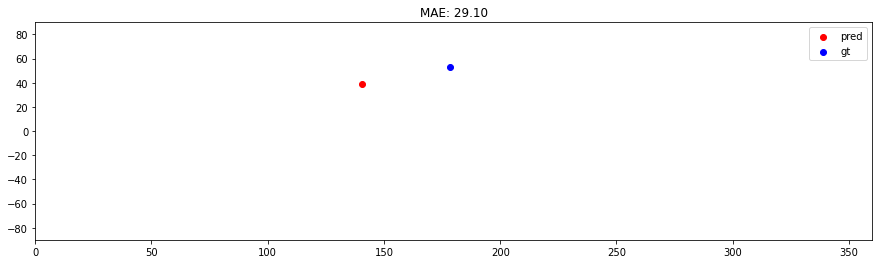

[156] angular error :  30.871047592729813
gt: 181.54, 52.90
pred: 140.62, 39.38


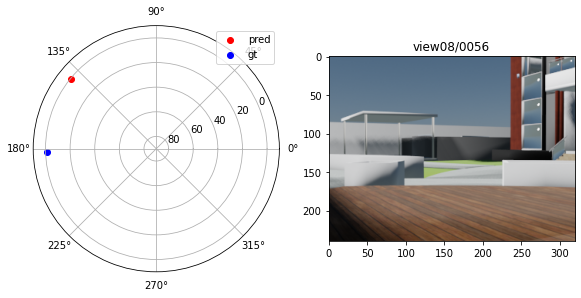

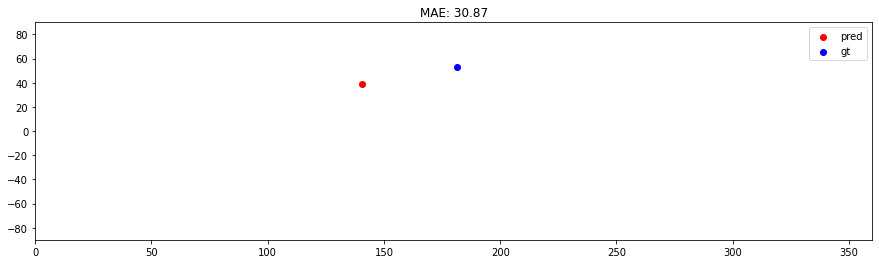

[157] angular error :  32.642196991794144
gt: 184.52, 52.83
pred: 140.62, 39.38


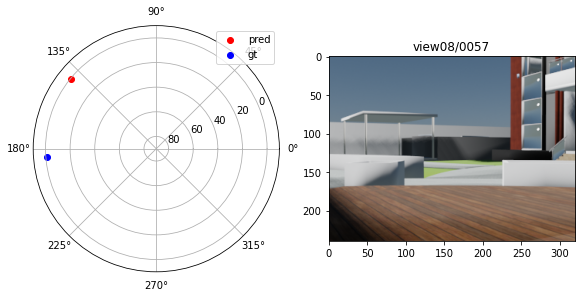

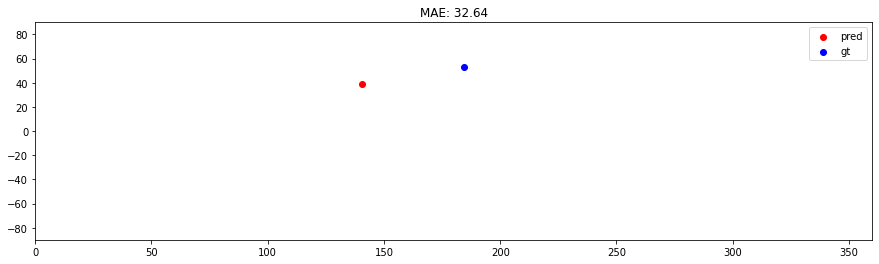

[158] angular error :  28.62988426239893
gt: 187.49, 52.68
pred: 140.62, 50.62


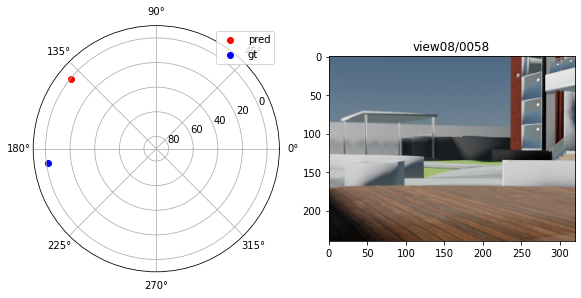

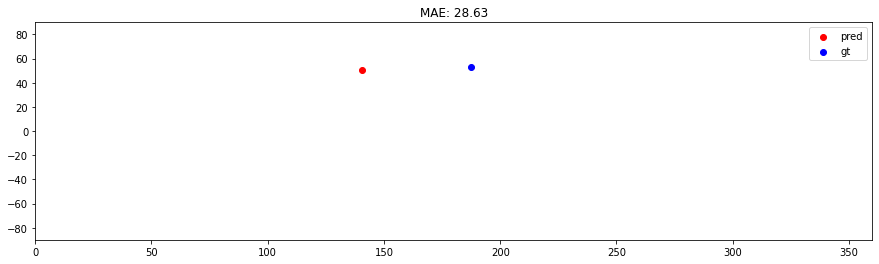

[159] angular error :  30.408554474617
gt: 190.43, 52.46
pred: 140.62, 50.62


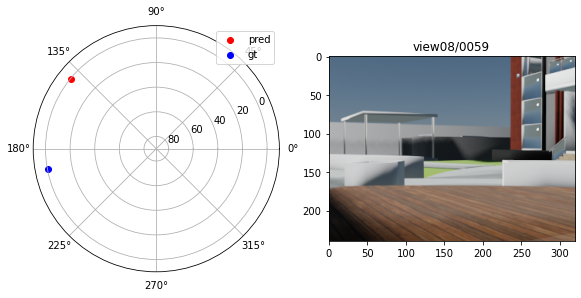

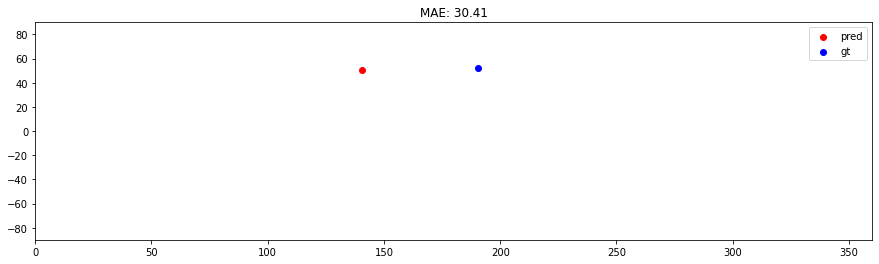

[160] angular error :  32.18937284521829
gt: 193.33, 52.17
pred: 140.62, 50.62


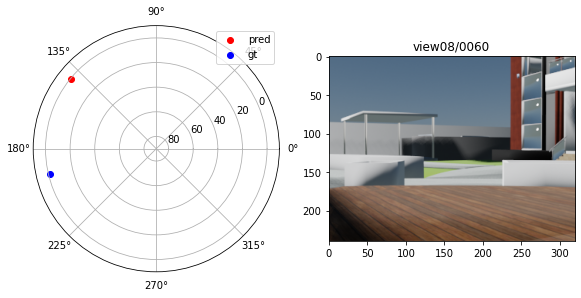

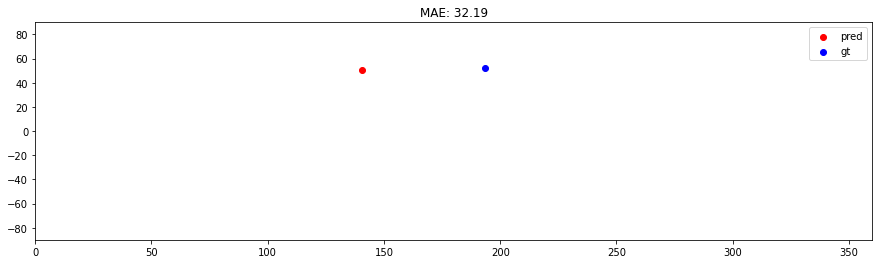

[161] angular error :  33.97199608783623
gt: 196.19, 51.80
pred: 140.62, 50.62


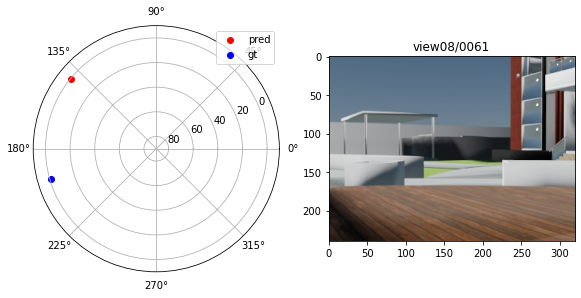

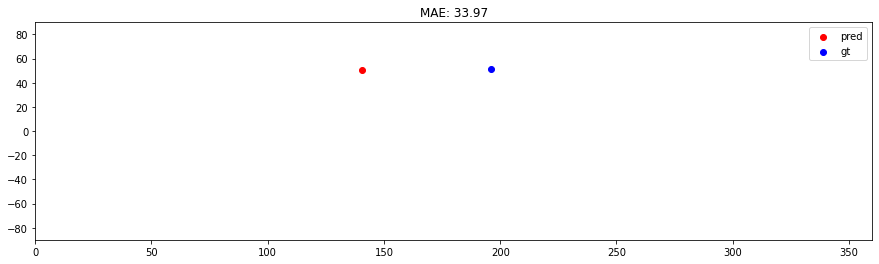

[162] angular error :  35.75615074462683
gt: 199.00, 51.37
pred: 140.62, 50.62


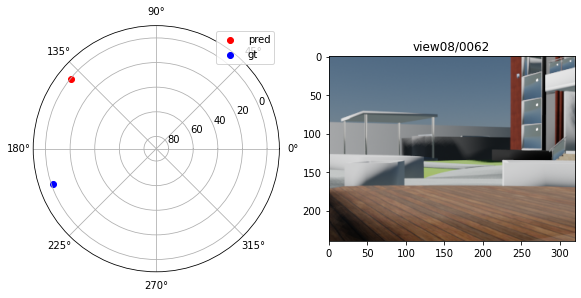

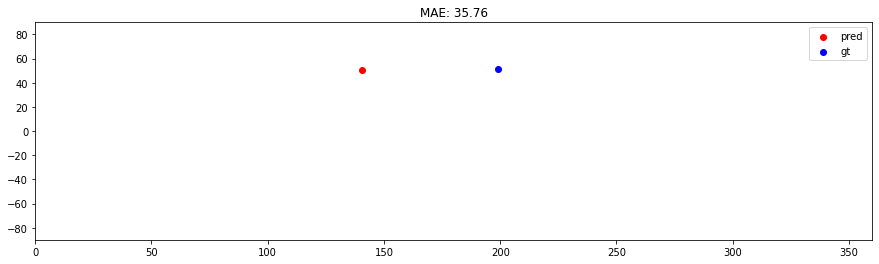

[163] angular error :  37.541612879391664
gt: 201.76, 50.87
pred: 140.62, 50.62


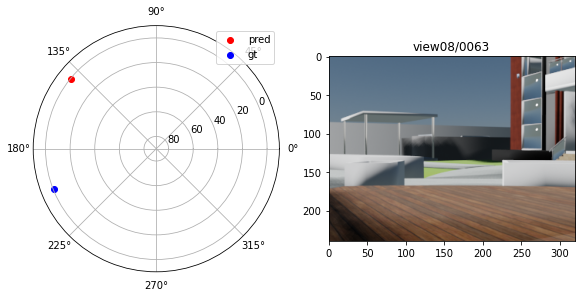

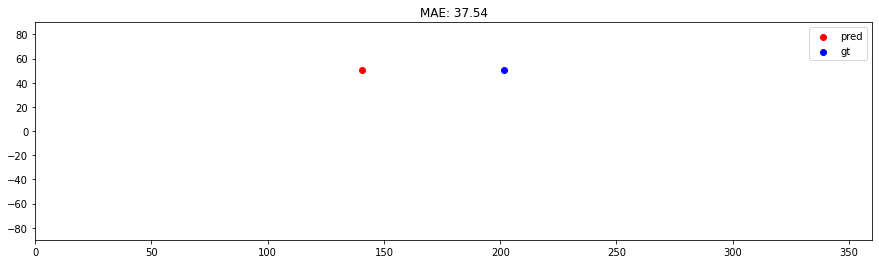

[164] angular error :  39.328198955768244
gt: 204.45, 50.31
pred: 140.62, 50.62


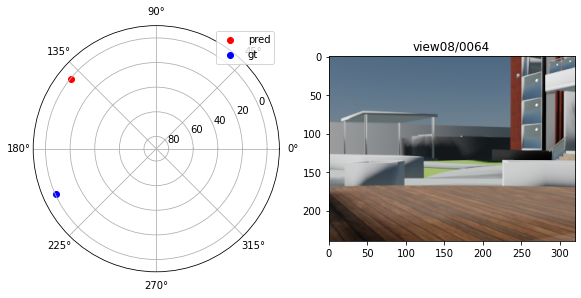

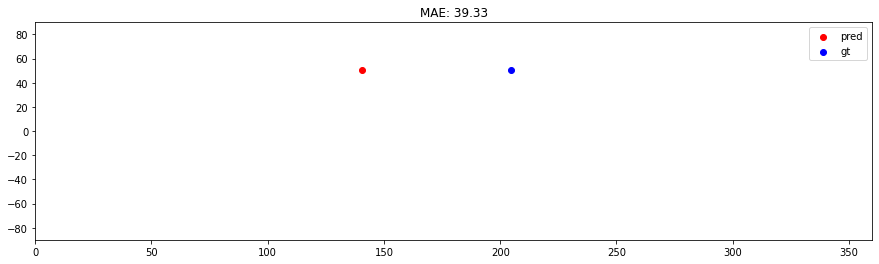

[165] angular error :  41.11575589594453
gt: 207.08, 49.68
pred: 140.62, 50.62


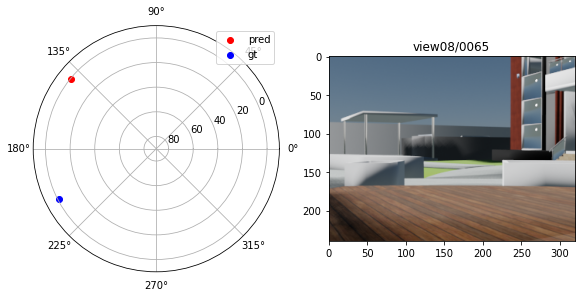

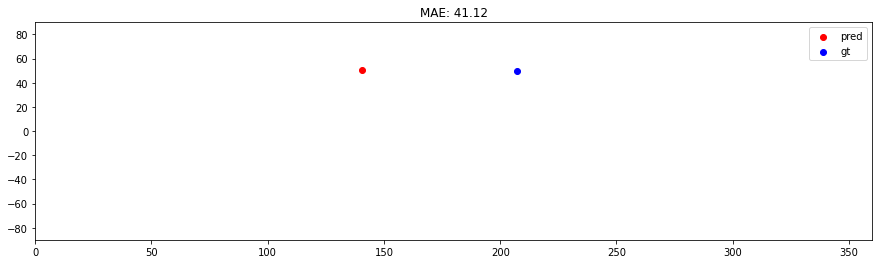

[166] angular error :  42.90415884659592
gt: 209.64, 49.00
pred: 140.62, 50.62


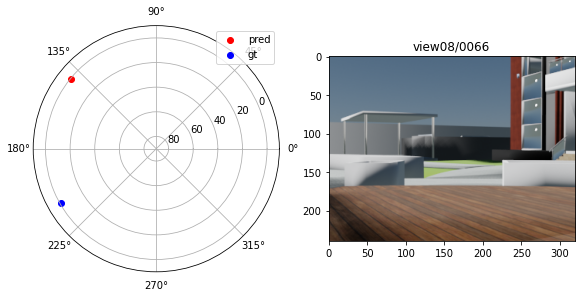

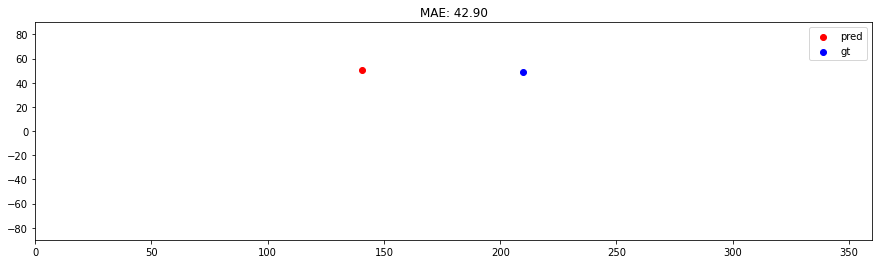

[167] angular error :  44.69329789809441
gt: 212.12, 48.27
pred: 140.62, 50.62


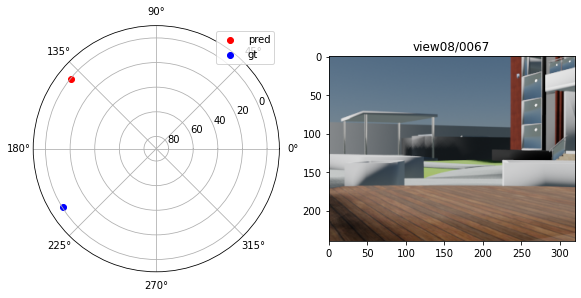

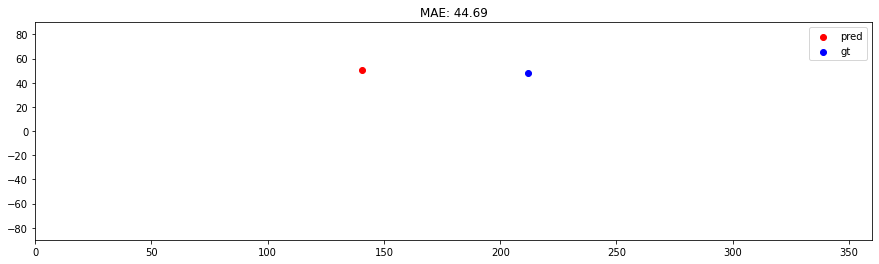

[168] angular error :  46.48308244251256
gt: 214.54, 47.48
pred: 140.62, 50.62


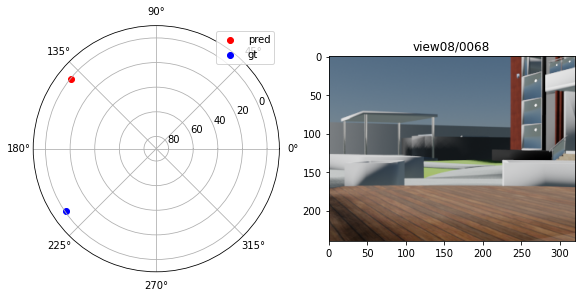

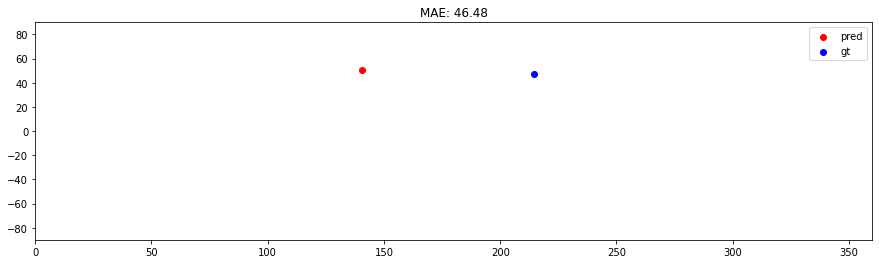

[169] angular error :  48.27343472883794
gt: 216.87, 46.64
pred: 140.62, 50.62


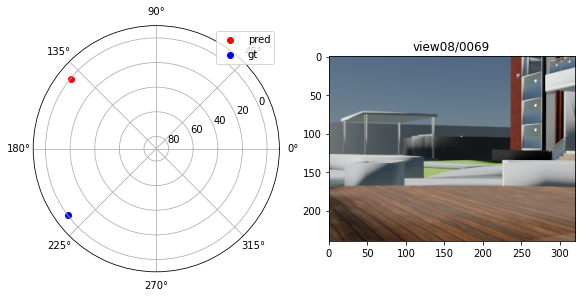

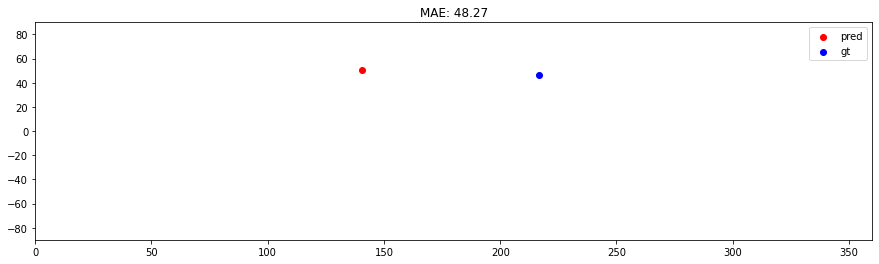

[170] angular error :  50.06428558743584
gt: 219.14, 45.76
pred: 140.62, 50.62


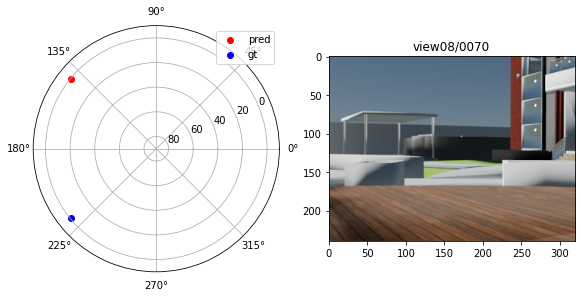

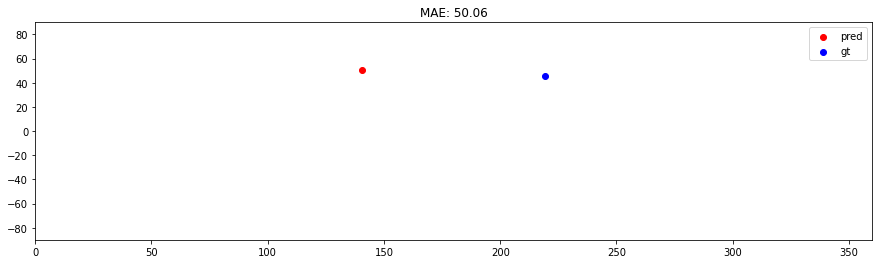

[171] angular error :  51.855575459425715
gt: 221.33, 44.83
pred: 140.62, 50.62


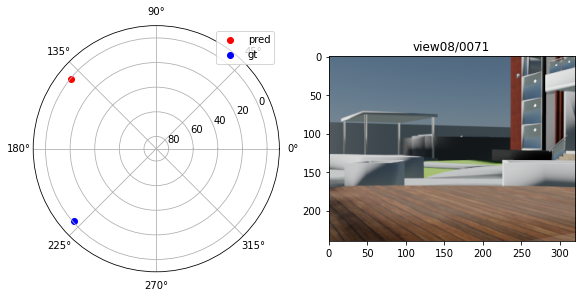

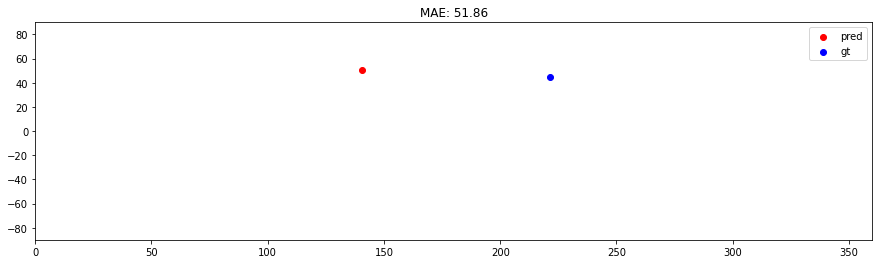

[172] angular error :  53.64725376872066
gt: 223.46, 43.87
pred: 140.62, 50.62


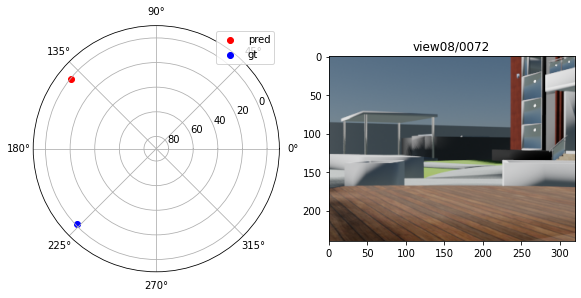

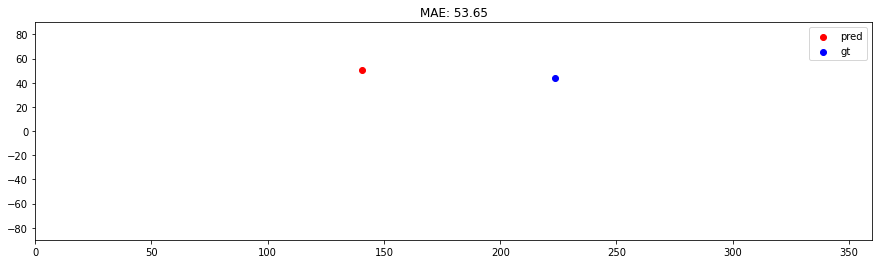

[173] angular error :  55.439271927645386
gt: 225.51, 42.86
pred: 140.62, 50.62


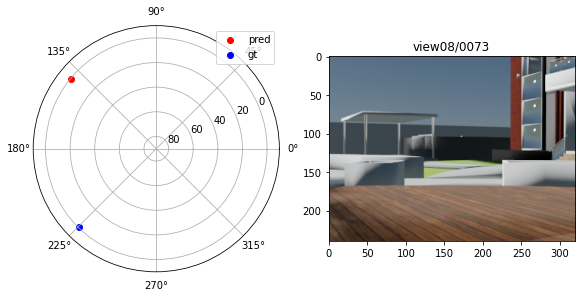

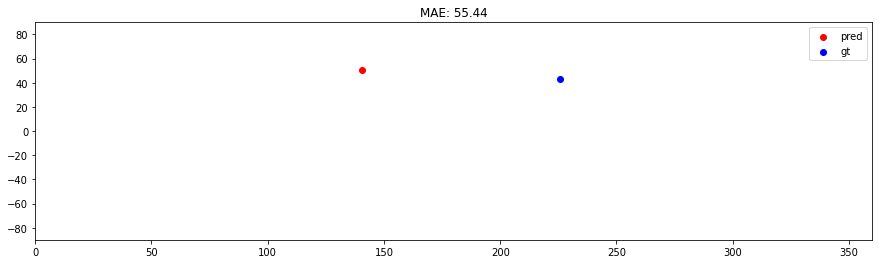

[174] angular error :  57.23159226525132
gt: 227.50, 41.82
pred: 140.62, 50.62


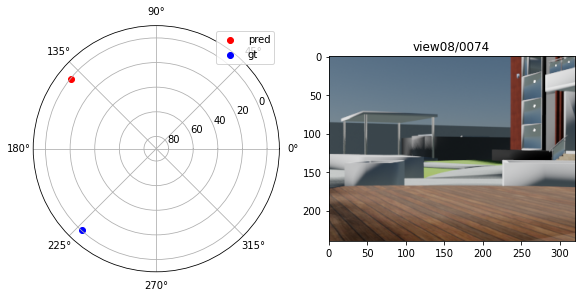

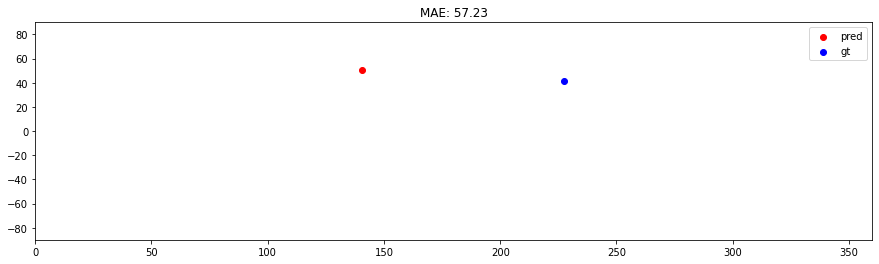

[175] angular error :  59.024173537564124
gt: 229.42, 40.75
pred: 140.62, 50.62


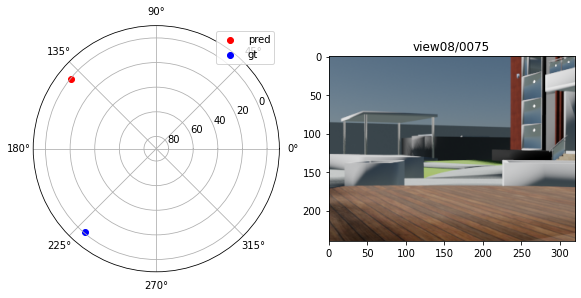

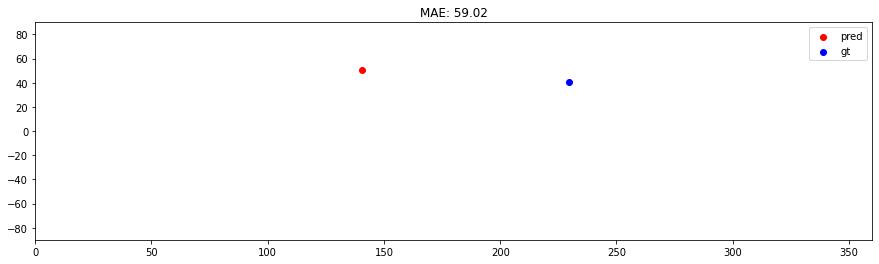

[176] angular error :  60.81698514066702
gt: 231.28, 39.64
pred: 140.62, 50.62


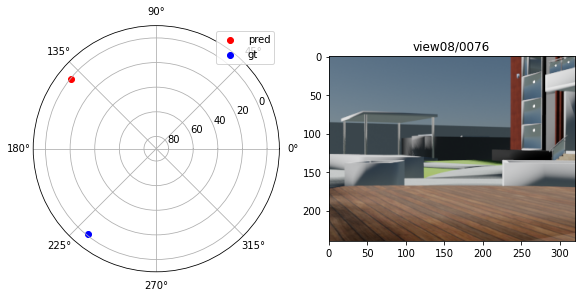

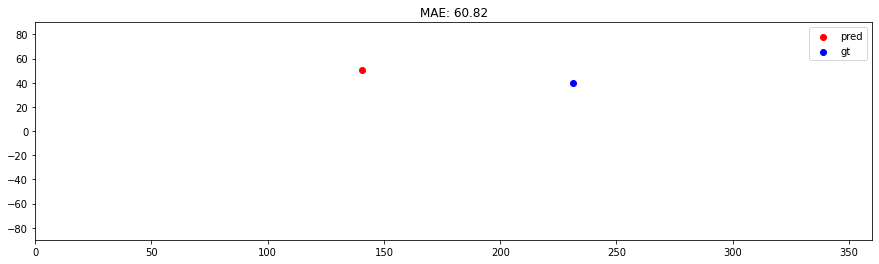

[177] angular error :  56.13674513262779
gt: 233.08, 38.51
pred: 151.88, 50.62


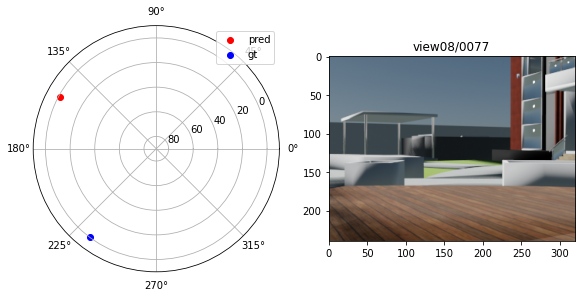

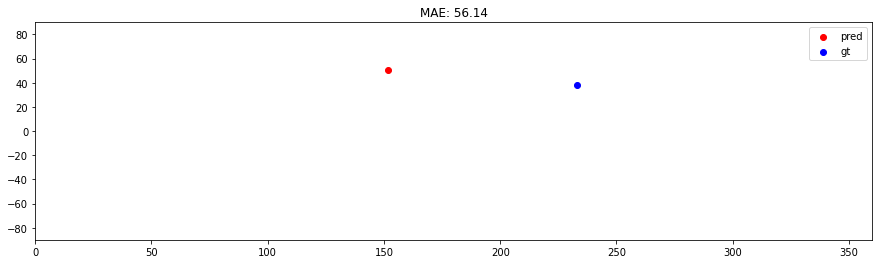

[178] angular error :  57.935756719728886
gt: 234.82, 37.35
pred: 151.88, 50.62


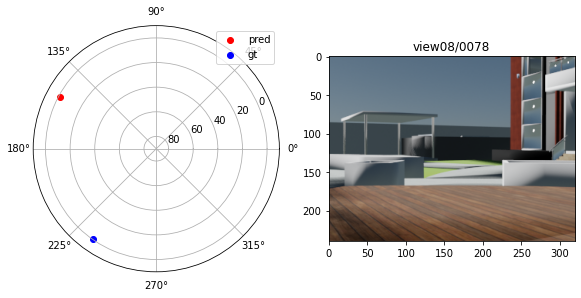

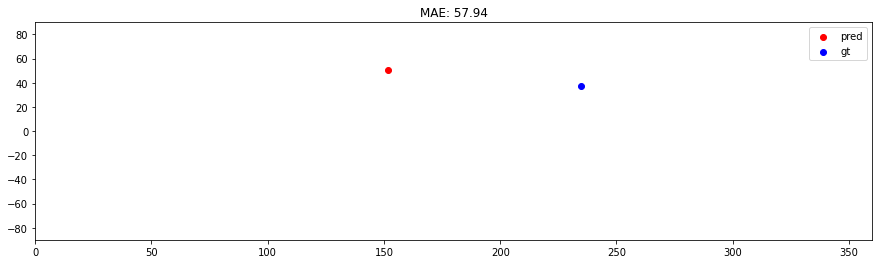

[179] angular error :  59.73474169662854
gt: 236.51, 36.16
pred: 151.88, 50.62


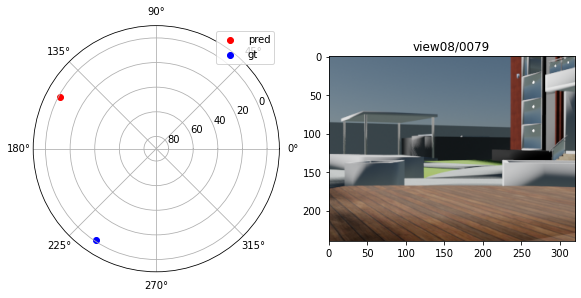

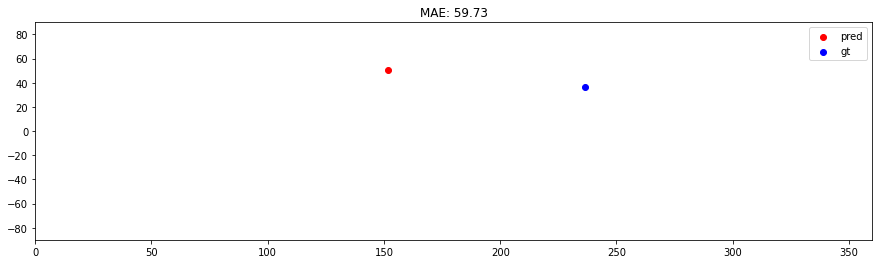

[180] angular error :  61.53369091907173
gt: 238.15, 34.95
pred: 151.88, 50.62


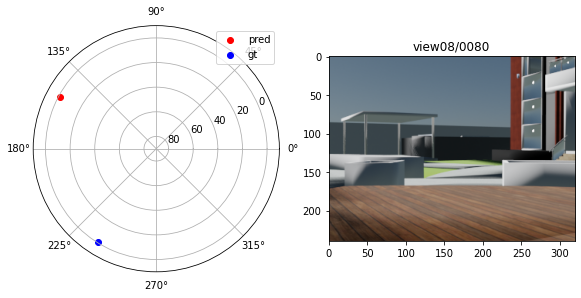

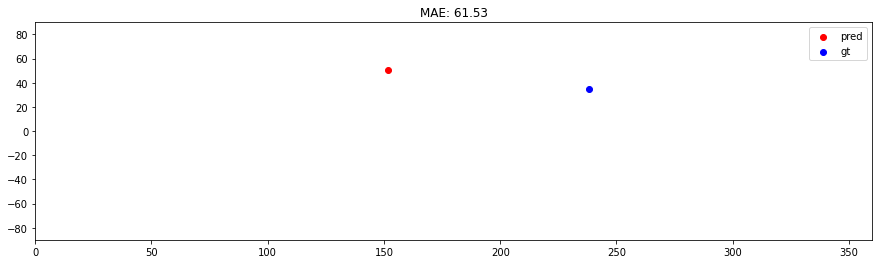

[181] angular error :  63.332598218572244
gt: 239.74, 33.73
pred: 151.88, 50.62


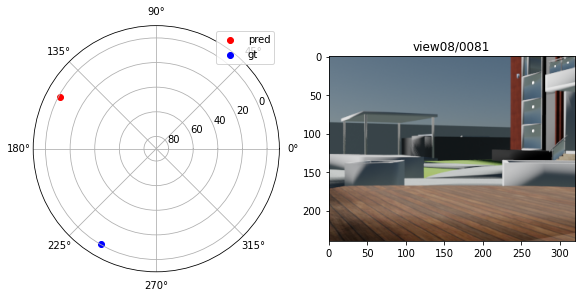

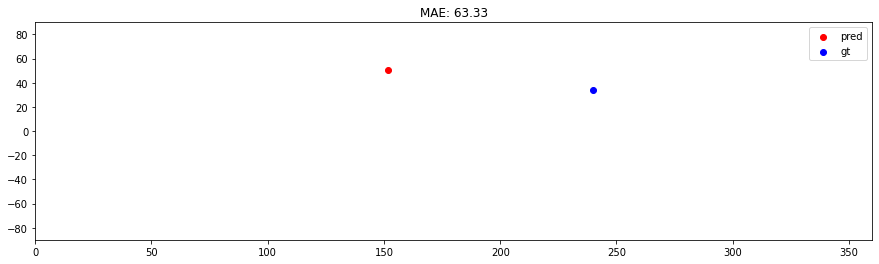

[182] angular error :  65.13145122763908
gt: 241.29, 32.48
pred: 151.88, 50.62


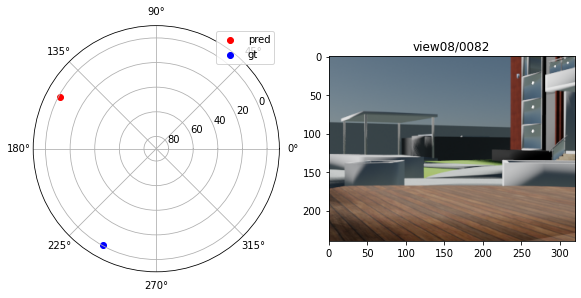

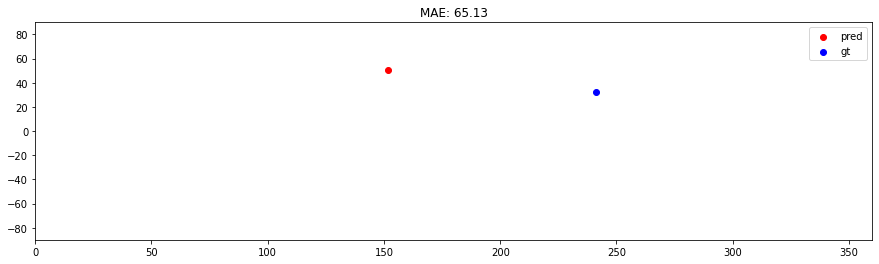

[183] angular error :  66.93024085292784
gt: 242.79, 31.21
pred: 151.88, 50.62


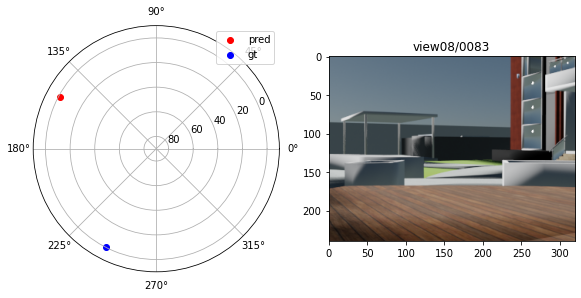

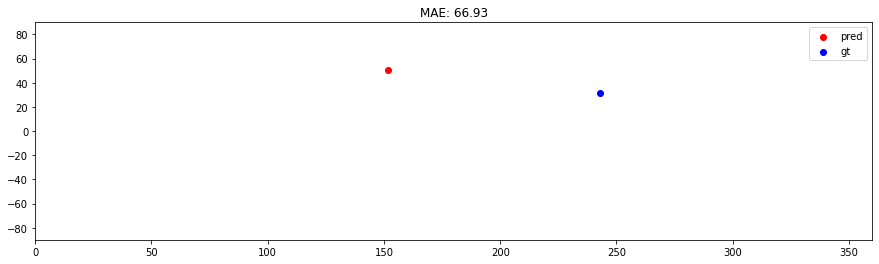

[184] angular error :  2.752201235848351
gt: 244.26, 29.92
pred: 241.88, 28.12


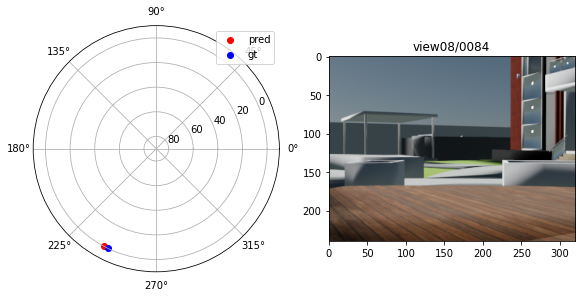

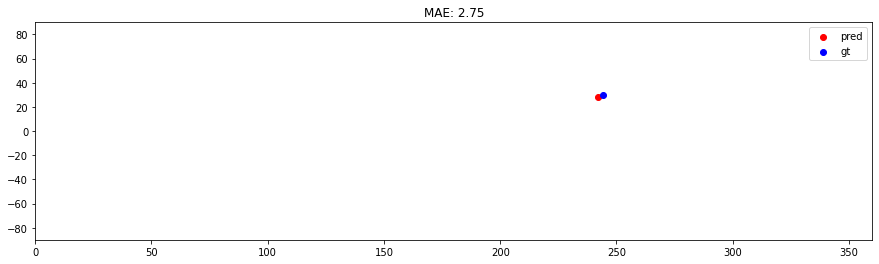

[185] angular error :  3.386792986049888
gt: 245.68, 28.62
pred: 241.88, 28.12


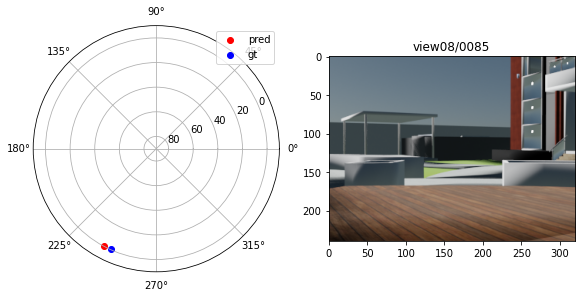

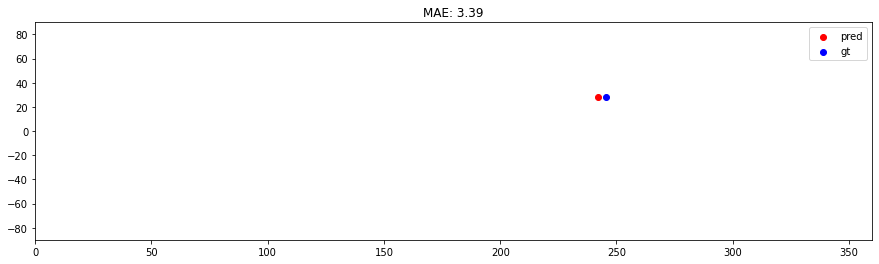

[186] angular error :  4.672666058810042
gt: 247.07, 27.31
pred: 241.88, 28.12


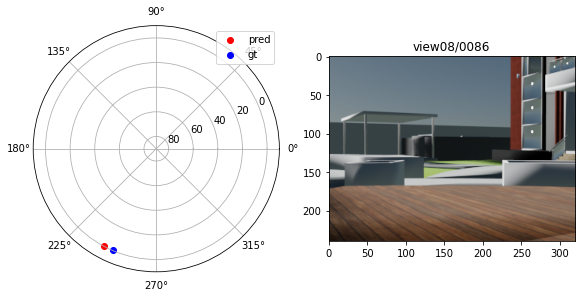

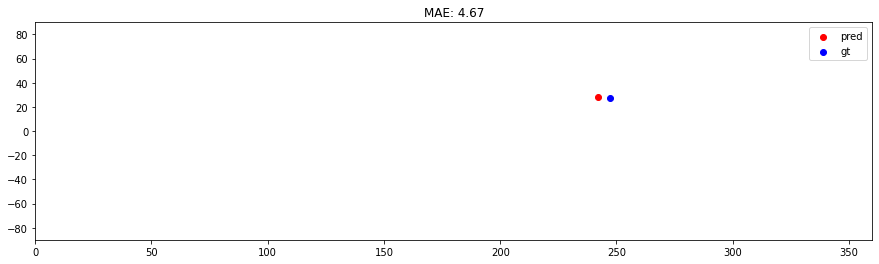

[187] angular error :  6.2180008811529595
gt: 248.43, 25.98
pred: 241.88, 28.12


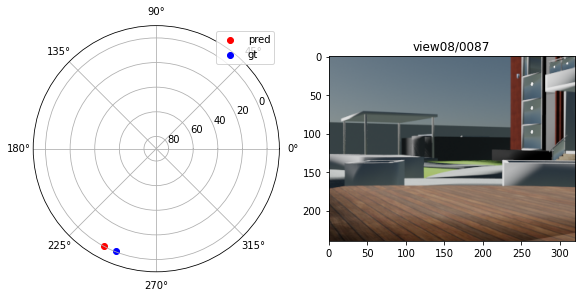

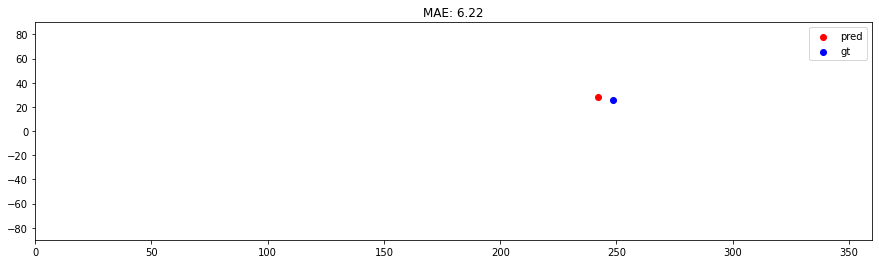

[188] angular error :  7.871332825068691
gt: 249.76, 24.64
pred: 241.88, 28.12


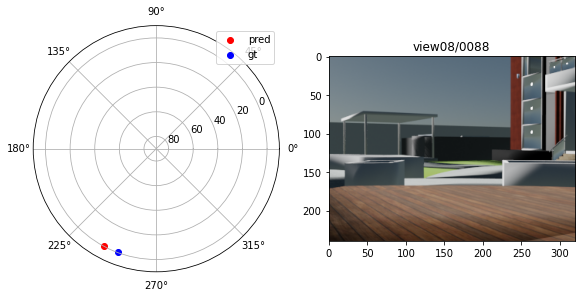

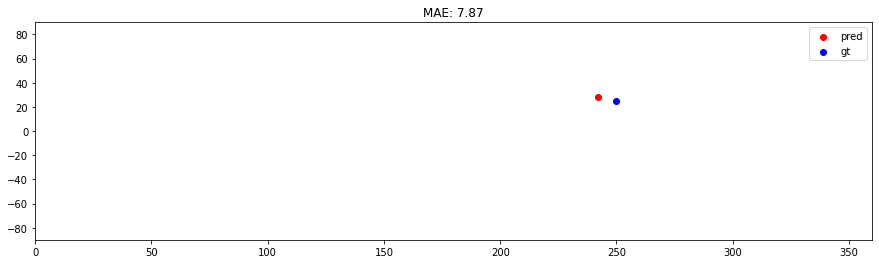

[189] angular error :  9.57678296783716
gt: 251.06, 23.29
pred: 241.88, 28.12


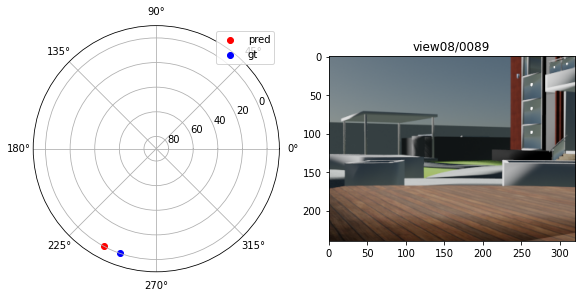

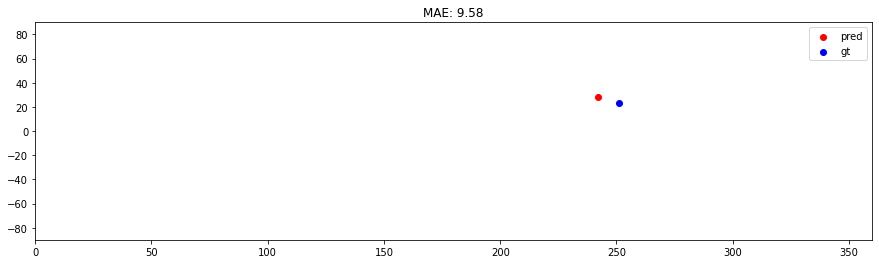

[190] angular error :  11.310684352172423
gt: 252.33, 21.93
pred: 241.88, 28.12


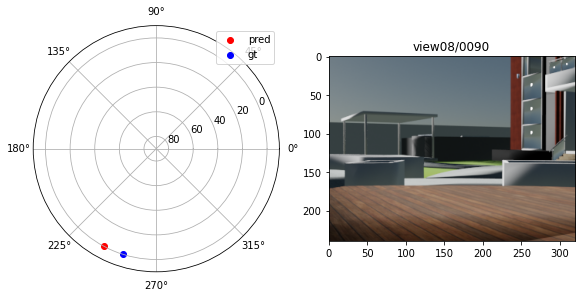

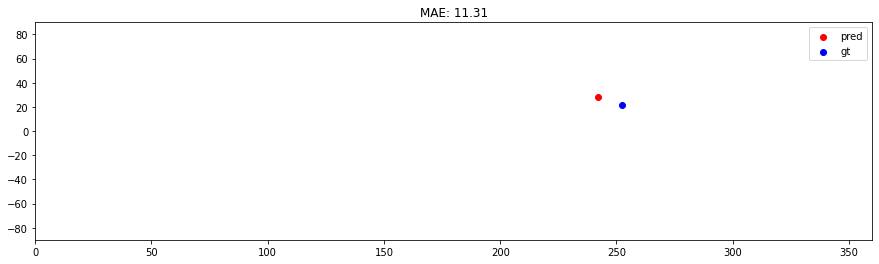

[191] angular error :  13.061586518309424
gt: 253.58, 20.56
pred: 241.88, 28.12


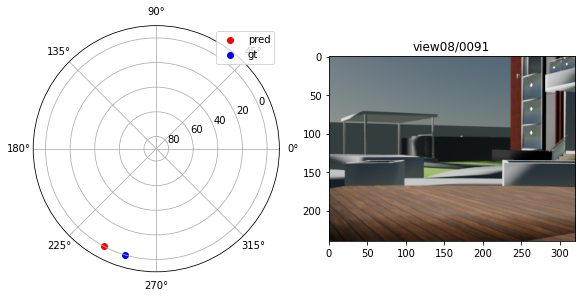

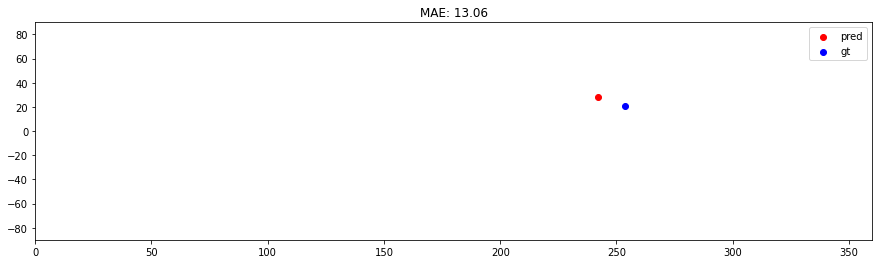

[192] angular error :  9.074702529727839
gt: 254.81, 19.18
pred: 253.12, 28.12


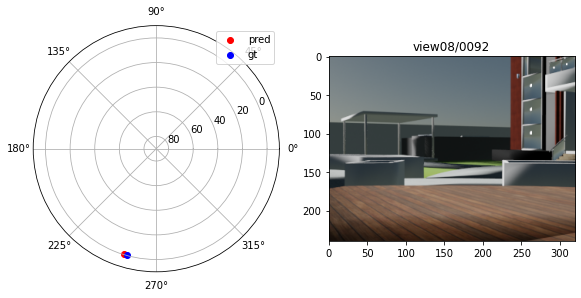

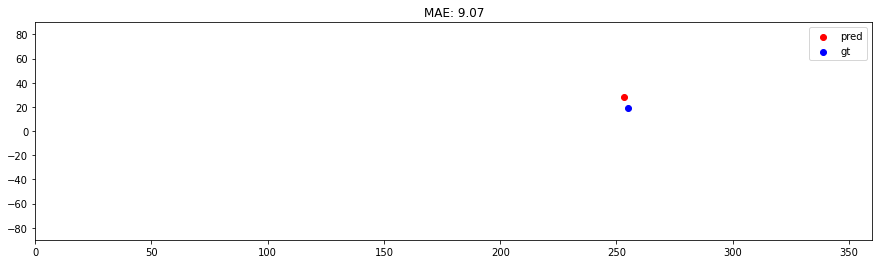

[193] angular error :  10.665077421420792
gt: 256.01, 17.79
pred: 253.12, 28.12


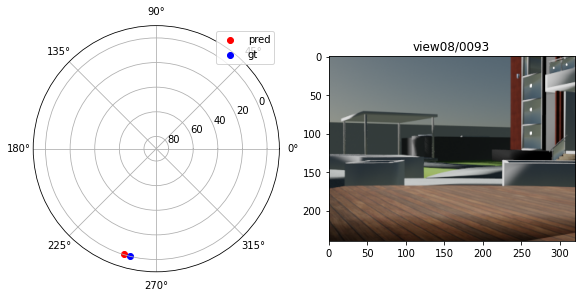

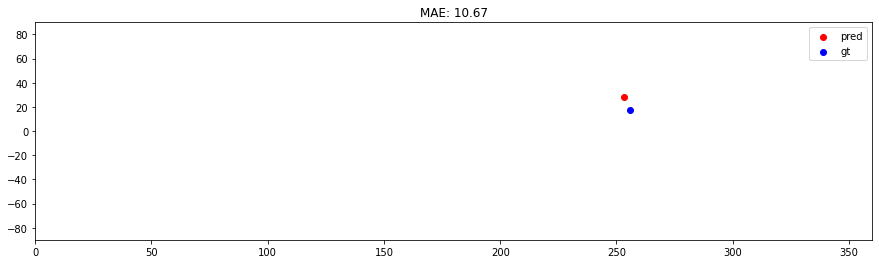

[194] angular error :  12.311344712376926
gt: 257.20, 16.40
pred: 253.12, 28.12


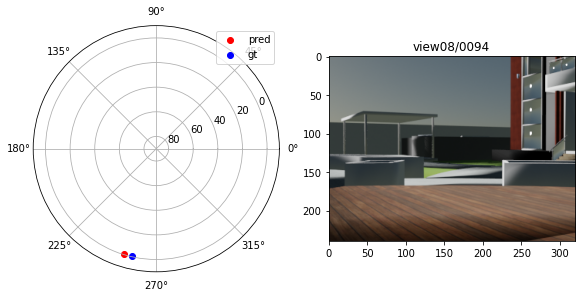

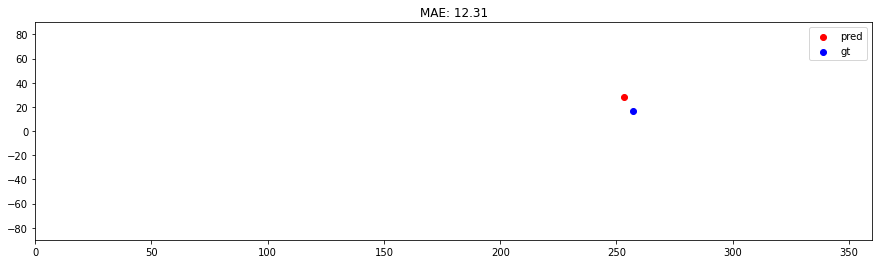

[195] angular error :  5.378489525432714
gt: 258.37, 15.00
pred: 253.12, 16.88


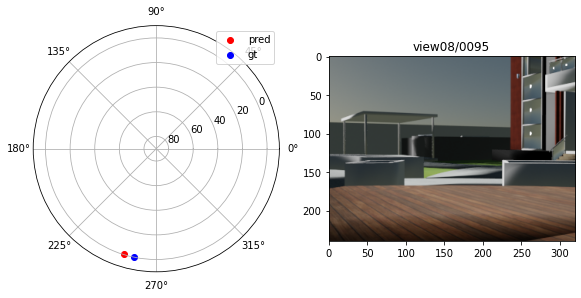

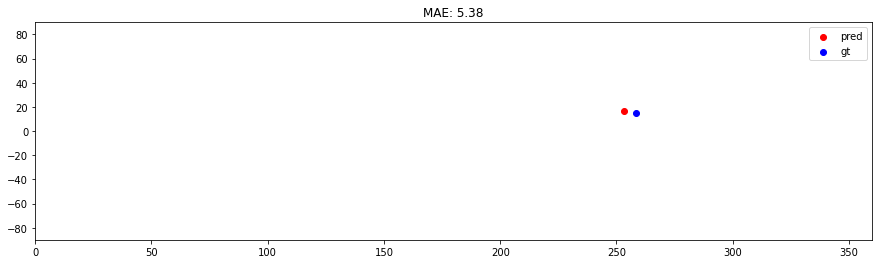

[196] angular error :  6.988387350225609
gt: 259.52, 13.60
pred: 253.12, 16.88


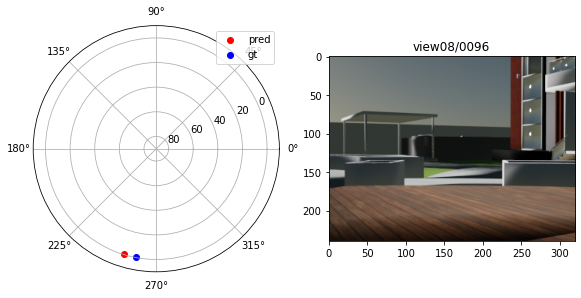

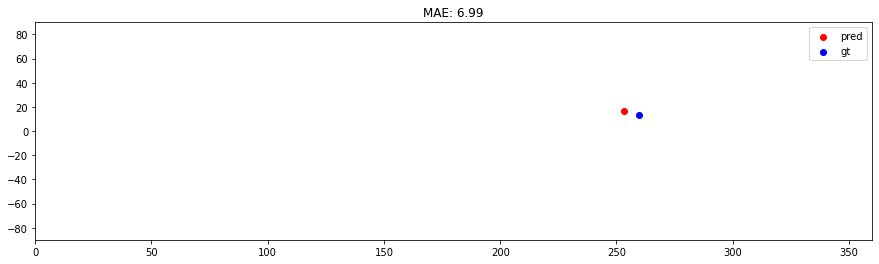

[197] angular error :  8.670373547387003
gt: 260.67, 12.19
pred: 253.12, 16.88


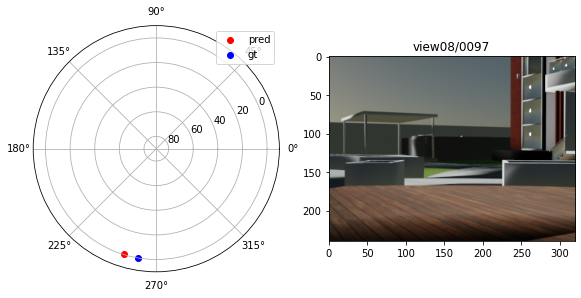

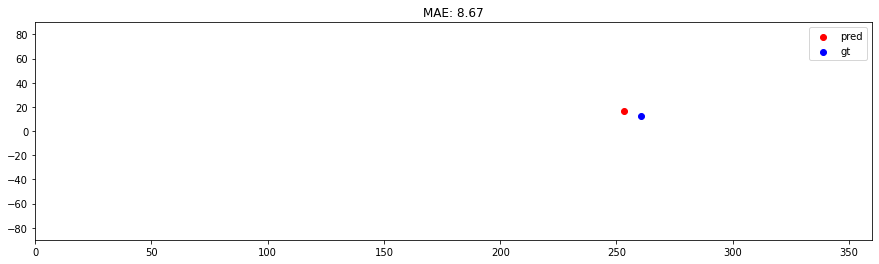

[198] angular error :  10.38865340024882
gt: 261.80, 10.78
pred: 253.12, 16.88


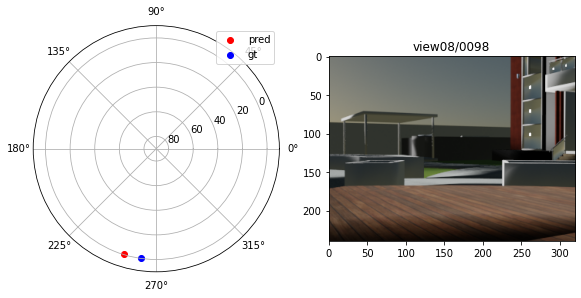

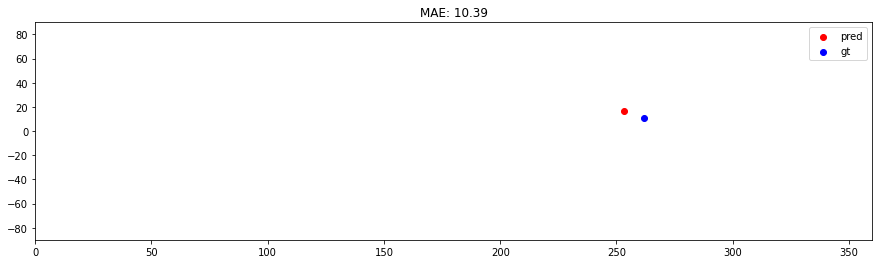

[199] angular error :  12.12670860415996
gt: 262.91, 9.37
pred: 253.12, 16.88


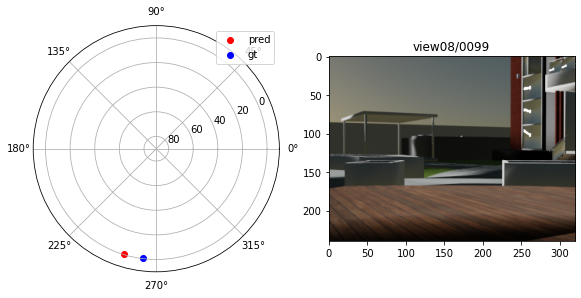

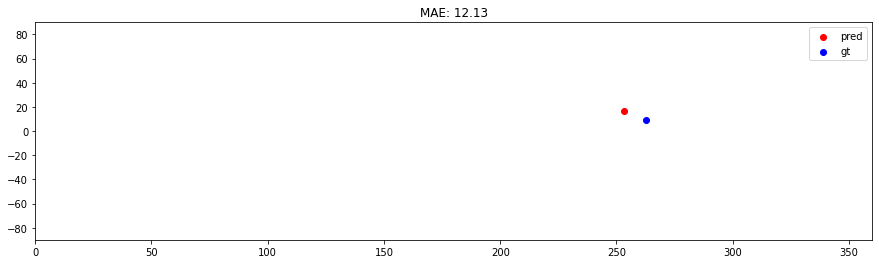

In [33]:
mae_errlist = []
azimuth_errlist = []
elevation_errlist = []

for i in range(200):
    print("[%d]" %i, end=' ')
    print("angular error : ",angular[i])
    print("gt: %.2f, %.2f" % ( df_dg[ ' azimuth'][i], df_dg[' elevation'][i]))
    
    if sun_df[0][i]*180/math.pi < 0:
        print("pred: %.2f, %.2f" %(sun_df[0][i]*180/math.pi+360, sun_df[1][i]*180/math.pi))
        azimuth_errlist.append(sun_df[0][i]*180/math.pi+360 - df_dg[ ' azimuth'][i])
        elevation_errlist.append(sun_df[1][i]*180/math.pi - df_dg[ ' elevation'][i])
    else:
        print("pred: %.2f, %.2f" %(sun_df[0][i]*180/math.pi, sun_df[1][i]*180/math.pi))
        azimuth_errlist.append(sun_df[0][i]*180/math.pi - df_dg[ ' azimuth'][i])
        elevation_errlist.append(sun_df[1][i]*180/math.pi - df_dg[ ' elevation'][i])
    mae_errlist.append(angular[i])
    
    fig = plt.figure(figsize=(15,6))
    rows = 1; cols = 3
    
    ax1 = fig.add_subplot(rows, cols, 1 ,polar=True)
    ax1.set_rlim(bottom=90, top=-10)
#    ax1.set_yticks(np.arange(0,1,0.2))
    
    ax1.scatter(sun_df[0][i], sun_df[1][i],lw=1, color='r', label='pred')
    ax1.scatter(df_ra[ ' azimuth'][i], df_ra[' elevation'][i],lw=1, color='b', label='gt')
    ax1.legend()
    
    ax2 = fig.add_subplot(rows, cols, 2)
    path = df_gt['file_name'][i]
    ax2.set_title(df_gt['file_name'][i][10:-4])
    image = img.imread(path)
    ax2.grid(False)
    ax2.imshow(image)
    
    #fig.tight_layout()
    plt.show()
    
    plt.figure(figsize=(15,4))
    plt.title('MAE: %.2f'%angular[i])
    plt.xlim(0,360)
    plt.ylim(-90,90)
    if sun_df[0][i]*180/math.pi < 0:
        plt.scatter(sun_df[0][i]*180/math.pi+360, sun_df[1][i]*180/math.pi, color='r', label='pred')
    else:
        plt.scatter(sun_df[0][i]*180/math.pi, sun_df[1][i]*180/math.pi, color='r', label='pred')
    plt.scatter(df_dg[ ' azimuth'][i], df_dg[' elevation'][i], color='b', label='gt')
    plt.legend()
    plt.show()

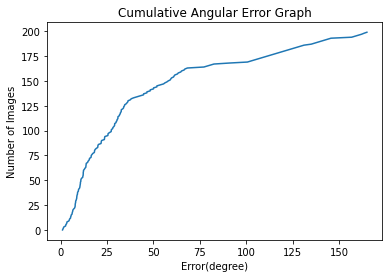

In [37]:
mae_errlist.sort()
plt.title('Cumulative Angular Error Graph')
plt.xlabel('Error(degree)')
plt.ylabel('Number of Images')
plt.plot(mae_errlist, [i for i in range(0,200)])

<BarContainer object of 200 artists>

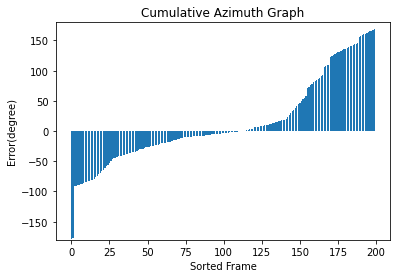

In [35]:
azimuth_errlist.sort()
plt.title('Cumulative Azimuth Graph')
plt.ylabel('Error(degree)')
plt.xlabel('Sorted Frame')
plt.ylim(-180,180)
plt.bar([i for i in range(0,200)],azimuth_errlist)

<BarContainer object of 200 artists>

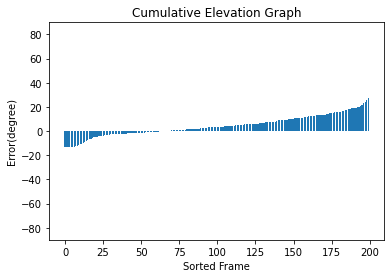

In [36]:
elevation_errlist
elevation_errlist.sort()
plt.title('Cumulative Elevation Graph')
plt.ylabel('Error(degree)')
plt.xlabel('Sorted Frame')
plt.ylim(-90,90)
plt.bar([i for i in range(0,200)],elevation_errlist)